# Info
Purpose:

    Analyse initial dataset from the radiometer sun measurements from Conrad of muSSTAR

Input:

    none

Output:

    Figures 

Keywords:

    none

Dependencies:

    - load_utils.py
    - matplotlib
    - numpy
    - Sp_parameters
    - write_utils
    - path_utils
    - hdf5storage
    - scipy

Needed Files:
  - file.rc : for consistent creation of look of matplotlib figures
  - ...

Modification History:

    Written: Samuel LeBlanc, Santa Cruz, CA, 2020-10-28
    Modified: Samuel LeBlanc, Santa Cruz, CA, 2021-01-15
              Added new test for dark drift.


# Notes

From Conrad Esch, Oct 16, 2020, 5:01 PM:
Hi All,

I got 5STAR going today and managed to grab some data. The data is included in the text file. The text file is quite large so I'm open to alternative data storage methods or loop speeds.

The 0 to -10v signals were referenced to -5v so consider ~5 volts to be 0 and ~-5v to be -10v.

I ran the capture loop at 10 hz and it was started at 3:39 pm.

The instrument was manually placed so that it was looking directly at the sun and then was left alone as the sun's position changed. Also included is a photo.

Best,

Conrad Esch
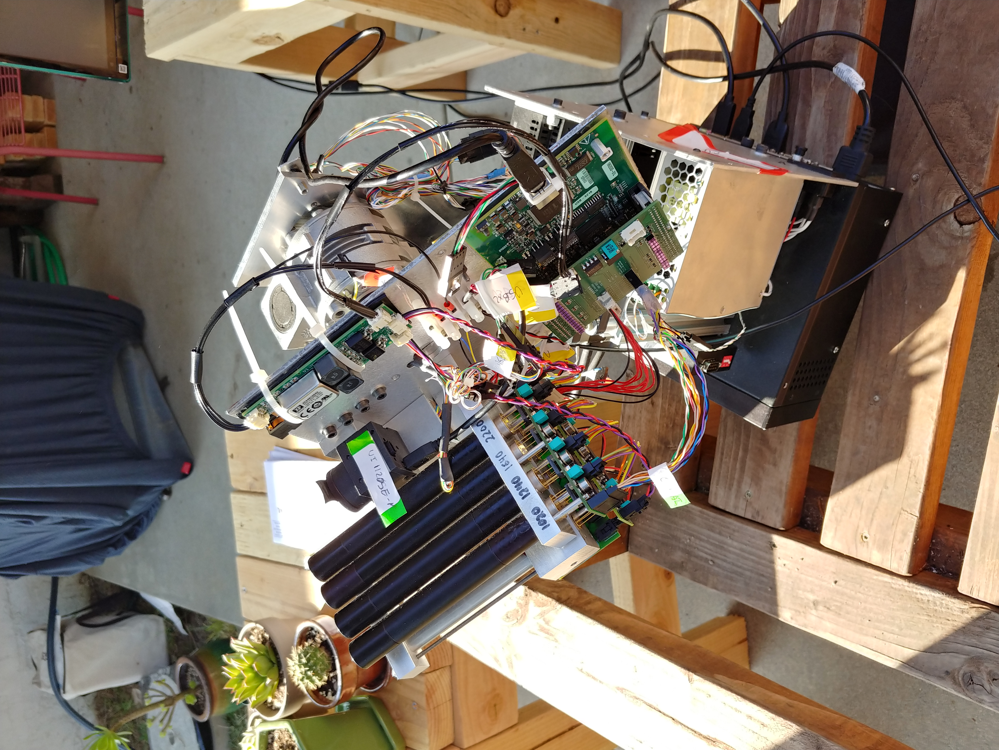


Conrad,  can you tell me what the labels represent?  I see:

CH1_0, CH1_2, CH1_4: (Are these the same detector but with different gains and/or dynamic range?)

CH2_0, CH2_2, CH2_4,

CH3_0, CH3_2, CH3_4,

CH4_0, CH4_2, CH4_4,

CH5_0, CH5_2, CH5_4,

-5v_0_66:  (This signal has a mean value of -1.673 with standard deviation 0.0197 ~= 0.002.)

CH6_0, CH6_2, CH6_4,

CH7_0, CH7_2, CH7_4,

CH8_0, CH8_2, CH8_4,

CH9_0, CH9_2, CH9_4,

Spare,

5vRef_Temp  (mean value of 0.554, standard deviation 0.0197)

12POS_0_33 (mean value 0f 3.9382, standard deviation of 0.100)

12NEG_0_33 (mean value -3.9281, standard dev 0.143)

 

So, I'd guess that these are sequences of the same detector (CHx_0, CHx_2, CHx_4) recorded with different gains and ranges?  Do you have a mapping of the channel number to wavelength?  And -5v_0_66, 5vRef_Temp, 12POS_0_33 and 12NEG_0_33 are reference voltages?

 

Was the 5STAR supposedly tracking the sun most of the time?  Some of these traces appear to track with each other and others not so well. 

 

Do we have any blocked, shuttered, or dark measurements?

 

Here is a quick plot of all 32 signals (including references) after removing the minimum value as a baseline.   Time is on the horizontal.

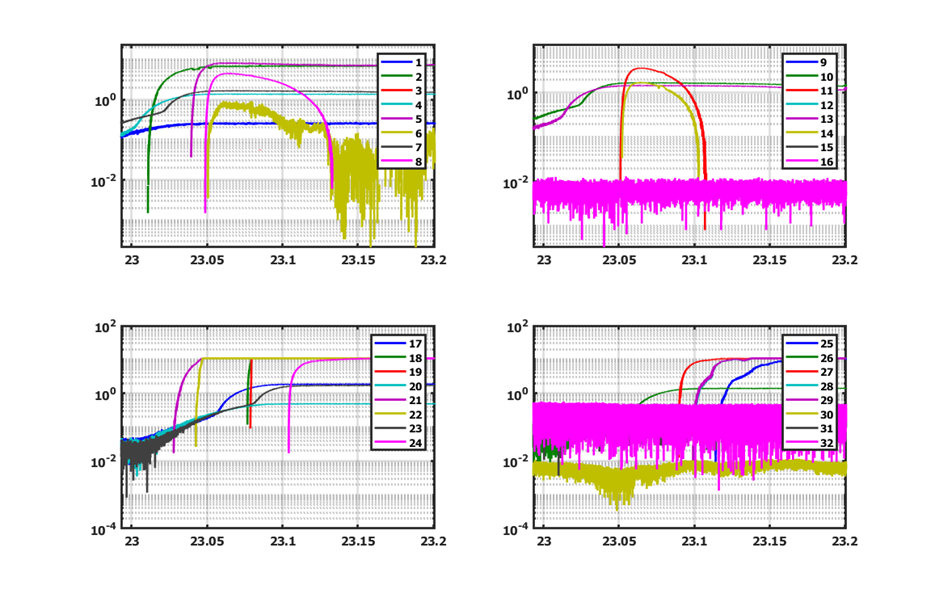

From Conrad Esch, 
Oct 20, 2020, 12:57 PM

Hi Connor,

Sorry for confusing labelling, yes the ones you grouped together are the same channels but with different gains. 

CHX_Y is Channel Number X times 10^Y. So for example CH1_0 is Channel1x1 and CH1_4 is Channel1x100x100. I'll write out what I believe is the correct wavelengths and channel descriptions below.

Radiometer Channels - Visible Bank
 - CH1_Y - 340-2 Channel
 - CH2_Y - 440-10 Channel
 - CH3_Y - 675-10 Channel
 - CH4_Y - 870-10 Channel
 - CH5_Y - 1020 Channel

Radiometer Channels - NIR Bank
 - CH6_Y - 1020 Channel
 - CH7_Y - 1240 Channel
 - CH8_Y - 1640 Channel
 - CH9_Y - 2200 Channel

Housekeeping Channels
 - Spare - Should be floating and unused but the signal appears similar to some of the other channels so it needs to be investigated.
 - -5v_0_66 - Should actually be -5v_0_33, it is 1/3 of our -5v reference signal, the channel name was supposed to represent -5v*0.333
 - 5vRef_Temp - Attached to  a temperature output from 5v precision reference, conversion is 2.1mV/Degree Celsius, datasheet says typical value is 630mV
 - 12POS_0_33 - 1/3 of +12V rail
 - 12NEG_0_33 - 1/3 of -12v rail

In this data set the Radiometer channels were all referenced to -5v to try to provide a higher bit resolution. Normally the channel outputs would range from 0v to -10v where 0v is dark and -10v is light. With the reference to -5v, a signal of 5v is dark and -5v is light. I haven't tuned the -5v reference yet so it is more like -5.019v.

In terms of linearity there is an issue I'm trying to track down with the third gain stages for the channels (CHX_4). So at this time I would ignore those gain stages for every channel.

The instrument was not tracking for this test, I pointed the instrument by hand toward the sun and then let the sun drift out of line with the instrument over time. We are not quite set up for tracking yet.

I haven't done any dark measurements or drift/noise tests yet. Friday's test was more to show major system/integration/procedural flaws. Once I've worked out the issues with the third gain stage I'll proceed to other tests.

Let me know if you have any questions.

Best,

Conrad Esch

## New Test, 2020-11-04
I still haven't figured out the issues with the 3rd gain stage but I thought we could evaluate other aspects of the instrument and test procedures while I'm sending emails back and forth with Analog Devices.

Before the tests occurred i rebiased all of the op-amps and adjusted the 5v offset.

I got 4 tests:
1. Sweep Test: Instrument was pointed at the sun at 12:38PM (43 minutes after solar noon). It was rotated off of the sun by hand so that the sun would pass across the sensors.

2. MoveOffTest: Instrument was pointed at the sun at 1:20 PM and then the sun was allowed to move away from alignment with the instrument, same as the original test a few weeks ago.

3. Dark Test outside: Tinfoil was placed over the gershun tubes and the instrument was pointed down immediately after the MoveOffTest ended. I noticed some readings that seemed high so i performed a second dark test indoors. I think there might be a light leakage problem coming from the interface between the photodiodes and the gershun tubes.

4. Dark Test indoors: Same as test 3 but indoors to remove natural light sources.

Hope this data is helpful, I will talk more about it at the meeting.

Best,

Conrad Esch

## Test 2021-01-14


I got a 2 hour drift/noise test done today. I managed to hook up the TEC drivers so the NIR photodies were cooled. This test was done with the Daburn/Polytron AC-DC power supply.

I biased the amplifiers prior to the test and every channel should have started with negative voltages across the 3 gains.

The blocks did heat up during the test, especially the VIS block which the TEC drivers were dumping their heat into. I had a hard time measuring the block temperature but It seemed warm to the touch at the end of the test. The board temperatures produced better results with the thermal temperature sensor. Sections of the board rose to a maximum of 96 degrees fahrenheit by the end of the test.

Watching the test, the values definitely changed. I suspect that it is due to temperature but it's possible that light leakage played a role. Early on in the test, the NIR x100x100 values railed beyond the ADC's measurement value. They should have been already cooled down by the time I biased them so I wonder if there is a board warmup time that should be considered.

If you would let me know what you think of the data and how I should re conduct the tests, I would appreciate it. Maybe the next step is a lot of temperature sensors.

Best,

Conrad Esch

# Prepare python environment

In [1]:
import numpy as np
import Sp_parameters as Sp
import load_utils as lu
import write_utils as wu
from path_utils import getpath
import hdf5storage as hs
import scipy.io as sio
import matplotlib.pyplot as plt
import os
import pandas as pd

In [2]:
%matplotlib notebook

In [3]:
name = 'muSSTAR'
fp = getpath(name)


Return path named:  muSSTAR /data/sam/muSSTAR/


# Make functions for faster analysis

In [119]:
def reader_RADIOMETER(file_in,lat = 36.970087, lon = -122.052537, alt = 74.0):
    """
Purpose:
    Read in the 5STARG_RADIOMETERS*.dat files, and do preliminary calculations

Input:
    file_in: full path of the file to read

Output:
    Dict with headers as variables, 
        including UTC calculations as datetime objects, 
        sza, azi angles, 
        ref voltage values, 
        calculate voltages above reference

Keywords:
    lat: latitude of meaurements for sza calc (defaults to Conrad's house, but does not need to be exact)
    lon: longitude of measurements for sza calc  (defaults to Conrad's house, but does not need to be exact)
    alt: altitude of measurements for sza calc  (defaults to Conrad's house, but does not need to be exact)

Dependencies:
    - pandas
    - datetime
    - numpy
    - map_utils

Needed Files:
  - file_in

Modification History:
    Written: Samuel LeBlanc, Santa Cruz, CA, 2020-11-18
    Modified:
    
    """
    import pandas as pd
    import map_utils as mu
    from parse_and_move_incoming import get_filters_from_json, filetypes
    from pathlib2 import Path
    import dateutil.parser
    from datefinder import find_dates
    from datetime import date, datetime
    import json, re
    
    # read in
    s = pd.read_csv(file_in,header=5)
    
    # sanitize header names (remove spaces)
    for k in s.keys():
        if k.strip().startswith(('CH','YY','MM','DD')):
            s[k.strip()] = s.pop(k)
        else:
            s[k.strip().lower()] = s.pop(k)
    
    # get file metadata
    filters = get_filters_from_json('/data/sunsat/_incoming_gdrive/')
    ft = filetypes(file_in,dirlabel=None,dirdate=None,filters=filters)
    s.instname = ft.instname
    if s.instname in ['5STAR','5STARG']:
        s.label = ft.label.replace('_RADIOMETERS','')
    else:
        s.label = ft.label
    s.daystr = ft.daystr
    
    # calculate time and sun position
    s['UTC'] = pd.to_datetime(s['hh:mm:ss'],format='%H:%M:%S.%f')
    s['UTC'] = s['UTC'] + pd.offsets.DateOffset(years=s['YYYY'][0]-s['UTC'][0].year,
                                            months=s['MM'][0]-s['UTC'][0].month,
                                            days=s['DD'][0]-s['UTC'][0].day)
    s['sza'],s['azi'],s['sf'],s['dec'] = mu.get_sza_azi(lat,lon,s['UTC'],alt=alt,return_sunf_and_dec=True)
    
    # now get the reference voltages
    s['ref5v'] = s['-5v_0_66']*3.0
    s['ref12v_pos'] = s['12pos_0_33']*3.0
    s['ref12v_neg'] = s['12neg_0_33']*3.0
    s['5vtef_tempC'] = s['5vref_temp']/0.0021-273.15
    
    print len(s['UTC']),len(s['ref5v'])
    
    # now run through and calculate the voltages  compared to reference voltages
    V = np.zeros((9,3,len(s['ref5v'])))+np.nan
    for k in s.keys():
        if k.startswith('CH'):
            s[k.replace('CH','V')] = -s[k]-s['ref5v']
            # make array for easier use. channel, gain stage, then measurements
            icht,istaget = [int(i) for i in k.replace('CH','').split('_')]
            V[icht-1,istaget/2,:] = s[k.replace('CH','V')]
    define_long_names(s)
    #s['daystr'] = s['YYYY'][0]+s['MM'][0]+s['DD'][0]
    return s

In [71]:
def define_long_names(s):
    'function to give long names of common'    
    names = {
        'UTC': 'Datetime object of measurement time in UTC',
        'Year': 'Year of the measurement acquisistion',
        'YYYY': 'Year of the measurement acquisistion',
        'MM': 'Month of the measurement acquisistion',
        'DD': 'Day of the month of the measurement acquisistion',
        'hh:mm:ss': 'Hour minute seconds from the instrument time (in UTC) of the measurement acquisistion',
        'CH1_0':'340 nm 10x',
        'CH1_2':'340 nm 100x',
        'CH1_4':'340 nm 100x 100x',
        'CH2_0':'440 nm 1x',
        'CH2_2':'440 nm 100x',
        'CH2_4':'440 nm 100x 100x',
        'CH3_0':'675 nm 1x',
        'CH3_2':'675 nm 100x',
        'CH3_4':'675 nm 100x 100x',
        'CH4_0':'870 nm 1x',
        'CH4_2':'870 nm 100x',
        'CH4_4':'870 nm 100x 100x',
        'CH5_0':'1020 nm (Si) 1x',
        'CH5_2':'1020 nm (Si) 100x',
        'CH5_4':'1020 nm (Si) 100x 100x',
        'CH6_0':'1020 nm (InGaAs) 1x',
        'CH6_2':'1020 nm (InGaAs) 100x',
        'CH6_4':'1020 nm (InGaAs) 100x 100x',        
        'CH7_0':'1240 nm 1x',
        'CH7_2':'1240 nm 100x',
        'CH7_4':'1240 nm 100x 100x',
        'CH8_0':'1640 nm 1x',
        'CH8_2':'1640 nm 100x',
        'CH8_4':'1640 nm 100x 100x',
        'CH9_0':'2200 nm 1x',
        'CH9_2':'2200 nm 100x',
        'CH9_4':'2200 nm 100x 100x',
        'spare':'Empty [V]',
        '5vref_temp':'5Vref Temp, 2.1mV/DegC [V]',
        '5vtef_tempC':'Temp of 5Vref [°C]',
        '12pos_0_33':'1/3 of +12V rail [V/3]',
        '12neg_0_33':'1/3 of -12v rail [V/3]',
        '-5v_0_66':'1/3 of our -5v reference signal [V/3]',
        'ref5v':'calculated -5V reference signal [V]',
        'ref12v_pos':'calculated +12V reference signal [V]',
        'ref12v_neg':'calculated -12V reference signal [V]',
        'V':'Calculated voltage output [V], reference adjusted',
        'lat':'Latitude of measurement [°]',
        'lon':'Longitude of measurement [°]',
        'alt':'Altitude of measurement [m]',
        'sza':'Solar Zenith Angle [°], calculated',
        'azi':'Solar Azimuth Angle [°], calculated',
        'sf':'Solar-Earth factor due to distance between Earth and sun [unitless], calculated',
        'dec':'Solar declination per respect to earth [°],calculated'}
    for k in names.keys():
        if k.startswith('CH'):
            names[k.replace('CH','V')] = names[k]+' [V]'
            names[k] = names[k] + ' [rawV]'
    for k in s.keys():
        s[k].name = names.get(k,'Undefined')


In [122]:
def plot_housekeeping(s):
    'function to make the housekeeping plot'
    import matplotlib.pyplot as plt
    import matplotlib.dates as mdates
    myFmt = mdates.DateFormatter('%H:%M:%S')
    
    
    fig = plt.figure()
    plt.plot(s['UTC'],s['spare'])
    plt.plot(s['UTC'],s['5vref_temp'])
    plt.plot(s['UTC'],s['ref5v'],label='(-5v_0_66)*3:\n {:02.5f}+/-{:02.5f}'.format(\
                                        np.nanmean(s['ref5v']),np.nanstd(s['ref5v'])))
    plt.plot(s['UTC'],s['12pos_0_33'])
    plt.plot(s['UTC'],s['12neg_0_33'])
    plt.legend()
    plt.xlabel('UTC [Hour]')
    plt.ylabel('Voltage [V]')
    plt.gca().xaxis.set_major_formatter(myFmt)
    plt.gca().xaxis.set_major_locator(plt.MaxNLocator(7))
    try:
        fig.gca().set_title('{f.instname} - {f.daystr} {f.label}- Raw voltages'.format(f=s))
    except:
        pass

    fig1,ax = plt.subplots(4,1,sharex=True)
    ax[2].plot(s['UTC'],s['ref5v'],'.',label='5V ref: {:6.4f} +/- {:6.4f} V'.format(np.nanmean(s['ref5v']),np.nanstd(s['ref5v'])))
    ax[2].xaxis.set_major_formatter(myFmt)
    ax[2].grid()
    ax[2].legend()
    #ax[2].set_xlabel('UTC [Hour]')
    ax[2].set_ylabel('-5V ref \n[V]')

    ax[0].plot(s['UTC'],s['ref12v_pos'],'.',label='+12V ref: {:6.4f} +/- {:6.4f} V'.format(\
                                    np.nanmean(s['ref12v_pos']),np.nanstd(s['ref12v_pos'])))
    ax[0].xaxis.set_major_formatter(myFmt)
    ax[0].grid()
    ax[0].legend()
    #ax[0].set_xlabel('UTC [Hour]')
    ax[0].set_ylabel('+12V ref \n[V]')
       
    ax[1].plot(s['UTC'],s['ref12v_neg'],'.',label='-12V ref: {:6.4f} +/- {:6.4f} V'.format(\
                                    np.nanmean(s['ref12v_neg']),np.nanstd(s['ref12v_neg'])))
    ax[1].xaxis.set_major_formatter(myFmt)
    ax[1].grid()
    ax[1].legend()
    #ax[1].set_xlabel('UTC [Hour]')
    ax[1].set_ylabel('-12V ref \n[V]')
    
    ax[3].plot(s['UTC'],s['5vref_temp']/0.0021-273.15,'.',label='-5V Temperature ref: {:6.4f} +/- {:6.4f} $^{{\circ}}$C'.format(\
                                    np.nanmean(s['5vref_temp']/0.0021-273.15),\
                                    np.nanstd(s['5vref_temp']/0.0021-273.15)))
    ax[3].xaxis.set_major_formatter(myFmt)
    ax[3].grid()
    ax[3].legend()
    ax[3].set_xlabel('UTC [Hour]')
    ax[3].set_ylabel('Temperature\n[$^{{\circ}}$C]')
    fig1.tight_layout()
    ax[3].xaxis.set_major_locator(plt.MaxNLocator(7))
    try:
        ax[0].set_title('{f.instname} - {f.daystr} {f.label}- Calculated input voltages'.format(f=s))
    except:
        pass
    
    return [fig,fig1]

In [123]:
def plot_v(s,gain=0):
    'function to plot out the different gain channels'
    import matplotlib.dates as mdates
    myFmt = mdates.DateFormatter('%H:%M:%S')
    fig,ax = plt.subplots(2,1,sharex=True)
    
    ig = ['0','2','4']
    ig_str = ['1x','100x','100x-100x']
    for ut in ['V1_','V2_','V3_','V4_','V5_']:
        u = ut+ig[gain]
        ax[0].plot(s['UTC'],s[u],label=s[u].name)
    #ax[0].set_title('5STARG - test {} - VIS {} Channels'.format(s['daystr'],ig_str[gain]))
    ax[0].xaxis.set_major_formatter(myFmt)
    ax[0].set_xticklabels([])
    ax[0].set_ylabel('Irradiance [V] (X+5V_ref)*-1')
    ax[0].grid()
    ax[0].legend()
    ax[0].set_ylim(-0.5,10.5)

    for ut in ['V6_','V7_','V8_','V9_']:
        u = ut+ig[gain]
        ax[1].plot(s['UTC'],s[u],label=s[u].name)
    ax[1].set_title('NIR {} Channels'.format(ig_str[gain]))
    ax[1].set_xlabel('UTC [Hour]')
    ax[1].xaxis.set_major_formatter(myFmt)
    ax[1].set_ylabel('Irradiance [V]')
    ax[1].grid()
    ax[1].legend()
    ax[1].set_ylim(-0.5,10.5)
    ax[1].xaxis.set_major_locator(plt.MaxNLocator(7))
    try:
        ax[0].set_title('{f.instname} - {f.daystr} {f.label}- VIS {} Channels'.format(ig_str[gain],f=s))
    except:
        pass
    
    return fig,ax

In [124]:
def plot_v_expect(s,gain=0):
    'function to plot out the different gain channels, gain refers to the base gain'
    import matplotlib.dates as mdates
    myFmt = mdates.DateFormatter('%H:%M:%S')
    fig,ax = plt.subplots(2,1,sharex=True,figsize=(9,6))
    
    cs = ['tab:blue','tab:orange','tab:green','tab:red','tab:purple']
    
    ig = ['0','2','4']
    ig_str = ['1x','100x','100x-100x']
    for iu,ut in enumerate(['V1_','V2_','V3_','V4_','V5_']):
        u = ut+ig[gain]
        u1 = ut+ig[gain+1]
        ax[0].plot(s['UTC'],s[u]*100.0,label=s[u].name.split()[0]+' expect',c=cs[iu],alpha=0.4,ls=':')
        ax[0].plot(s['UTC'],s[u1],label=s[u1].name,c=cs[iu],ls='-')
    ax[0].set_title('VIS {} Channels'.format(ig_str[gain+1]))
    ax[0].xaxis.set_major_formatter(myFmt)
    ax[0].set_xticklabels([])
    ax[0].set_ylabel('Irradiance [V]')
    ax[0].grid()
    ax[0].legend(bbox_to_anchor=(1.05, 1.0, 0.3, 0.2), loc='upper left')
    ax[0].set_ylim(-0.5,10.5)

    for iu,ut in enumerate(['V6_','V7_','V8_','V9_']):
        u = ut+ig[gain]
        u1 = ut+ig[gain+1]
        ax[1].plot(s['UTC'],s[u]*100.0,label=s[u].name.split()[0]+' expect',c=cs[iu],alpha=0.4,ls=':')
        ax[1].plot(s['UTC'],s[u1],label=s[u1].name,c=cs[iu],ls='-')
    ax[1].set_title('NIR {} Channels'.format(ig_str[gain+1]))
    ax[1].set_xlabel('UTC [Hour]')
    ax[1].xaxis.set_major_formatter(myFmt)
    ax[1].set_ylabel('Irradiance [V]')
    ax[1].grid()
    ax[1].legend(bbox_to_anchor=(1.05, 1.0, 0.3, 0.2), loc='upper left')
    ax[1].set_ylim(-0.5,10.5)
    
    plt.tight_layout()
    ax[1].xaxis.set_major_locator(plt.MaxNLocator(7))

    try:
        ax[0].set_title('{f.instname} - {f.daystr} {f.label}- Radiometer expected voltages'.format(f=s))
    except:
        pass
    
    return fig,ax

In [211]:
def plot_channel_multigain(s,ch=1,ns=300):
    'Plotting of a single wavelength (channel) over multiple gain stages. s:5STAR pd, ch: channel number, ns: smoothing window'
    from Sp_parameters import smooth
    myFmt = mdates.DateFormatter('%H:%M:%S')
    fig,ax = plt.subplots(3,1,sharex=True,figsize=(7,7))

    cs = ['tab:blue','tab:orange','tab:green','tab:red','tab:purple']
    ic = (ch-1)%5
    
    u,u1,u2 = 'V{}_0'.format(ch),'V{}_2'.format(ch),'V{}_4'.format(ch)
    ax[0].plot(s['UTC'],s[u],'.',label='raw, mean={m:2.5f}, median={e:2.5f}, std={s:2.5f}'.format(
               m=s[u].mean(),e=s[u].median(),s=s[u].std()),c=cs[ic],alpha=0.02)
    ax[0].plot(s['UTC'],smooth(s[u],ns,old=True),'-',label='smooth n={}'.format(ns),c='k')
    ax[0].legend()
    ax[1].plot(s['UTC'],s[u1],'.',label='raw, mean={m:2.5f}, median={e:2.5f}, std={s:2.5f}'.format(
               m=s[u1].mean(),e=s[u1].median(),s=s[u1].std()),c=cs[ic],alpha=0.02)
    ax[1].plot(s['UTC'],smooth(s[u1],ns,old=True),'-',c='k')
    ax[1].legend()
    ax[2].plot(s['UTC'],s[u2],'.',label='raw, mean={m:2.5f}, median={e:2.5f}, std={s:2.5f}'.format(
               m=s[u2].mean(),e=s[u2].median(),s=s[u2].std()),c=cs[ic],alpha=0.02)
    ax[2].plot(s['UTC'],smooth(s[u2],ns,old=True),'-',c='k')
    ax[2].legend()

    ax[0].set_title('{s.instname} - {s.daystr} - {u.name}'.format(u=s[u],s=s))
    ax[1].set_title('{u.name}'.format(u=s[u1]))
    ax[2].set_title('{u.name}'.format(u=s[u2]))
    ax[2].xaxis.set_major_formatter(myFmt)
    #ax[2].set_xticklabels([])
    ax[0].set_ylabel('Irradiance [V] (1x)')
    ax[1].set_ylabel('Irradiance [V] (100x)')
    ax[2].set_ylabel('Irradiance [V] (100x-100x)')
    ax[2].set_xlabel('UTC [H]')
    ax[0].grid()
    ax[1].grid()
    ax[2].grid()
    plt.tight_layout()
    
    return fig, ax

In [224]:
def plot_channels(s,fp,ns=300,dpi=600):
    'Run through each channel to plot the multigains'
    for i in xrange(9):
        fig,ax = plot_channel_multigain(s,ch=i+1,ns=ns)
        u = 'V{}_0'.format(i+1)
        fig.savefig(fp+'{s.instname}_{s.daystr}_rad_{wvl}_allch.png'.format(s=s,wvl=s[u].name.split()[0]),
                    dpi=dpi,transparent=True)

# Load files

## Test 2020-10-16

In [4]:
s = pd.read_csv(fp+'data/Data_2020_10_16_22_55_43_v2.txt',header=1)

In [5]:
s['hour_UTC'][0]

'22:55:43.395'

In [6]:
s['UTC'] = pd.to_datetime(s['hour_UTC'],format='%H:%M:%S.%f')
s['UTC'] = s['UTC'] + pd.offsets.DateOffset(years=s['Year'][0]-s['UTC'][0].year,
                                            months=s['month'][0]-s['UTC'][0].month,
                                            days=s['day'][0]-s['UTC'][0].day)

### Calculate the sun position

In [14]:
import Sun_utils as su
import map_utils as mu

In [32]:
lat = 36.970087
lon = -122.052537
alt = 74.0

In [ ]:
sza,azi,sf,dec = mu.get_sza_azi(lat,lon,s['UTC'],alt=alt,return_sunf_and_dec=True)

## Test 2020-11-04

In [75]:
s1 = pd.read_csv(fp+'data/5STARG_20201104_205500_RADIOMETERS_SweepTest.dat',header=5)
s2 = pd.read_csv(fp+'data/5STARG_20201104_213654_RADIOMETERS_MoveOffTest.dat',header=5)
s3 = pd.read_csv(fp+'data/5STARG_20201104_223408_RADIOMETERS_OutdoorDarkTest.dat',header=5)
s4 = pd.read_csv(fp+'data/5STARG_20201104_230010_RADIOMETERS_IndoorDarkTest.dat',header=5)

In [76]:
s1.keys()

Index([u'YYYY', u'MM', u'DD', u'hh:mm:ss', u'CH1_0', u'CH1_2', u'CH1_4',
       u'CH2_0', u'CH2_2', u'CH2_4', u'CH3_0', u'CH3_2', u'CH3_4', u'CH4_0',
       u'CH4_2', u'CH4_4', u'CH5_0', u'CH5_2', u'CH5_4', u'-5v_0_66', u'CH6_0',
       u'CH6_2', u'CH6_4', u'CH7_0', u'CH7_2', u'CH7_4', u'CH8_0', u'CH8_2',
       u'CH8_4', u'CH9_0', u'CH9_2', u'CH9_4', u'Spare', u'5vRef_Temp',
       u'12POS_0_33', u'12NEG_0_33'],
      dtype='object')

In [78]:
s1['CH2_2'].name = 'something new'

In [30]:
s1['UTC'] = pd.to_datetime(s1['hh:mm:ss'],format='%H:%M:%S.%f')
s2['UTC'] = pd.to_datetime(s2['hh:mm:ss'],format='%H:%M:%S.%f')
s3['UTC'] = pd.to_datetime(s3['hh:mm:ss'],format='%H:%M:%S.%f')
s4['UTC'] = pd.to_datetime(s4['hh:mm:ss'],format='%H:%M:%S.%f')

In [31]:
s1['UTC'] = s1['UTC'] + pd.offsets.DateOffset(years=s1['YYYY'][0]-s1['UTC'][0].year,
                                            months=s1['MM'][0]-s1['UTC'][0].month,
                                            days=s1['DD'][0]-s1['UTC'][0].day)
s2['UTC'] = s2['UTC'] + pd.offsets.DateOffset(years=s2['YYYY'][0]-s2['UTC'][0].year,
                                            months=s2['MM'][0]-s2['UTC'][0].month,
                                            days=s2['DD'][0]-s2['UTC'][0].day)
s3['UTC'] = s3['UTC'] + pd.offsets.DateOffset(years=s3['YYYY'][0]-s3['UTC'][0].year,
                                            months=s3['MM'][0]-s3['UTC'][0].month,
                                            days=s3['DD'][0]-s3['UTC'][0].day)
s4['UTC'] = s4['UTC'] + pd.offsets.DateOffset(years=s4['YYYY'][0]-s4['UTC'][0].year,
                                            months=s4['MM'][0]-s4['UTC'][0].month,
                                            days=s4['DD'][0]-s4['UTC'][0].day)

In [38]:
Titles = ['Sweep Test', 'Move Off Test','Dark Test Outside', 'Dark Test Inside']

In [40]:
ss = [s1,s2,s3,s4]

### Calculate the sun position

In [33]:
sza1,azi1,sf,dec = mu.get_sza_azi(lat,lon,s1['UTC'],alt=alt,return_sunf_and_dec=True)
sza2,azi2,sf,dec = mu.get_sza_azi(lat,lon,s2['UTC'],alt=alt,return_sunf_and_dec=True)
sza3,azi3,sf,dec = mu.get_sza_azi(lat,lon,s3['UTC'],alt=alt,return_sunf_and_dec=True)
sza4,azi4,sf,dec = mu.get_sza_azi(lat,lon,s4['UTC'],alt=alt,return_sunf_and_dec=True)

In [42]:
ss[0]['sza'] = sza1
ss[1]['sza'] = sza2
ss[2]['sza'] = sza3
ss[3]['sza'] = sza4

In [43]:
ss[0]['azi'] = azi1
ss[1]['azi'] = azi2
ss[2]['azi'] = azi3
ss[3]['azi'] = azi4

### Quantify the ref values

In [44]:
ss[0]['ref'] = ss[0]['-5v_0_66']*3
ss[1]['ref'] = ss[1]['-5v_0_66']*3
ss[2]['ref'] = ss[2]['-5v_0_66']*3
ss[3]['ref'] = ss[3]['-5v_0_66']*3

## Test 2020-11-17

In [97]:
fp

u'/data/sam/muSSTAR/'

In [108]:
s = reader_RADIOMETER(fp+'data/5STARG_20201117_001420_RADIOMETERS.dat')

33344 33344


## Test 2021-01-14

In [55]:
fp

u'/data/sam/muSSTAR/'

In [56]:
os.listdir(fp+'data/')

[u'5STARG_20201104_213654_RADIOMETERS_MoveOffTest.dat',
 u'5STARG_20201104_205500_RADIOMETERS_SweepTest.dat',
 u'Data_2020_10_16_22_55_43_v2.txt',
 u'5STARG_20201104_230010_RADIOMETERS_IndoorDarkTest.dat',
 u'5STARG_20201104_223408_RADIOMETERS_OutdoorDarkTest.dat',
 u'5STARG_20210114_125517_RADIOMETERS.dat',
 u'Data_2020_10_16_22_55_43.txt',
 u'5STARG_20201117_001420_RADIOMETERS.dat']

In [120]:
s = reader_RADIOMETER(fp+'data/5STARG_20210114_125517_RADIOMETERS.dat')

71656 71656


# Plot out data

In [12]:
import matplotlib.dates as mdates
myFmt = mdates.DateFormatter('%H:%M:%S')


In [13]:
s.keys()

Index([u'YYYY', u'MM', u'DD', u'hh:mm:ss', u'CH1_0', u'CH1_2', u'CH1_4',
       u'CH2_0', u'CH2_2', u'CH2_4', u'CH3_0', u'CH3_2', u'CH3_4', u'CH4_0',
       u'CH4_2', u'CH4_4', u'CH5_0', u'CH5_2', u'CH5_4', u'-5v_0_66', u'CH6_0',
       u'CH6_2', u'CH6_4', u'CH7_0', u'CH7_2', u'CH7_4', u'CH8_0', u'CH8_2',
       u'CH8_4', u'CH9_0', u'CH9_2', u'CH9_4', u'SPARE', u'5vRef_Temp',
       u'12POS_0_33', u'12NEG_0_33', u'UTC', u'sza', u'azi', u'sf', u'dec',
       u'ref5v', u'ref12v_pos', u'ref12v_neg', u'5vRef_TempC', u'V1_0',
       u'V1_2', u'V1_4', u'V2_0', u'V2_2', u'V2_4', u'V3_0', u'V3_2', u'V3_4',
       u'V4_0', u'V4_2', u'V4_4', u'V5_0', u'V5_2', u'V5_4', u'V6_0', u'V6_2',
       u'V6_4', u'V7_0', u'V7_2', u'V7_4', u'V8_0', u'V8_2', u'V8_4', u'V9_0',
       u'V9_2', u'V9_4'],
      dtype='object')

## Housekeeping

### TEst 2020-10-16

<IPython.core.display.Javascript object>


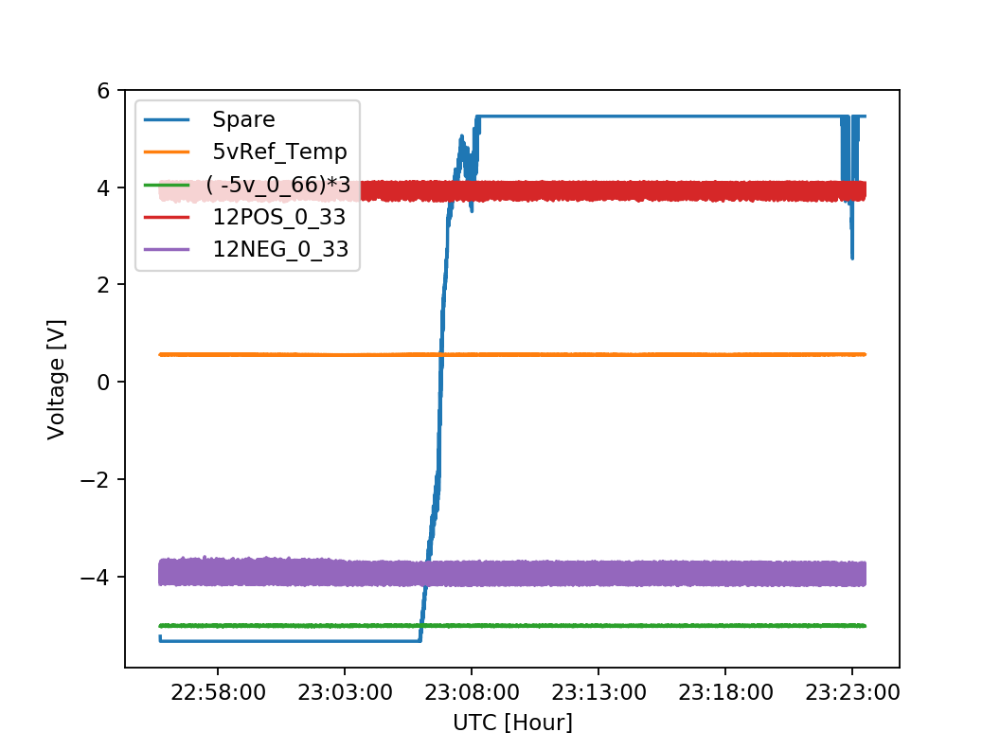

In [23]:
plt.figure()
plt.plot(s['UTC'],s[' Spare'])
plt.plot(s['UTC'],s[' 5vRef_Temp'])
plt.plot(s['UTC'],s[' -5v_0_66']*3,label='( -5v_0_66)*3')
plt.plot(s['UTC'],s[' 12POS_0_33'])
plt.plot(s['UTC'],s[' 12NEG_0_33'])
plt.legend()
plt.xlabel('UTC [Hour]')
plt.ylabel('Voltage [V]')
plt.gca().xaxis.set_major_formatter(myFmt)


In [18]:
ref5v = s[' -5v_0_66']*3

In [19]:
np.nanmean(ref5v)

-5.020171257449504

### Test 2020-11-04

In [36]:
s1.keys()

Index([u'YYYY', u'MM', u'DD', u'hh:mm:ss', u'CH1_0', u'CH1_2', u'CH1_4',
       u'CH2_0', u'CH2_2', u'CH2_4', u'CH3_0', u'CH3_2', u'CH3_4', u'CH4_0',
       u'CH4_2', u'CH4_4', u'CH5_0', u'CH5_2', u'CH5_4', u'-5v_0_66', u'CH6_0',
       u'CH6_2', u'CH6_4', u'CH7_0', u'CH7_2', u'CH7_4', u'CH8_0', u'CH8_2',
       u'CH8_4', u'CH9_0', u'CH9_2', u'CH9_4', u'Spare', u'5vRef_Temp',
       u'12POS_0_33', u'12NEG_0_33', u'UTC'],
      dtype='object')

<IPython.core.display.Javascript object>


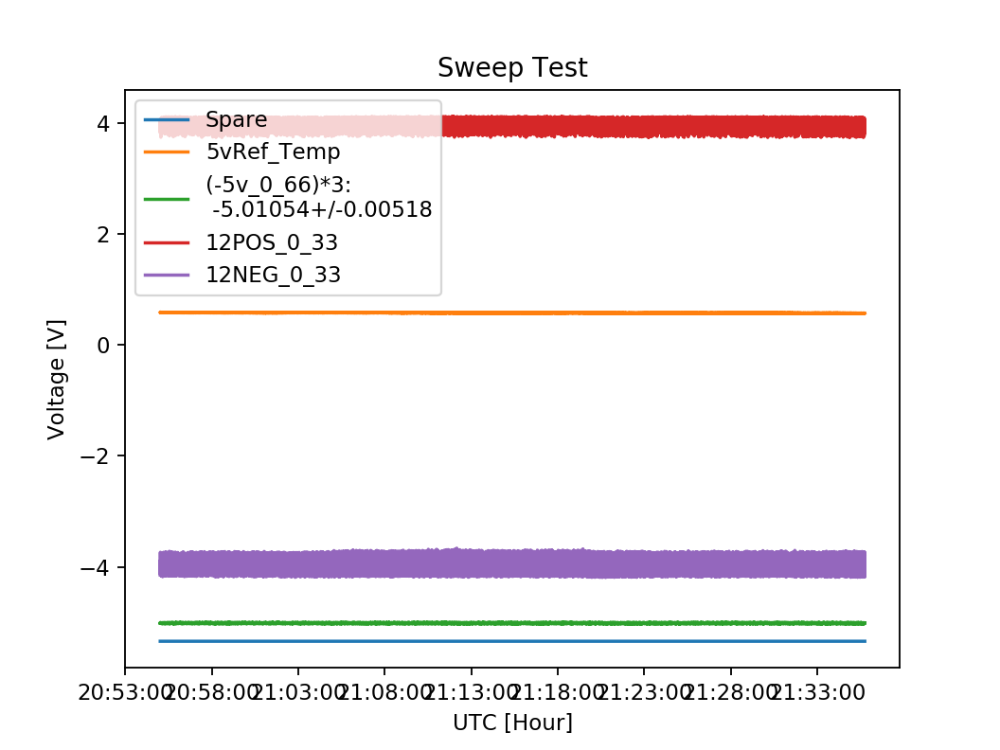

<IPython.core.display.Javascript object>


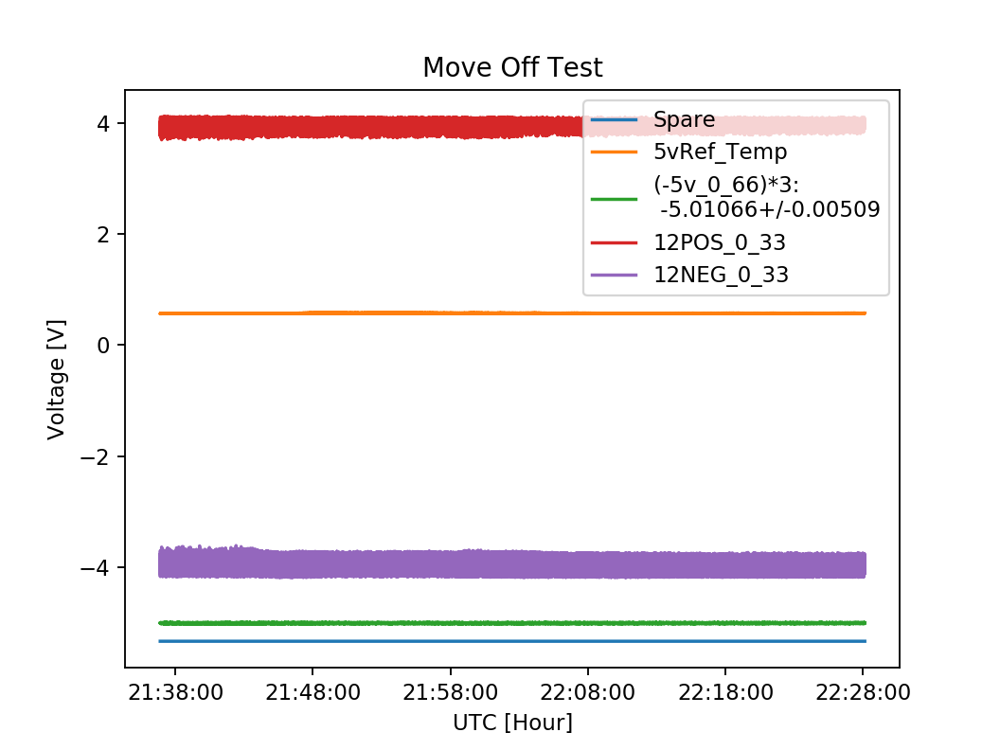

<IPython.core.display.Javascript object>


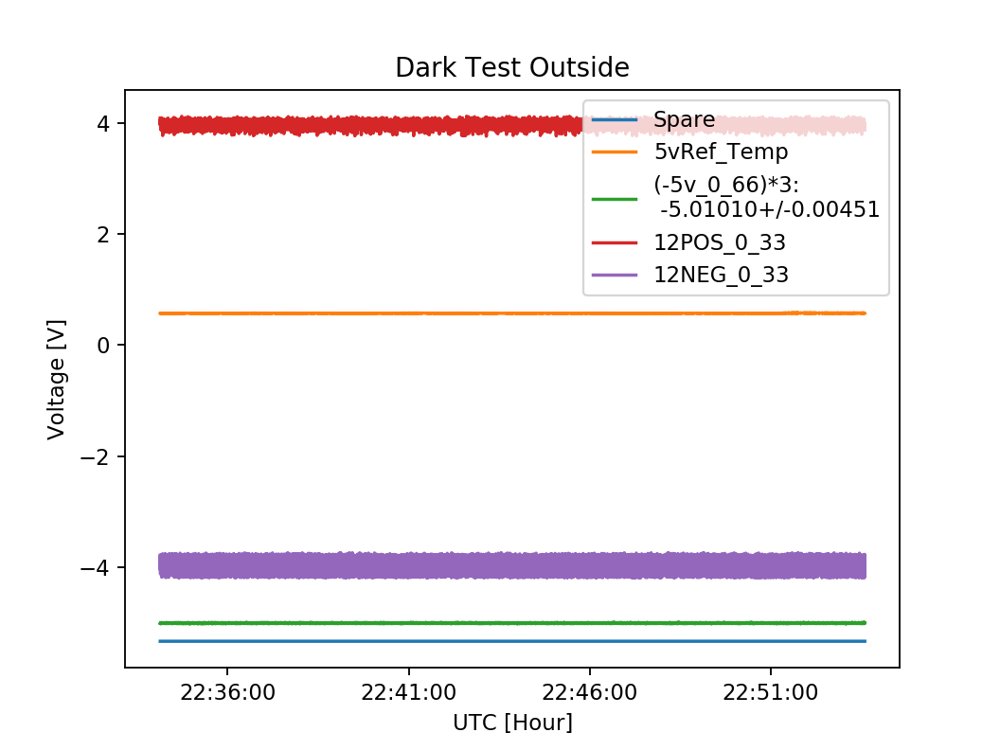

<IPython.core.display.Javascript object>


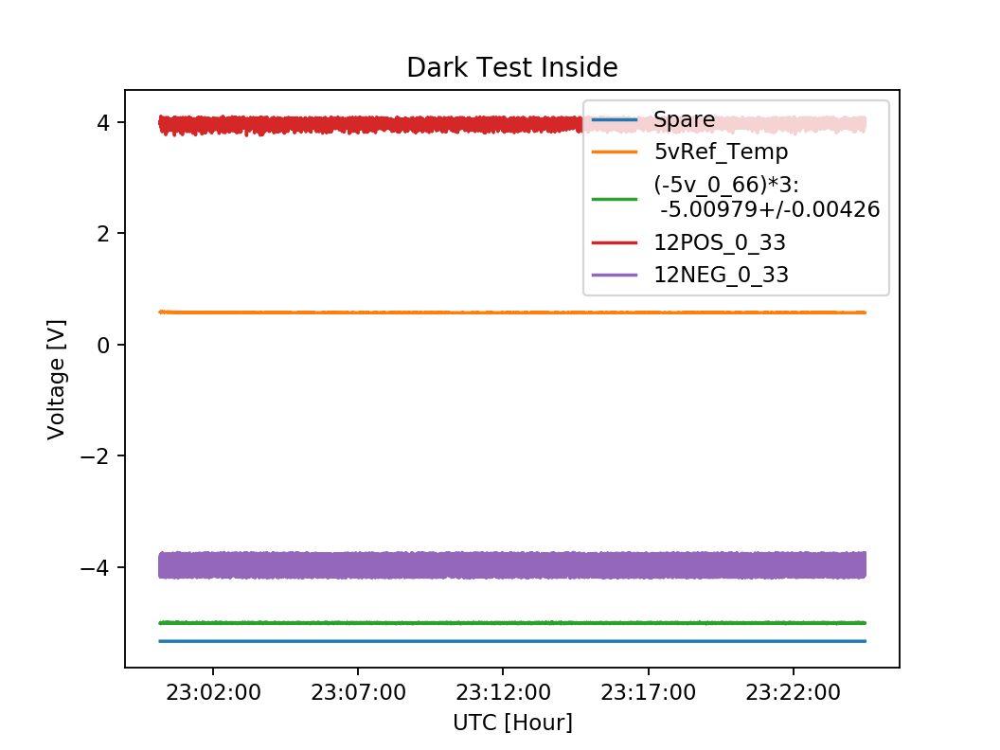

In [50]:
for i,si in enumerate(ss):
    
    plt.figure()
    plt.plot(si['UTC'],si['Spare'])
    plt.plot(si['UTC'],si['5vRef_Temp'])
    plt.plot(si['UTC'],si['ref'],label='(-5v_0_66)*3:\n {:02.5f}+/-{:02.5f}'.format(np.nanmean(si['ref']),np.nanstd(si['ref'])))
    plt.plot(si['UTC'],si['12POS_0_33'])
    plt.plot(si['UTC'],si['12NEG_0_33'])
    plt.legend()
    plt.xlabel('UTC [Hour]')
    plt.ylabel('Voltage [V]')
    plt.gca().xaxis.set_major_formatter(myFmt)
    plt.title(Titles[i])

### Test 2021-01-14

## Against reference signal

### Test 2020-10-16

#### 1x

<IPython.core.display.Javascript object>


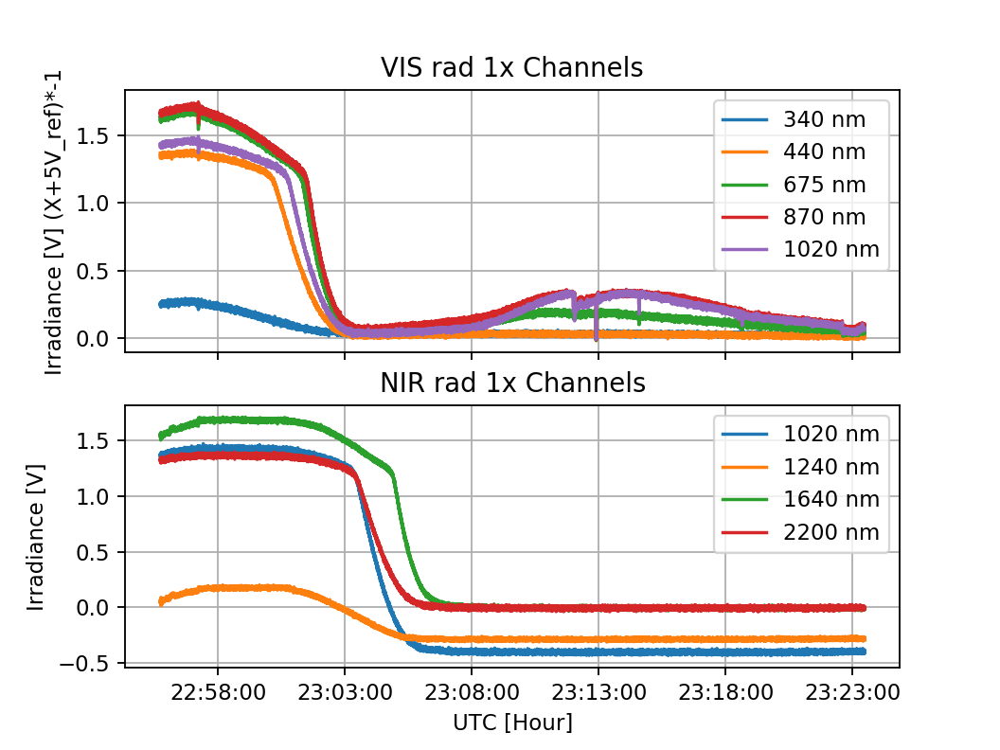

In [27]:
fig,ax = plt.subplots(2,1)
ax[0].plot(s['UTC'],-s['CH1_0']-ref5v,label='340 nm')
ax[0].plot(s['UTC'],-s[' CH2_0']-ref5v,label='440 nm')
ax[0].plot(s['UTC'],-s[' CH3_0']-ref5v,label='675 nm')
ax[0].plot(s['UTC'],-s[' CH4_0']-ref5v,label='870 nm')
ax[0].plot(s['UTC'],-s[' CH5_0']-ref5v,label='1020 nm')
ax[0].set_title('VIS rad 1x Channels')
#ax[0].set_xlabel('UTC [Hour]')
ax[0].xaxis.set_major_formatter(myFmt)
ax[0].set_xticklabels([])
ax[0].set_ylabel('Irradiance [V] (X+5V_ref)*-1')
ax[0].grid()
ax[0].legend()

ax[1].plot(s['UTC'],-s[' CH6_0']-ref5v,label='1020 nm')
ax[1].plot(s['UTC'],-s[' CH7_0']-ref5v,label='1240 nm')
ax[1].plot(s['UTC'],-s[' CH8_0']-ref5v,label='1640 nm')
ax[1].plot(s['UTC'],-s[' CH9_0']-ref5v,label='2200 nm')
ax[1].set_title('NIR rad 1x Channels')
ax[1].set_xlabel('UTC [Hour]')
ax[1].xaxis.set_major_formatter(myFmt)
ax[1].set_ylabel('Irradiance [V]')
ax[1].grid()
ax[1].legend()

plt.savefig(fp+'2020101622_rad_test_1x_ref.png',dpi=600,transparent=True)

<IPython.core.display.Javascript object>


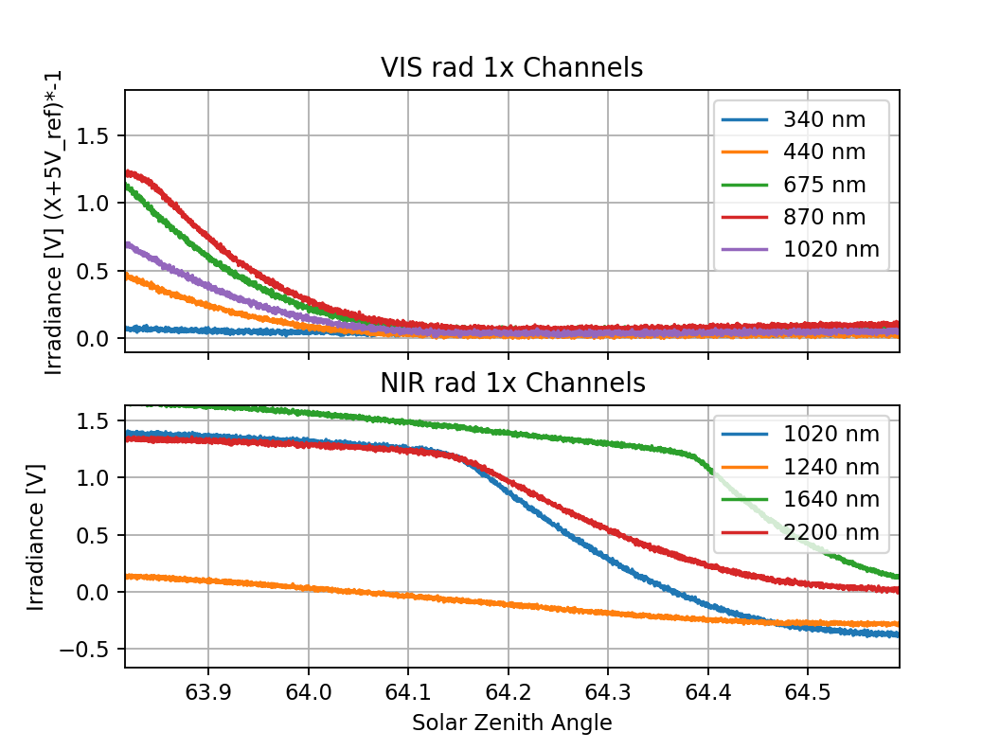

In [22]:
fig,ax = plt.subplots(2,1,sharex=True)
ax[0].plot(sza,-s['CH1_0']-ref5v,label='340 nm')
ax[0].plot(sza,-s[' CH2_0']-ref5v,label='440 nm')
ax[0].plot(sza,-s[' CH3_0']-ref5v,label='675 nm')
ax[0].plot(sza,-s[' CH4_0']-ref5v,label='870 nm')
ax[0].plot(sza,-s[' CH5_0']-ref5v,label='1020 nm')
ax[0].set_title('VIS rad 1x Channels')
#ax[0].set_xlabel('UTC [Hour]')
#ax[0].xaxis.set_major_formatter(myFmt)
#ax[0].set_xticklabels([])
ax[0].set_ylabel('Irradiance [V] (X+5V_ref)*-1')
ax[0].grid()
ax[0].legend()

ax[1].plot(sza,-s[' CH6_0']-ref5v,label='1020 nm')
ax[1].plot(sza,-s[' CH7_0']-ref5v,label='1240 nm')
ax[1].plot(sza,-s[' CH8_0']-ref5v,label='1640 nm')
ax[1].plot(sza,-s[' CH9_0']-ref5v,label='2200 nm')
ax[1].set_title('NIR rad 1x Channels')
ax[1].set_xlabel('Solar Zenith Angle')
#ax[1].xaxis.set_major_formatter(myFmt)
ax[1].set_ylabel('Irradiance [V]')
ax[1].grid()
ax[1].legend()

plt.savefig(fp+'2020101622_SZA_rad_test_1x_ref.png',dpi=600,transparent=True)

#### 100x

<IPython.core.display.Javascript object>


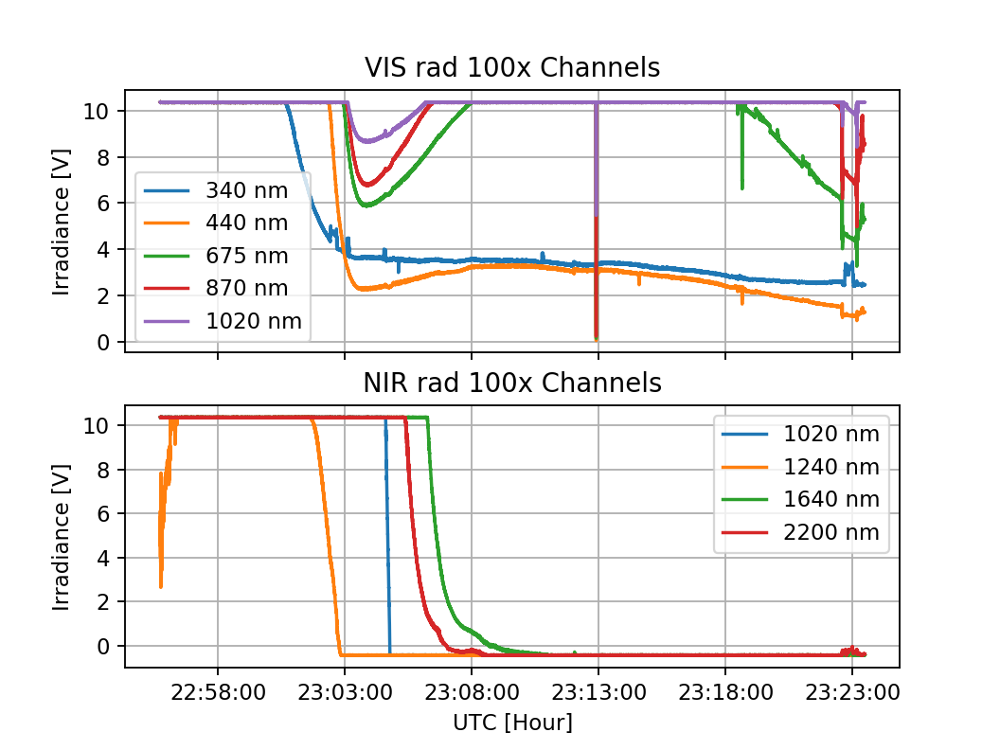

In [29]:
fig,ax = plt.subplots(2,1)
ax[0].plot(s['UTC'],-s[' CH1_2']-ref5v,label='340 nm')
ax[0].plot(s['UTC'],-s[' CH2_2']-ref5v,label='440 nm')
ax[0].plot(s['UTC'],-s[' CH3_2']-ref5v,label='675 nm')
ax[0].plot(s['UTC'],-s[' CH4_2']-ref5v,label='870 nm')
ax[0].plot(s['UTC'],-s[' CH5_2']-ref5v,label='1020 nm')
ax[0].set_title('VIS rad 100x Channels')
#ax[0].xlabel('UTC [Hour]')
ax[0].xaxis.set_major_formatter(myFmt)
ax[0].set_xticklabels([])
ax[0].set_ylabel('Irradiance [V]')
ax[0].grid()
ax[0].legend()

ax[1].plot(s['UTC'],-s[' CH6_2']-ref5v,label='1020 nm')
ax[1].plot(s['UTC'],-s[' CH7_2']-ref5v,label='1240 nm')
ax[1].plot(s['UTC'],-s[' CH8_2']-ref5v,label='1640 nm')
ax[1].plot(s['UTC'],-s[' CH9_2']-ref5v,label='2200 nm')
ax[1].set_title('NIR rad 100x Channels')
ax[1].set_xlabel('UTC [Hour]')
ax[1].xaxis.set_major_formatter(myFmt)
ax[1].set_ylabel('Irradiance [V]')
ax[1].grid()
ax[1].legend()

plt.savefig(fp+'2020101622_rad_test_100x_ref.png',dpi=600,transparent=True)

<IPython.core.display.Javascript object>


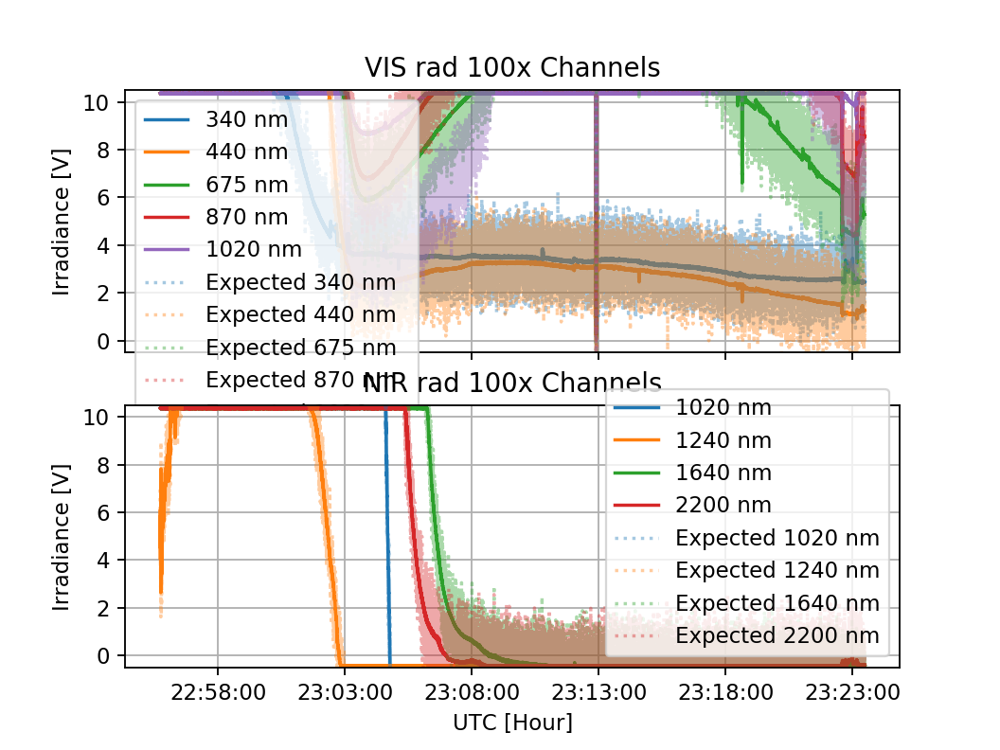

In [38]:
fig,ax = plt.subplots(2,1)
ax[0].plot(s['UTC'],-s[' CH1_2']-ref5v,label='340 nm')
ax[0].plot(s['UTC'],-s[' CH2_2']-ref5v,label='440 nm')
ax[0].plot(s['UTC'],-s[' CH3_2']-ref5v,label='675 nm')
ax[0].plot(s['UTC'],-s[' CH4_2']-ref5v,label='870 nm')
ax[0].plot(s['UTC'],-s[' CH5_2']-ref5v,label='1020 nm')

ax[0].plot(s['UTC'],(-s['CH1_0']-ref5v)*100.0,label='Expected 340 nm',ls=':',alpha=0.4,c='tab:blue')
ax[0].plot(s['UTC'],(-s[' CH2_0']-ref5v)*100.0,label='Expected 440 nm',ls=':',alpha=0.4,c='tab:orange')
ax[0].plot(s['UTC'],(-s[' CH3_0']-ref5v)*100.0,label='Expected 675 nm',ls=':',alpha=0.4,c='tab:green')
ax[0].plot(s['UTC'],(-s[' CH4_0']-ref5v)*100.0,label='Expected 870 nm',ls=':',alpha=0.4,c='tab:red')
ax[0].plot(s['UTC'],(-s[' CH5_0']-ref5v)*100.0,label='Expected 1020 nm',ls=':',alpha=0.4,c='tab:purple')


ax[0].set_title('VIS rad 100x Channels')
#ax[0].xlabel('UTC [Hour]')
ax[0].xaxis.set_major_formatter(myFmt)
ax[0].set_xticklabels([])
ax[0].set_ylabel('Irradiance [V]')
ax[0].grid()
ax[0].legend()
ax[0].set_ylim(-0.5,10.5)

ax[1].plot(s['UTC'],-s[' CH6_2']-ref5v,label='1020 nm')
ax[1].plot(s['UTC'],-s[' CH7_2']-ref5v,label='1240 nm')
ax[1].plot(s['UTC'],-s[' CH8_2']-ref5v,label='1640 nm')
ax[1].plot(s['UTC'],-s[' CH9_2']-ref5v,label='2200 nm')

ax[1].plot(s['UTC'],(-s[' CH6_0']-ref5v)*100.0,label='Expected 1020 nm',ls=':',alpha=0.4,c='tab:blue')
ax[1].plot(s['UTC'],(-s[' CH7_0']-ref5v)*100.0,label='Expected 1240 nm',ls=':',alpha=0.4,c='tab:orange')
ax[1].plot(s['UTC'],(-s[' CH8_0']-ref5v)*100.0,label='Expected 1640 nm',ls=':',alpha=0.4,c='tab:green')
ax[1].plot(s['UTC'],(-s[' CH9_0']-ref5v)*100.0,label='Expected 2200 nm',ls=':',alpha=0.4,c='tab:red')
ax[1].set_title('NIR rad 100x Channels')
ax[1].set_xlabel('UTC [Hour]')
ax[1].xaxis.set_major_formatter(myFmt)
ax[1].set_ylabel('Irradiance [V]')
ax[1].grid()
ax[1].legend()
ax[1].set_ylim(-0.5,10.5)

plt.savefig(fp+'2020101622_rad_test_100x_ref_expect.png',dpi=600,transparent=True)

<IPython.core.display.Javascript object>


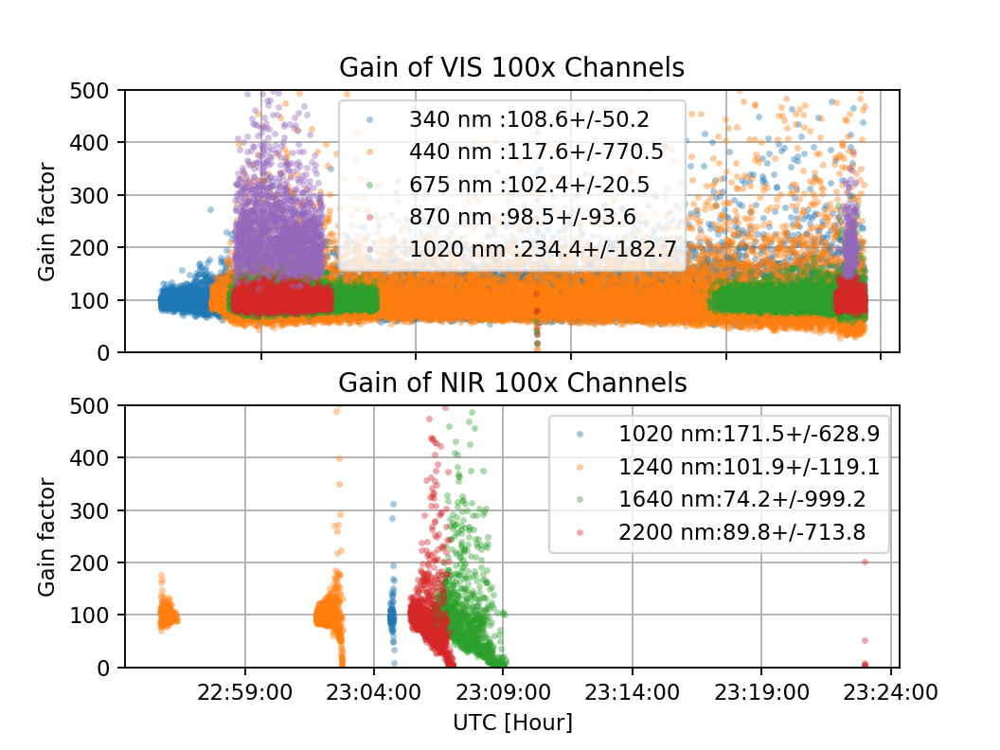

In [64]:
fig,ax = plt.subplots(2,1)
ig1 = (-s[' CH1_2']-ref5v)<10.1
ig2 = (-s[' CH2_2']-ref5v)<10.1
ig3 = (-s[' CH3_2']-ref5v)<10.1
ig4 = (-s[' CH4_2']-ref5v)<10.1
ig5 = (-s[' CH5_2']-ref5v)<10.1

g1 = np.nanmean(((-s[' CH1_2']-ref5v)/(-s['CH1_0']-ref5v))[ig1])
g2 = np.nanmean(((-s[' CH2_2']-ref5v)/(-s[' CH2_0']-ref5v))[ig2])
g3 = np.nanmean(((-s[' CH3_2']-ref5v)/(-s[' CH3_0']-ref5v))[ig3])
g4 = np.nanmean(((-s[' CH4_2']-ref5v)/(-s[' CH4_0']-ref5v))[ig4])
g5 = np.nanmean(((-s[' CH5_2']-ref5v)/(-s[' CH5_0']-ref5v))[ig5])

eg1 = np.nanstd(((-s[' CH1_2']-ref5v)/(-s['CH1_0']-ref5v))[ig1])
eg2 = np.nanstd(((-s[' CH2_2']-ref5v)/(-s[' CH2_0']-ref5v))[ig2])
eg3 = np.nanstd(((-s[' CH3_2']-ref5v)/(-s[' CH3_0']-ref5v))[ig3])
eg4 = np.nanstd(((-s[' CH4_2']-ref5v)/(-s[' CH4_0']-ref5v))[ig4])
eg5 = np.nanstd(((-s[' CH5_2']-ref5v)/(-s[' CH5_0']-ref5v))[ig5])

ax[0].plot(s['UTC'][ig1],((-s[' CH1_2']-ref5v)/(-s['CH1_0']-ref5v))[ig1],'.',
           label='340 nm :{:3.1f}+/-{:3.1f}'.format(g1,eg1),alpha=0.4,mec='None')
ax[0].plot(s['UTC'][ig2],((-s[' CH2_2']-ref5v)/(-s[' CH2_0']-ref5v))[ig2],'.',
           label='440 nm :{:3.1f}+/-{:3.1f}'.format(g2,eg2),alpha=0.4,mec='None')
ax[0].plot(s['UTC'][ig3],((-s[' CH3_2']-ref5v)/(-s[' CH3_0']-ref5v))[ig3],'.',
           label='675 nm :{:3.1f}+/-{:3.1f}'.format(g3,eg3),alpha=0.4,mec='None')
ax[0].plot(s['UTC'][ig4],((-s[' CH4_2']-ref5v)/(-s[' CH4_0']-ref5v))[ig4],'.',
           label='870 nm :{:3.1f}+/-{:3.1f}'.format(g4,eg4),alpha=0.4,mec='None')
ax[0].plot(s['UTC'][ig5],((-s[' CH5_2']-ref5v)/(-s[' CH5_0']-ref5v))[ig5],'.',
           label='1020 nm :{:3.1f}+/-{:3.1f}'.format(g5,eg5),alpha=0.4,mec='None')

ax[0].set_title('Gain of VIS 100x Channels')
#ax[0].xlabel('UTC [Hour]')
ax[0].xaxis.set_major_formatter(myFmt)
ax[0].set_xticklabels([])
ax[0].set_ylabel('Gain factor')
ax[0].grid()
ax[0].legend()
ax[0].set_ylim(0,500)

ign1 = ((-s[' CH6_2']-ref5v)<10.1) & ((-s[' CH6_2']-ref5v)>-0.1)
ign2 = ((-s[' CH7_2']-ref5v)<10.1) & ((-s[' CH7_2']-ref5v)>-0.1)
ign3 = ((-s[' CH8_2']-ref5v)<10.1) & ((-s[' CH8_2']-ref5v)>-0.1)
ign4 = ((-s[' CH9_2']-ref5v)<10.1) & ((-s[' CH9_2']-ref5v)>-0.1)

gn1 = np.nanmean(((-s[' CH6_2']-ref5v)/(-s[' CH6_0']-ref5v))[ign1])
gn2 = np.nanmean(((-s[' CH7_2']-ref5v)/(-s[' CH7_0']-ref5v))[ign2])
gn3 = np.nanmean(((-s[' CH8_2']-ref5v)/(-s[' CH8_0']-ref5v))[ign3])
gn4 = np.nanmean(((-s[' CH9_2']-ref5v)/(-s[' CH9_0']-ref5v))[ign4])

egn1 = np.nanstd(((-s[' CH6_2']-ref5v)/(-s[' CH6_0']-ref5v))[ign1])
egn2 = np.nanstd(((-s[' CH7_2']-ref5v)/(-s[' CH7_0']-ref5v))[ign2])
egn3 = np.nanstd(((-s[' CH8_2']-ref5v)/(-s[' CH8_0']-ref5v))[ign3])
egn4 = np.nanstd(((-s[' CH9_2']-ref5v)/(-s[' CH9_0']-ref5v))[ign4])

ax[1].plot(s['UTC'][ign1],((-s[' CH6_2']-ref5v)/(-s[' CH6_0']-ref5v))[ign1],'.',
           label='1020 nm:{:3.1f}+/-{:3.1f}'.format(gn1,egn1),alpha=0.4,mec='None')
ax[1].plot(s['UTC'][ign2],((-s[' CH7_2']-ref5v)/(-s[' CH7_0']-ref5v))[ign2],'.',
           label='1240 nm:{:3.1f}+/-{:3.1f}'.format(gn2,egn2),alpha=0.4,mec='None')
ax[1].plot(s['UTC'][ign3],((-s[' CH8_2']-ref5v)/(-s[' CH8_0']-ref5v))[ign3],'.',
           label='1640 nm:{:3.1f}+/-{:3.1f}'.format(gn3,egn3),alpha=0.4,mec='None')
ax[1].plot(s['UTC'][ign4],((-s[' CH9_2']-ref5v)/(-s[' CH9_0']-ref5v))[ign4],'.',
           label='2200 nm:{:3.1f}+/-{:3.1f}'.format(gn4,egn4),alpha=0.4,mec='None')

ax[1].set_title('Gain of NIR 100x Channels')
ax[1].set_xlabel('UTC [Hour]')
ax[1].xaxis.set_major_formatter(myFmt)
ax[1].set_ylabel('Gain factor')
ax[1].grid()
ax[1].legend()
ax[1].set_ylim(0,500)

plt.savefig(fp+'2020101622_rad_test_gainof100x.png',dpi=600,transparent=True)

#### 100x - 100x

<IPython.core.display.Javascript object>


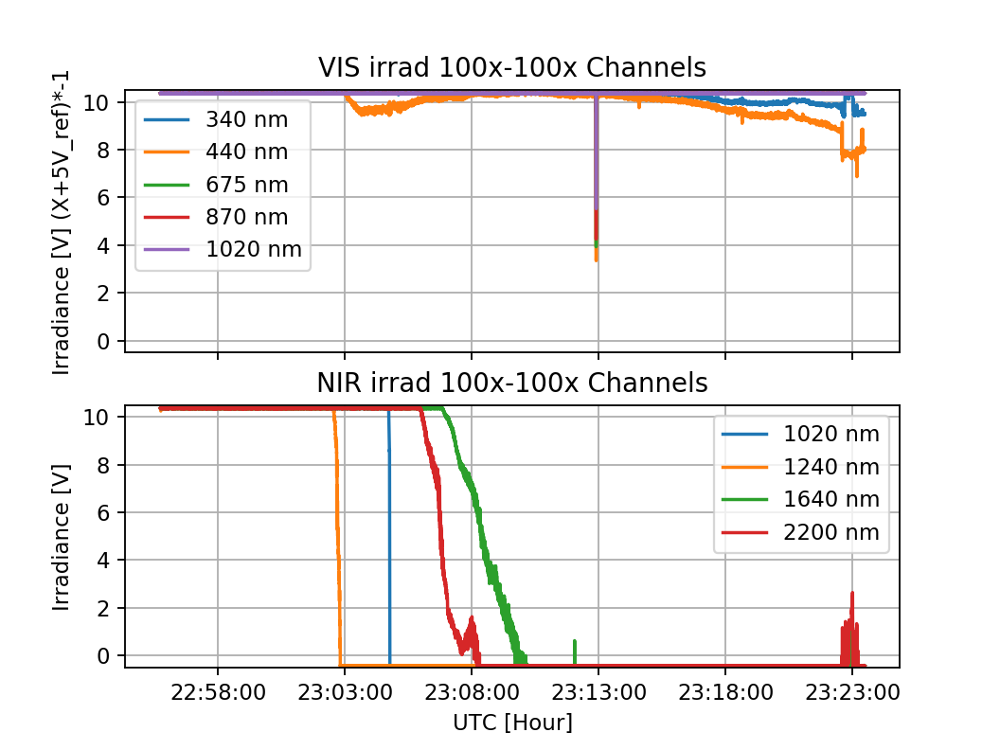

In [66]:
fig,ax = plt.subplots(2,1)
ax[0].plot(s['UTC'],-s[' CH1_4']-ref5v,label='340 nm')
ax[0].plot(s['UTC'],-s[' CH2_4']-ref5v,label='440 nm')
ax[0].plot(s['UTC'],-s[' CH3_4']-ref5v,label='675 nm')
ax[0].plot(s['UTC'],-s[' CH4_4']-ref5v,label='870 nm')
ax[0].plot(s['UTC'],-s[' CH5_4']-ref5v,label='1020 nm')
ax[0].set_title('VIS irrad 100x-100x Channels')
#ax[0].xlabel('UTC [Hour]')
ax[0].xaxis.set_major_formatter(myFmt)
ax[0].set_xticklabels([])
ax[0].set_ylabel('Irradiance [V] (X+5V_ref)*-1')
ax[0].grid()
ax[0].legend()
ax[0].set_ylim(-0.5,10.5)

ax[1].plot(s['UTC'],-s[' CH6_4']-ref5v,label='1020 nm')
ax[1].plot(s['UTC'],-s[' CH7_4']-ref5v,label='1240 nm')
ax[1].plot(s['UTC'],-s[' CH8_4']-ref5v,label='1640 nm')
ax[1].plot(s['UTC'],-s[' CH9_4']-ref5v,label='2200 nm')
ax[1].set_title('NIR irrad 100x-100x Channels')
ax[1].set_xlabel('UTC [Hour]')
ax[1].xaxis.set_major_formatter(myFmt)
ax[1].set_ylabel('Irradiance [V]')
ax[1].grid()
ax[1].legend()
ax[1].set_ylim(-0.5,10.5)

plt.savefig(fp+'2020101622_rad_test_100x_100x_ref.png',dpi=600,transparent=True)

<IPython.core.display.Javascript object>


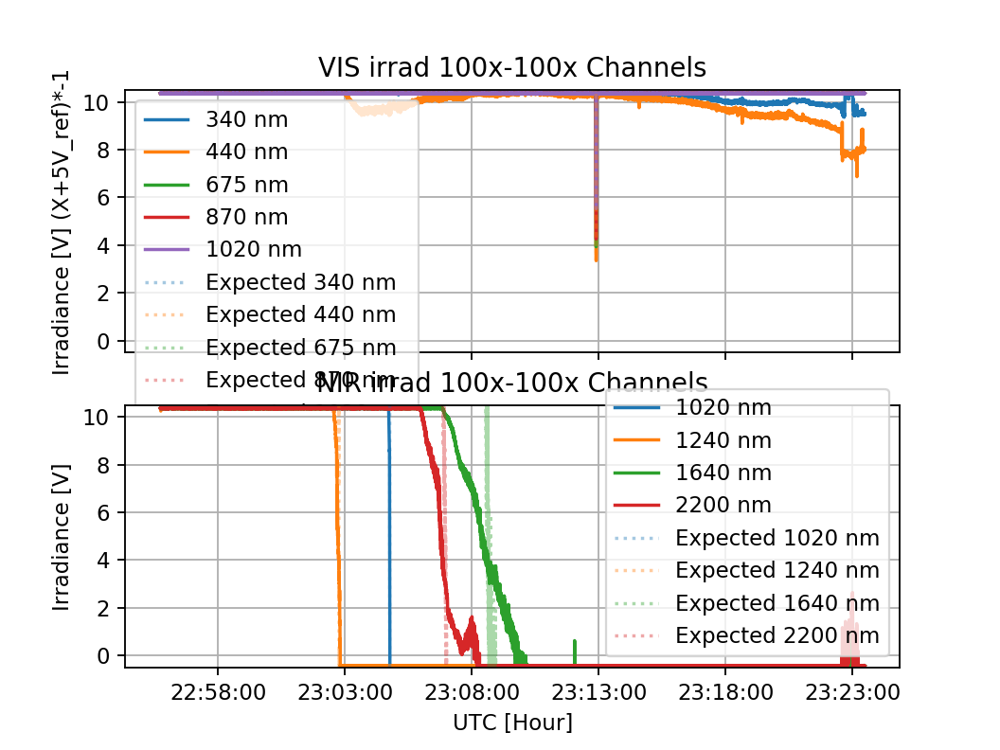

In [63]:
fig,ax = plt.subplots(2,1)
ax[0].plot(s['UTC'],-s[' CH1_4']-ref5v,label='340 nm')
ax[0].plot(s['UTC'],-s[' CH2_4']-ref5v,label='440 nm')
ax[0].plot(s['UTC'],-s[' CH3_4']-ref5v,label='675 nm')
ax[0].plot(s['UTC'],-s[' CH4_4']-ref5v,label='870 nm')
ax[0].plot(s['UTC'],-s[' CH5_4']-ref5v,label='1020 nm')

ax[0].plot(s['UTC'],(-s[' CH1_2']-ref5v)*100.0,label='Expected 340 nm',ls=':',alpha=0.4,c='tab:blue')
ax[0].plot(s['UTC'],(-s[' CH2_2']-ref5v)*100.0,label='Expected 440 nm',ls=':',alpha=0.4,c='tab:orange')
ax[0].plot(s['UTC'],(-s[' CH3_2']-ref5v)*100.0,label='Expected 675 nm',ls=':',alpha=0.4,c='tab:green')
ax[0].plot(s['UTC'],(-s[' CH4_2']-ref5v)*100.0,label='Expected 870 nm',ls=':',alpha=0.4,c='tab:red')
ax[0].plot(s['UTC'],(-s[' CH5_2']-ref5v)*100.0,label='Expected 1020 nm',ls=':',alpha=0.4,c='tab:purple')

ax[0].set_title('VIS irrad 100x-100x Channels')
#ax[0].xlabel('UTC [Hour]')
ax[0].xaxis.set_major_formatter(myFmt)
ax[0].set_xticklabels([])
ax[0].set_ylabel('Irradiance [V] (X+5V_ref)*-1')
ax[0].grid()
ax[0].legend(loc=2)
ax[0].set_ylim(-0.5,10.5)

ax[1].plot(s['UTC'],-s[' CH6_4']-ref5v,label='1020 nm')
ax[1].plot(s['UTC'],-s[' CH7_4']-ref5v,label='1240 nm')
ax[1].plot(s['UTC'],-s[' CH8_4']-ref5v,label='1640 nm')
ax[1].plot(s['UTC'],-s[' CH9_4']-ref5v,label='2200 nm')

ax[1].plot(s['UTC'],(-s[' CH6_2']-ref5v)*100.0,label='Expected 1020 nm',ls=':',alpha=0.4,c='tab:blue')
ax[1].plot(s['UTC'],(-s[' CH7_2']-ref5v)*100.0,label='Expected 1240 nm',ls=':',alpha=0.4,c='tab:orange')
ax[1].plot(s['UTC'],(-s[' CH8_2']-ref5v)*100.0,label='Expected 1640 nm',ls=':',alpha=0.4,c='tab:green')
ax[1].plot(s['UTC'],(-s[' CH9_2']-ref5v)*100.0,label='Expected 2200 nm',ls=':',alpha=0.4,c='tab:red')

ax[1].set_title('NIR irrad 100x-100x Channels')
ax[1].set_xlabel('UTC [Hour]')
ax[1].xaxis.set_major_formatter(myFmt)
ax[1].set_ylabel('Irradiance [V]')
ax[1].grid()
ax[1].legend()
ax[1].set_ylim(-0.5,10.5)

plt.savefig(fp+'2020101622_rad_test_100x_100x_ref_expect.png',dpi=600,transparent=True)

<IPython.core.display.Javascript object>


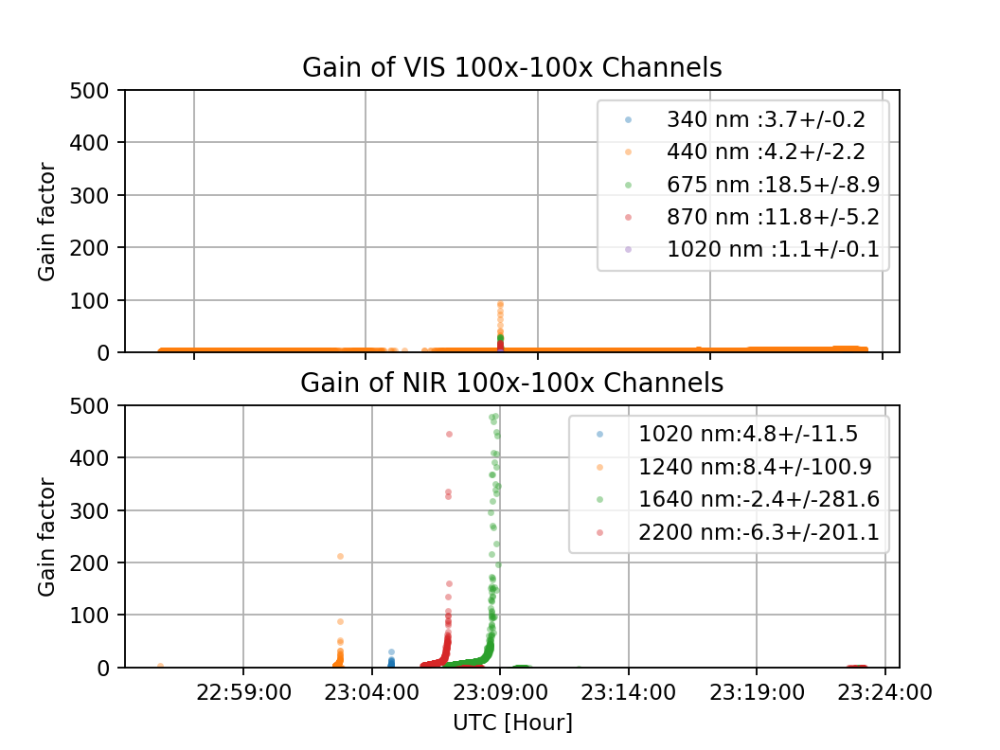

In [67]:
fig,ax = plt.subplots(2,1)
ig1 = (-s[' CH1_4']-ref5v)<10.3
ig2 = (-s[' CH2_4']-ref5v)<10.3
ig3 = (-s[' CH3_4']-ref5v)<10.3
ig4 = (-s[' CH4_4']-ref5v)<10.3
ig5 = (-s[' CH5_4']-ref5v)<10.3

g1 = np.nanmean(((-s[' CH1_4']-ref5v)/(-s[' CH1_2']-ref5v))[ig1])
g2 = np.nanmean(((-s[' CH2_4']-ref5v)/(-s[' CH2_2']-ref5v))[ig2])
g3 = np.nanmean(((-s[' CH3_4']-ref5v)/(-s[' CH3_2']-ref5v))[ig3])
g4 = np.nanmean(((-s[' CH4_4']-ref5v)/(-s[' CH4_2']-ref5v))[ig4])
g5 = np.nanmean(((-s[' CH5_4']-ref5v)/(-s[' CH5_2']-ref5v))[ig5])

eg1 = np.nanstd(((-s[' CH1_4']-ref5v)/(-s[' CH1_2']-ref5v))[ig1])
eg2 = np.nanstd(((-s[' CH2_4']-ref5v)/(-s[' CH2_2']-ref5v))[ig2])
eg3 = np.nanstd(((-s[' CH3_4']-ref5v)/(-s[' CH3_2']-ref5v))[ig3])
eg4 = np.nanstd(((-s[' CH4_4']-ref5v)/(-s[' CH4_2']-ref5v))[ig4])
eg5 = np.nanstd(((-s[' CH5_4']-ref5v)/(-s[' CH5_2']-ref5v))[ig5])

ax[0].plot(s['UTC'][ig1],((-s[' CH1_4']-ref5v)/(-s[' CH1_2']-ref5v))[ig1],'.',
           label='340 nm :{:3.1f}+/-{:3.1f}'.format(g1,eg1),alpha=0.4,mec='None')
ax[0].plot(s['UTC'][ig2],((-s[' CH2_4']-ref5v)/(-s[' CH2_2']-ref5v))[ig2],'.',
           label='440 nm :{:3.1f}+/-{:3.1f}'.format(g2,eg2),alpha=0.4,mec='None')
ax[0].plot(s['UTC'][ig3],((-s[' CH3_4']-ref5v)/(-s[' CH3_2']-ref5v))[ig3],'.',
           label='675 nm :{:3.1f}+/-{:3.1f}'.format(g3,eg3),alpha=0.4,mec='None')
ax[0].plot(s['UTC'][ig4],((-s[' CH4_4']-ref5v)/(-s[' CH4_2']-ref5v))[ig4],'.',
           label='870 nm :{:3.1f}+/-{:3.1f}'.format(g4,eg4),alpha=0.4,mec='None')
ax[0].plot(s['UTC'][ig5],((-s[' CH5_4']-ref5v)/(-s[' CH5_2']-ref5v))[ig5],'.',
           label='1020 nm :{:3.1f}+/-{:3.1f}'.format(g5,eg5),alpha=0.4,mec='None')

ax[0].set_title('Gain of VIS 100x-100x Channels')
#ax[0].xlabel('UTC [Hour]')
ax[0].xaxis.set_major_formatter(myFmt)
ax[0].set_xticklabels([])
ax[0].set_ylabel('Gain factor')
ax[0].grid()
ax[0].legend()
ax[0].set_ylim(0,500)

ign1 = ((-s[' CH6_4']-ref5v)<10.3) & ((-s[' CH6_4']-ref5v)>-0.1)
ign2 = ((-s[' CH7_4']-ref5v)<10.3) & ((-s[' CH7_4']-ref5v)>-0.1)
ign3 = ((-s[' CH8_4']-ref5v)<10.3) & ((-s[' CH8_4']-ref5v)>-0.1)
ign4 = ((-s[' CH9_4']-ref5v)<10.3) & ((-s[' CH9_4']-ref5v)>-0.1)

gn1 = np.nanmean(((-s[' CH6_4']-ref5v)/(-s[' CH6_2']-ref5v))[ign1])
gn2 = np.nanmean(((-s[' CH7_4']-ref5v)/(-s[' CH7_2']-ref5v))[ign2])
gn3 = np.nanmean(((-s[' CH8_4']-ref5v)/(-s[' CH8_2']-ref5v))[ign3])
gn4 = np.nanmean(((-s[' CH9_4']-ref5v)/(-s[' CH9_2']-ref5v))[ign4])

egn1 = np.nanstd(((-s[' CH6_4']-ref5v)/(-s[' CH6_2']-ref5v))[ign1])
egn2 = np.nanstd(((-s[' CH7_4']-ref5v)/(-s[' CH7_2']-ref5v))[ign2])
egn3 = np.nanstd(((-s[' CH8_4']-ref5v)/(-s[' CH8_2']-ref5v))[ign3])
egn4 = np.nanstd(((-s[' CH9_4']-ref5v)/(-s[' CH9_2']-ref5v))[ign4])

ax[1].plot(s['UTC'][ign1],((-s[' CH6_4']-ref5v)/(-s[' CH6_2']-ref5v))[ign1],'.',
           label='1020 nm:{:3.1f}+/-{:3.1f}'.format(gn1,egn1),alpha=0.4,mec='None')
ax[1].plot(s['UTC'][ign2],((-s[' CH7_4']-ref5v)/(-s[' CH7_2']-ref5v))[ign2],'.',
           label='1240 nm:{:3.1f}+/-{:3.1f}'.format(gn2,egn2),alpha=0.4,mec='None')
ax[1].plot(s['UTC'][ign3],((-s[' CH8_4']-ref5v)/(-s[' CH8_2']-ref5v))[ign3],'.',
           label='1640 nm:{:3.1f}+/-{:3.1f}'.format(gn3,egn3),alpha=0.4,mec='None')
ax[1].plot(s['UTC'][ign4],((-s[' CH9_4']-ref5v)/(-s[' CH9_2']-ref5v))[ign4],'.',
           label='2200 nm:{:3.1f}+/-{:3.1f}'.format(gn4,egn4),alpha=0.4,mec='None')

ax[1].set_title('Gain of NIR 100x-100x Channels')
ax[1].set_xlabel('UTC [Hour]')
ax[1].xaxis.set_major_formatter(myFmt)
ax[1].set_ylabel('Gain factor')
ax[1].grid()
ax[1].legend()
ax[1].set_ylim(0,500)

plt.savefig(fp+'2020101622_rad_test_gainof100x_100x.png',dpi=600,transparent=True)

### Test 2020-11-04

#### 1x

<IPython.core.display.Javascript object>


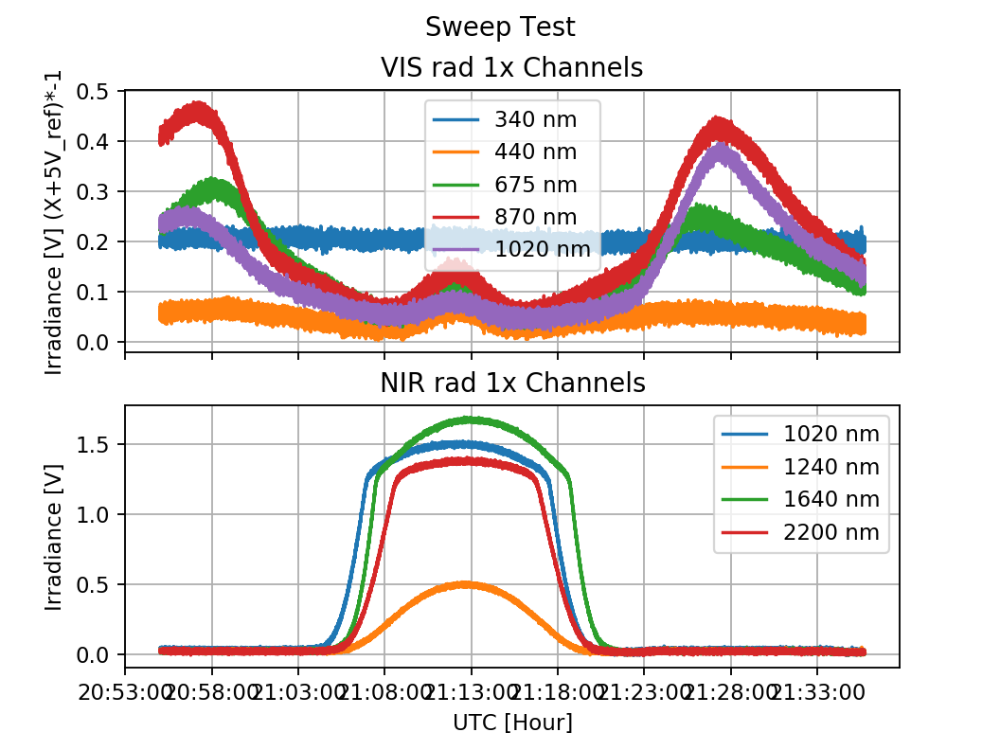

<IPython.core.display.Javascript object>


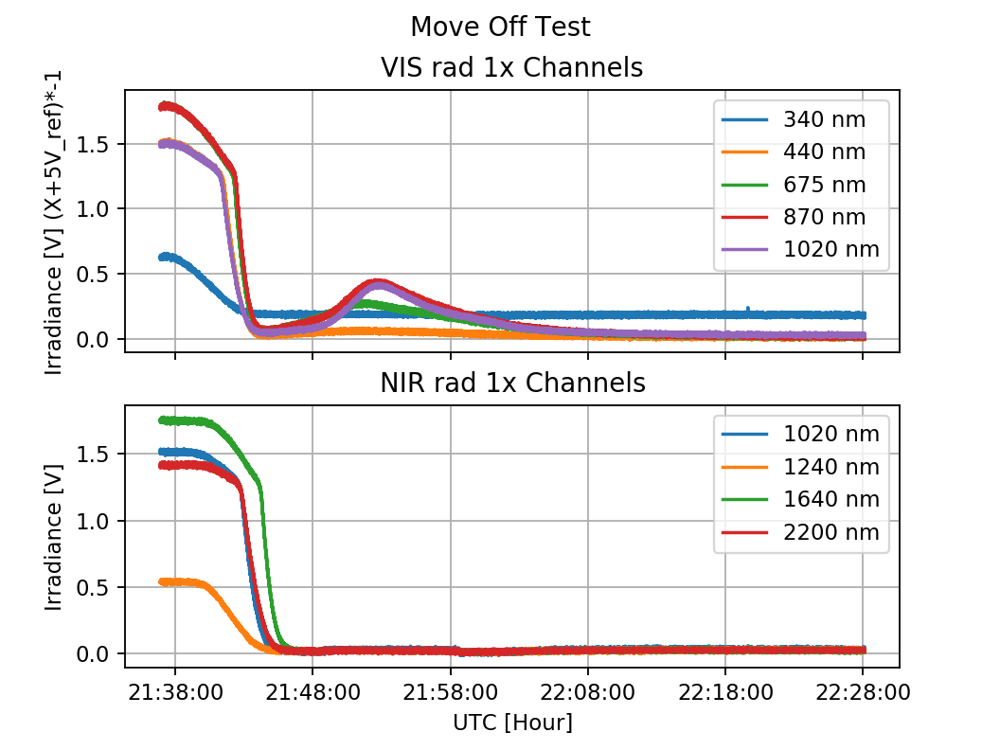

<IPython.core.display.Javascript object>


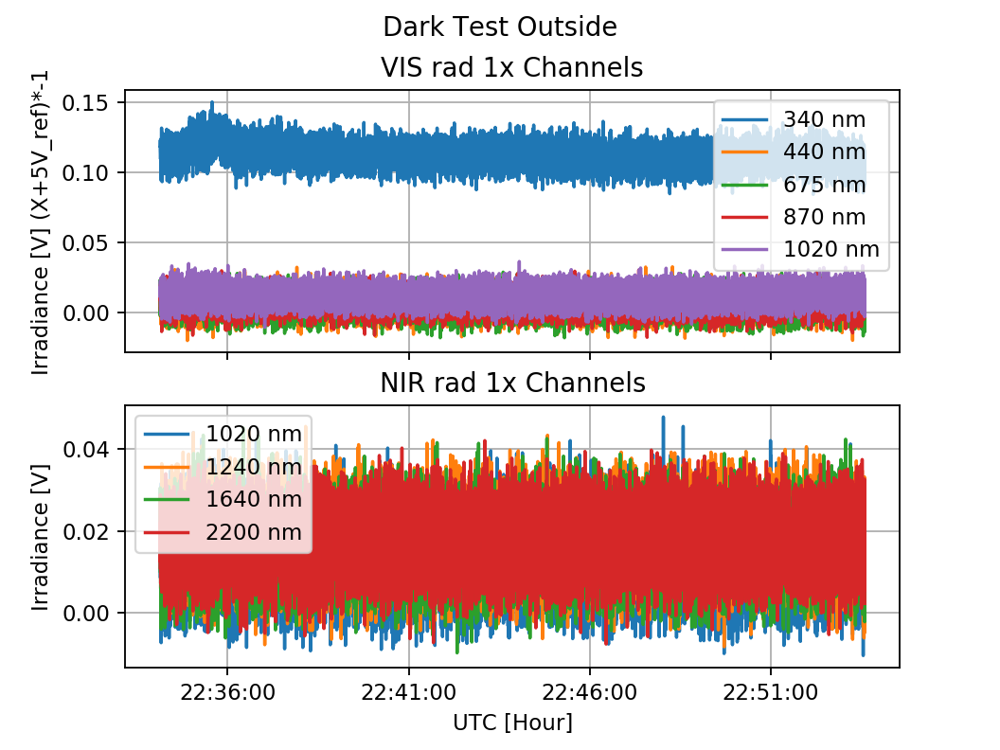

<IPython.core.display.Javascript object>


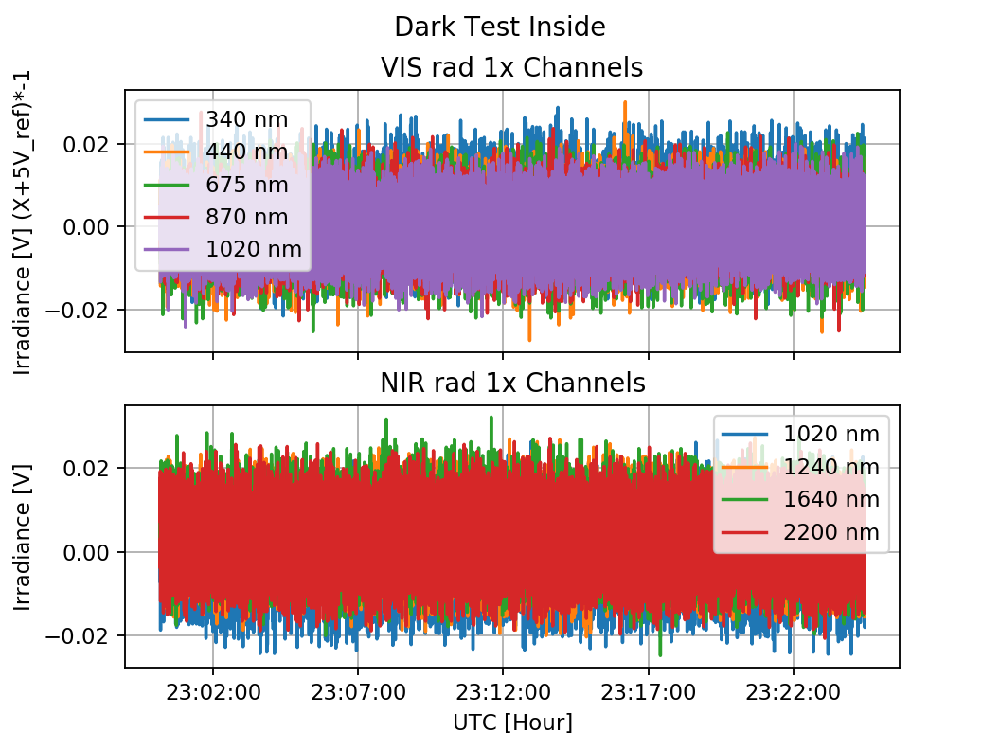

In [53]:

for i,si in enumerate(ss):
    fig,ax = plt.subplots(2,1)
    ax[0].plot(si['UTC'],-si['CH1_0']-si['ref'],label='340 nm')
    ax[0].plot(si['UTC'],-si['CH2_0']-si['ref'],label='440 nm')
    ax[0].plot(si['UTC'],-si['CH3_0']-si['ref'],label='675 nm')
    ax[0].plot(si['UTC'],-si['CH4_0']-si['ref'],label='870 nm')
    ax[0].plot(si['UTC'],-si['CH5_0']-si['ref'],label='1020 nm')
    ax[0].set_title('VIS rad 1x Channels')
    #ax[0].set_xlabel('UTC [Hour]')
    ax[0].xaxis.set_major_formatter(myFmt)
    ax[0].set_xticklabels([])
    ax[0].set_ylabel('Irradiance [V] (X+5V_ref)*-1')
    ax[0].grid()
    ax[0].legend()

    ax[1].plot(si['UTC'],-si['CH6_0']-si['ref'],label='1020 nm')
    ax[1].plot(si['UTC'],-si['CH7_0']-si['ref'],label='1240 nm')
    ax[1].plot(si['UTC'],-si['CH8_0']-si['ref'],label='1640 nm')
    ax[1].plot(si['UTC'],-si['CH9_0']-si['ref'],label='2200 nm')
    ax[1].set_title('NIR rad 1x Channels')
    ax[1].set_xlabel('UTC [Hour]')
    ax[1].xaxis.set_major_formatter(myFmt)
    ax[1].set_ylabel('Irradiance [V]')
    ax[1].grid()
    ax[1].legend()

    plt.suptitle(Titles[i])
    plt.savefig(fp+'20201104_rad_test_1x_ref'+Titles[i]+'.png',dpi=600,transparent=True)

#### 100x

<IPython.core.display.Javascript object>


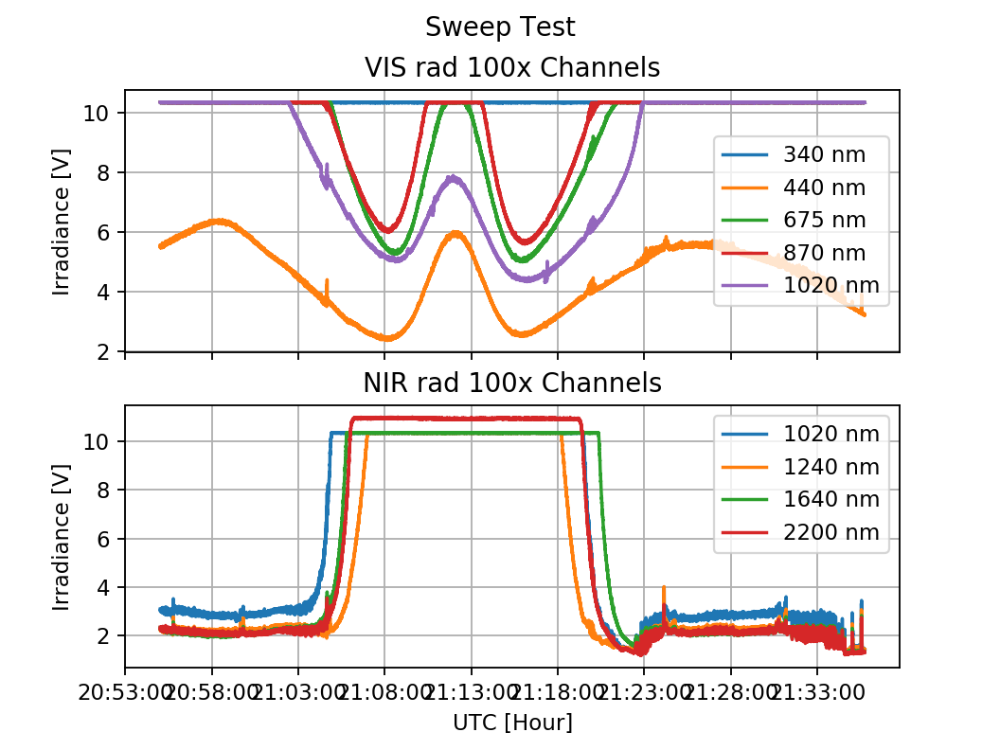

<IPython.core.display.Javascript object>


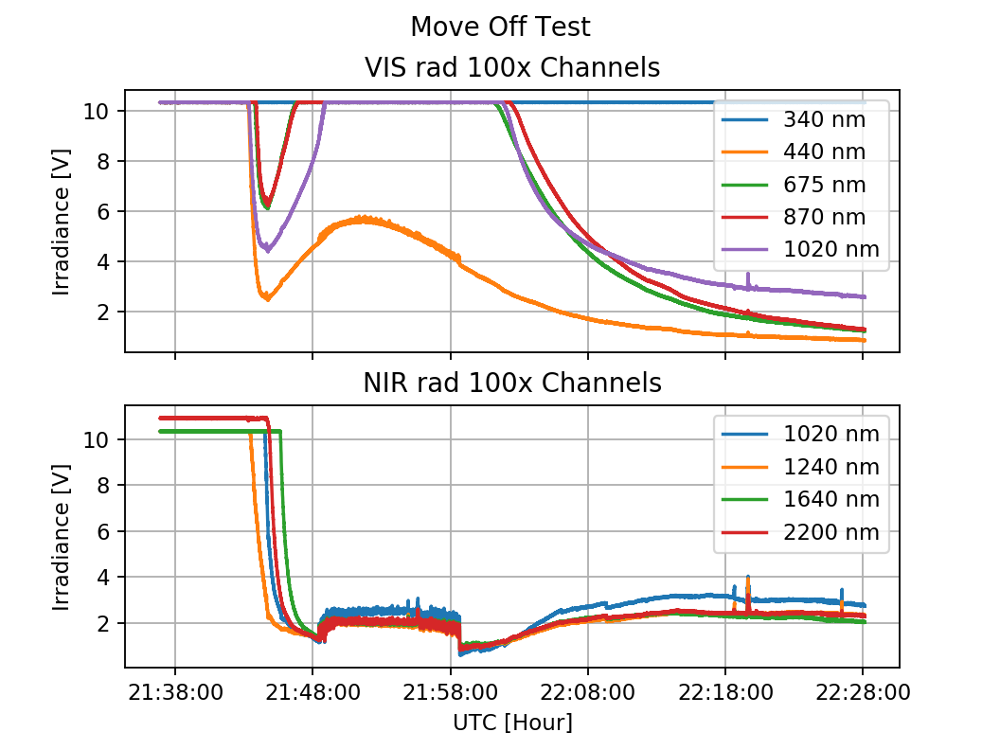

<IPython.core.display.Javascript object>


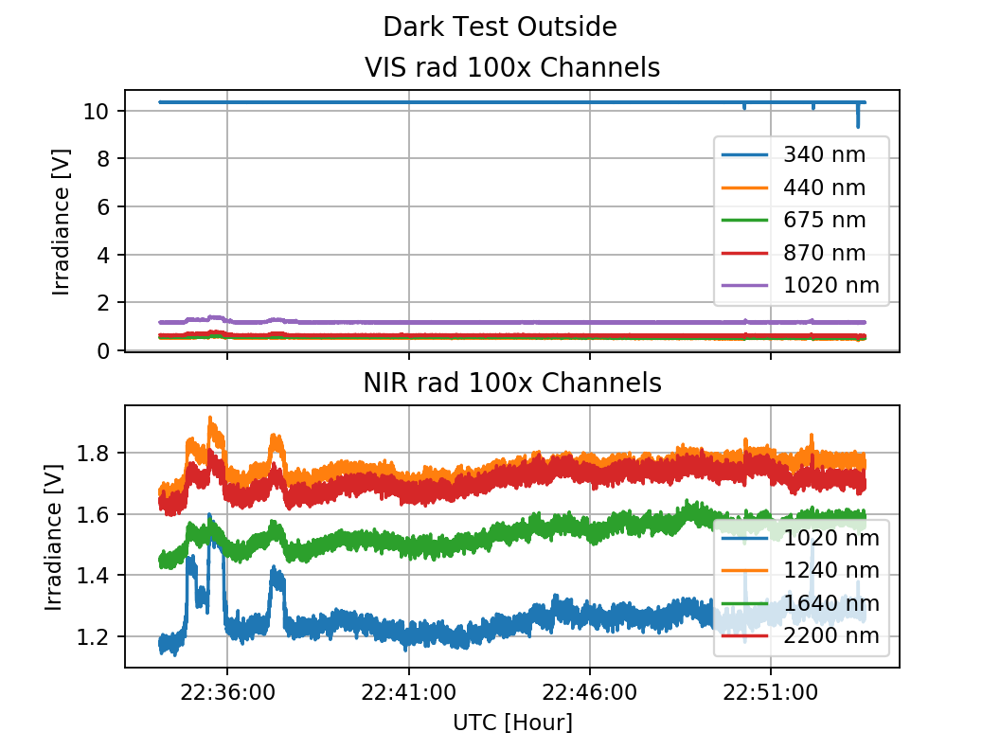

<IPython.core.display.Javascript object>


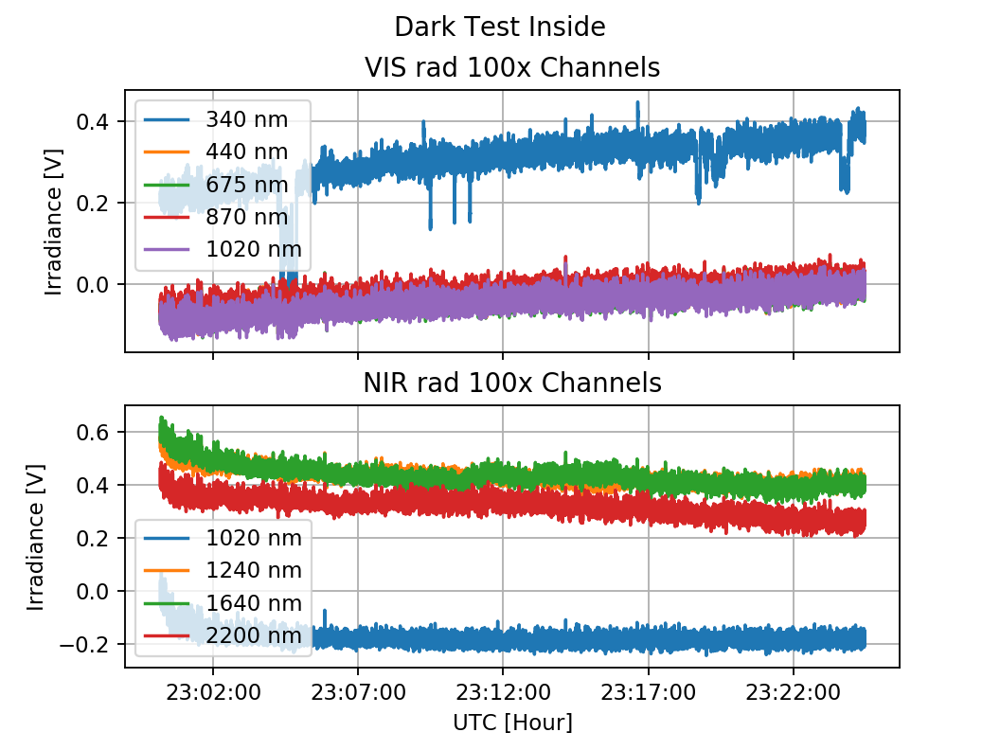

In [54]:
for i,si in enumerate(ss):
    fig,ax = plt.subplots(2,1)
    ax[0].plot(si['UTC'],-si['CH1_2']-si['ref'],label='340 nm')
    ax[0].plot(si['UTC'],-si['CH2_2']-si['ref'],label='440 nm')
    ax[0].plot(si['UTC'],-si['CH3_2']-si['ref'],label='675 nm')
    ax[0].plot(si['UTC'],-si['CH4_2']-si['ref'],label='870 nm')
    ax[0].plot(si['UTC'],-si['CH5_2']-si['ref'],label='1020 nm')
    ax[0].set_title('VIS rad 100x Channels')
    #ax[0].xlabel('UTC [Hour]')
    ax[0].xaxis.set_major_formatter(myFmt)
    ax[0].set_xticklabels([])
    ax[0].set_ylabel('Irradiance [V]')
    ax[0].grid()
    ax[0].legend()

    ax[1].plot(si['UTC'],-si['CH6_2']-si['ref'],label='1020 nm')
    ax[1].plot(si['UTC'],-si['CH7_2']-si['ref'],label='1240 nm')
    ax[1].plot(si['UTC'],-si['CH8_2']-si['ref'],label='1640 nm')
    ax[1].plot(si['UTC'],-si['CH9_2']-si['ref'],label='2200 nm')
    ax[1].set_title('NIR rad 100x Channels')
    ax[1].set_xlabel('UTC [Hour]')
    ax[1].xaxis.set_major_formatter(myFmt)
    ax[1].set_ylabel('Irradiance [V]')
    ax[1].grid()
    ax[1].legend()

    plt.suptitle(Titles[i])
    plt.savefig(fp+'20201104_rad_test_100x_ref'+Titles[i]+'.png',dpi=600,transparent=True)

<IPython.core.display.Javascript object>


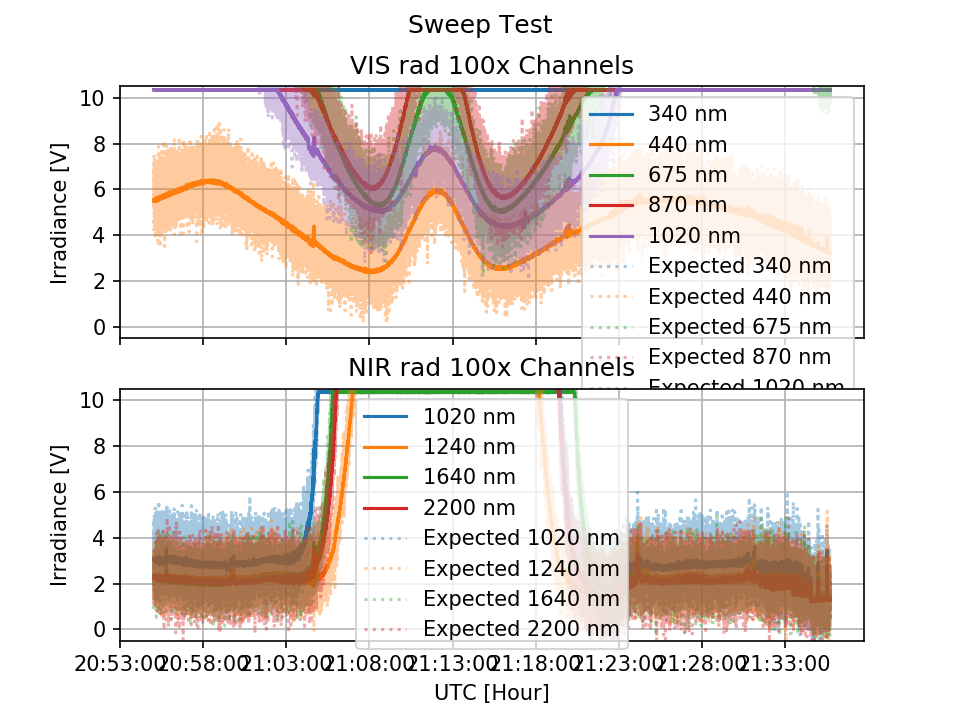

<IPython.core.display.Javascript object>


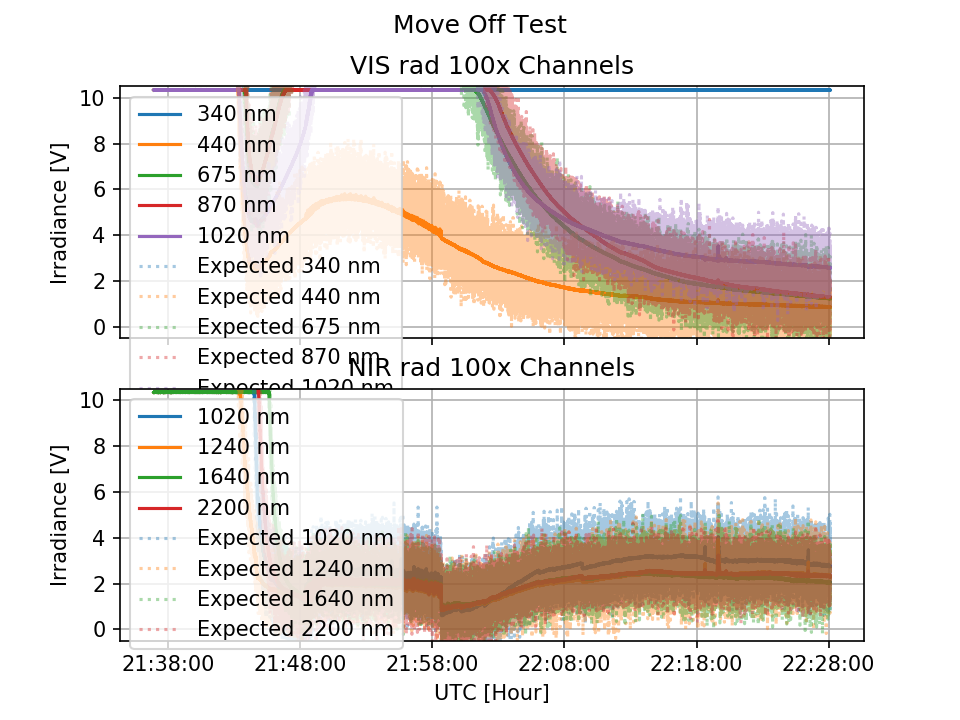

<IPython.core.display.Javascript object>


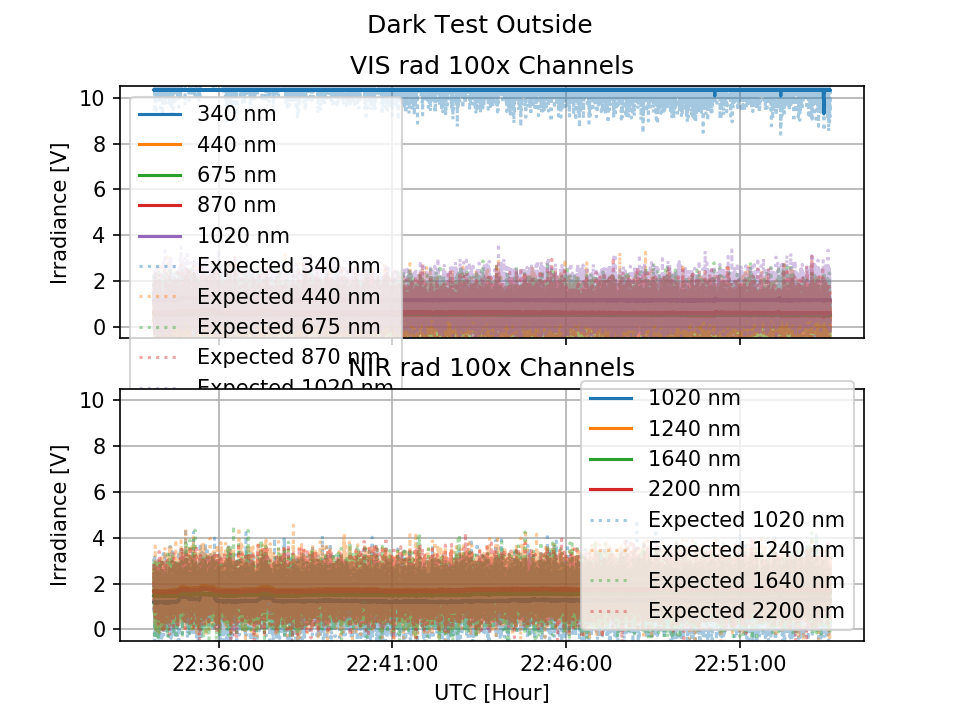

<IPython.core.display.Javascript object>


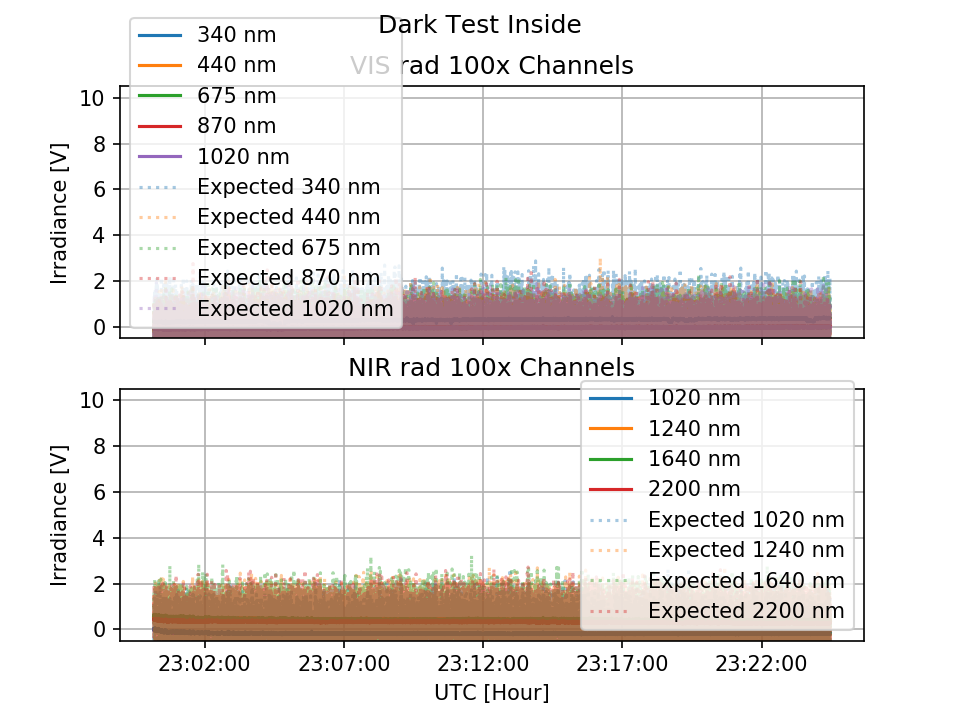

In [57]:
for i,si, in enumerate(ss):
    fig,ax = plt.subplots(2,1)
    ax[0].plot(si['UTC'],-si['CH1_2']-si['ref'],label='340 nm')
    ax[0].plot(si['UTC'],-si['CH2_2']-si['ref'],label='440 nm')
    ax[0].plot(si['UTC'],-si['CH3_2']-si['ref'],label='675 nm')
    ax[0].plot(si['UTC'],-si['CH4_2']-si['ref'],label='870 nm')
    ax[0].plot(si['UTC'],-si['CH5_2']-si['ref'],label='1020 nm')

    ax[0].plot(si['UTC'],(-si['CH1_0']-si['ref'])*100.0,label='Expected 340 nm',ls=':',alpha=0.4,c='tab:blue')
    ax[0].plot(si['UTC'],(-si['CH2_0']-si['ref'])*100.0,label='Expected 440 nm',ls=':',alpha=0.4,c='tab:orange')
    ax[0].plot(si['UTC'],(-si['CH3_0']-si['ref'])*100.0,label='Expected 675 nm',ls=':',alpha=0.4,c='tab:green')
    ax[0].plot(si['UTC'],(-si['CH4_0']-si['ref'])*100.0,label='Expected 870 nm',ls=':',alpha=0.4,c='tab:red')
    ax[0].plot(si['UTC'],(-si['CH5_0']-si['ref'])*100.0,label='Expected 1020 nm',ls=':',alpha=0.4,c='tab:purple')


    ax[0].set_title('VIS rad 100x Channels')
    #ax[0].xlabel('UTC [Hour]')
    ax[0].xaxis.set_major_formatter(myFmt)
    ax[0].set_xticklabels([])
    ax[0].set_ylabel('Irradiance [V]')
    ax[0].grid()
    ax[0].legend()
    ax[0].set_ylim(-0.5,10.5)

    ax[1].plot(si['UTC'],-si['CH6_2']-si['ref'],label='1020 nm')
    ax[1].plot(si['UTC'],-si['CH7_2']-si['ref'],label='1240 nm')
    ax[1].plot(si['UTC'],-si['CH8_2']-si['ref'],label='1640 nm')
    ax[1].plot(si['UTC'],-si['CH9_2']-si['ref'],label='2200 nm')

    ax[1].plot(si['UTC'],(-si['CH6_0']-si['ref'])*100.0,label='Expected 1020 nm',ls=':',alpha=0.4,c='tab:blue')
    ax[1].plot(si['UTC'],(-si['CH7_0']-si['ref'])*100.0,label='Expected 1240 nm',ls=':',alpha=0.4,c='tab:orange')
    ax[1].plot(si['UTC'],(-si['CH8_0']-si['ref'])*100.0,label='Expected 1640 nm',ls=':',alpha=0.4,c='tab:green')
    ax[1].plot(si['UTC'],(-si['CH9_0']-si['ref'])*100.0,label='Expected 2200 nm',ls=':',alpha=0.4,c='tab:red')
    ax[1].set_title('NIR rad 100x Channels')
    ax[1].set_xlabel('UTC [Hour]')
    ax[1].xaxis.set_major_formatter(myFmt)
    ax[1].set_ylabel('Irradiance [V]')
    ax[1].grid()
    ax[1].legend()
    ax[1].set_ylim(-0.5,10.5)

    plt.suptitle(Titles[i])
    plt.savefig(fp+'20201104_rad_test_100x_ref_expect'+Titles[i]+'.png',dpi=600,transparent=True)

#### 100x - 100x

<IPython.core.display.Javascript object>


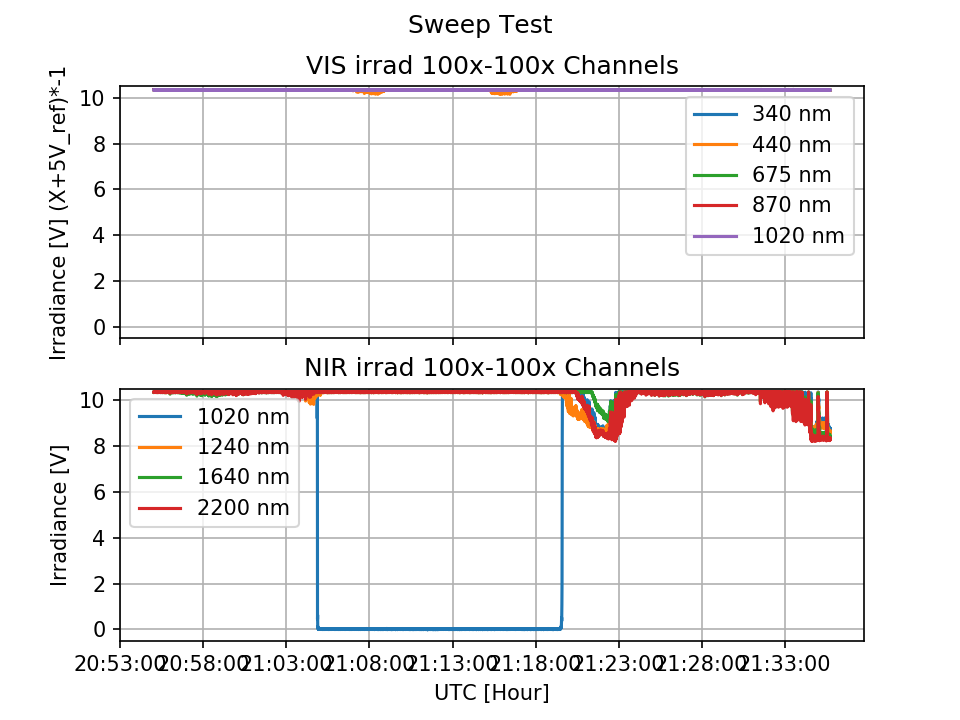

<IPython.core.display.Javascript object>


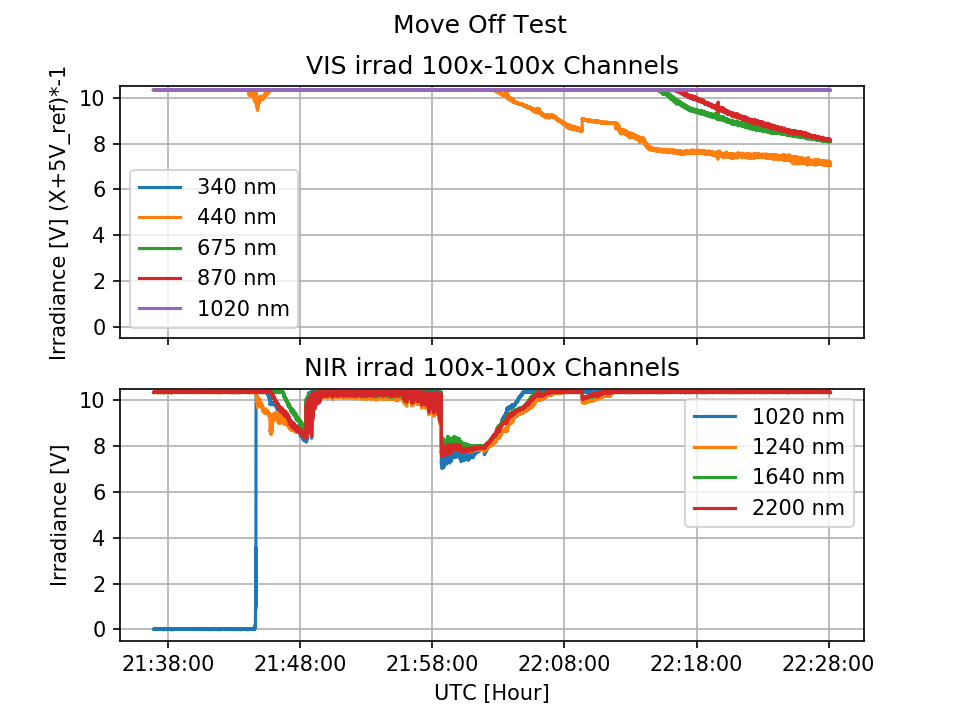

<IPython.core.display.Javascript object>


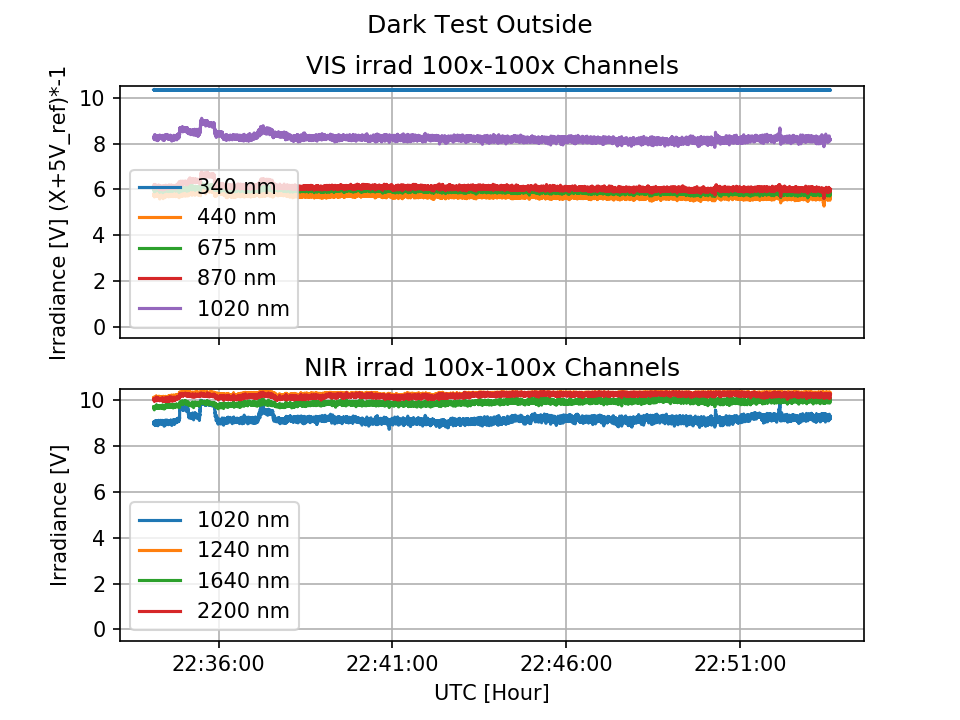

<IPython.core.display.Javascript object>


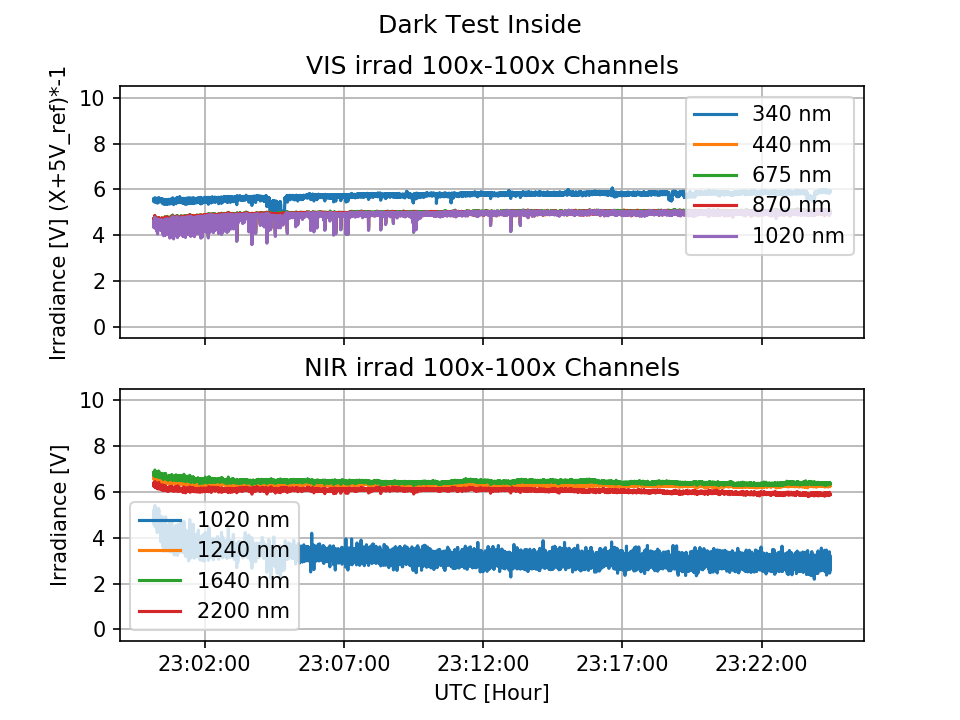

In [56]:
for i, si in enumerate(ss):
    fig,ax = plt.subplots(2,1)
    ax[0].plot(si['UTC'],-si['CH1_4']-si['ref'],label='340 nm')
    ax[0].plot(si['UTC'],-si['CH2_4']-si['ref'],label='440 nm')
    ax[0].plot(si['UTC'],-si['CH3_4']-si['ref'],label='675 nm')
    ax[0].plot(si['UTC'],-si['CH4_4']-si['ref'],label='870 nm')
    ax[0].plot(si['UTC'],-si['CH5_4']-si['ref'],label='1020 nm')
    ax[0].set_title('VIS irrad 100x-100x Channels')
    #ax[0].xlabel('UTC [Hour]')
    ax[0].xaxis.set_major_formatter(myFmt)
    ax[0].set_xticklabels([])
    ax[0].set_ylabel('Irradiance [V] (X+5V_ref)*-1')
    ax[0].grid()
    ax[0].legend()
    ax[0].set_ylim(-0.5,10.5)

    ax[1].plot(si['UTC'],-si['CH6_4']-si['ref'],label='1020 nm')
    ax[1].plot(si['UTC'],-si['CH7_4']-si['ref'],label='1240 nm')
    ax[1].plot(si['UTC'],-si['CH8_4']-si['ref'],label='1640 nm')
    ax[1].plot(si['UTC'],-si['CH9_4']-si['ref'],label='2200 nm')
    ax[1].set_title('NIR irrad 100x-100x Channels')
    ax[1].set_xlabel('UTC [Hour]')
    ax[1].xaxis.set_major_formatter(myFmt)
    ax[1].set_ylabel('Irradiance [V]')
    ax[1].grid()
    ax[1].legend()
    ax[1].set_ylim(-0.5,10.5)

    plt.suptitle(Titles[i])
    plt.savefig(fp+'20201104_rad_test_100x_100x_'+Titles[i]+'ref.png',dpi=600,transparent=True)

<IPython.core.display.Javascript object>


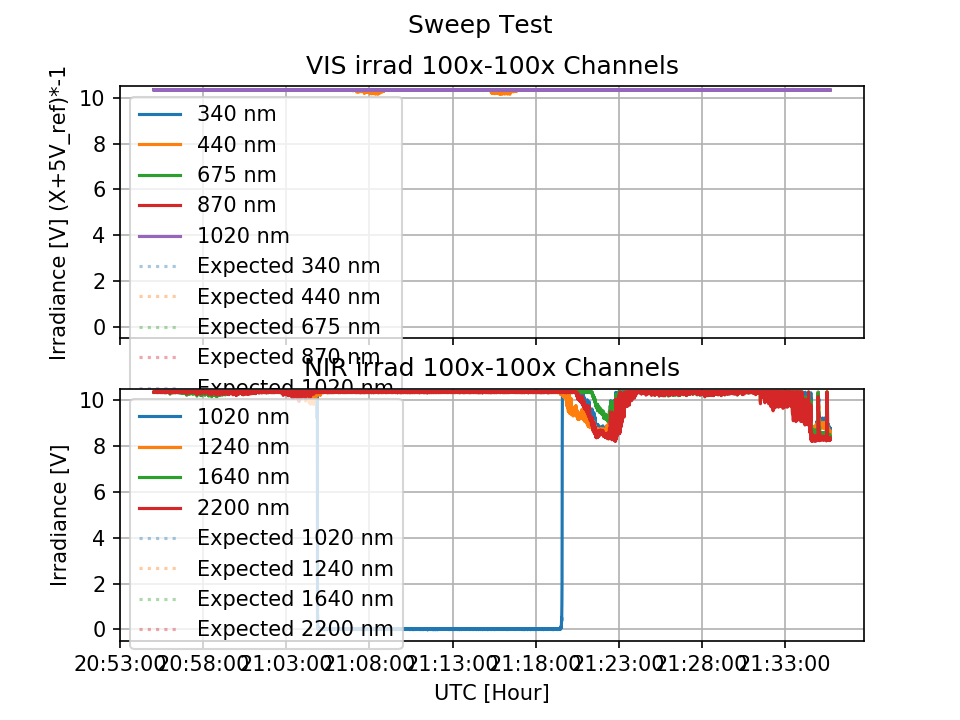

<IPython.core.display.Javascript object>


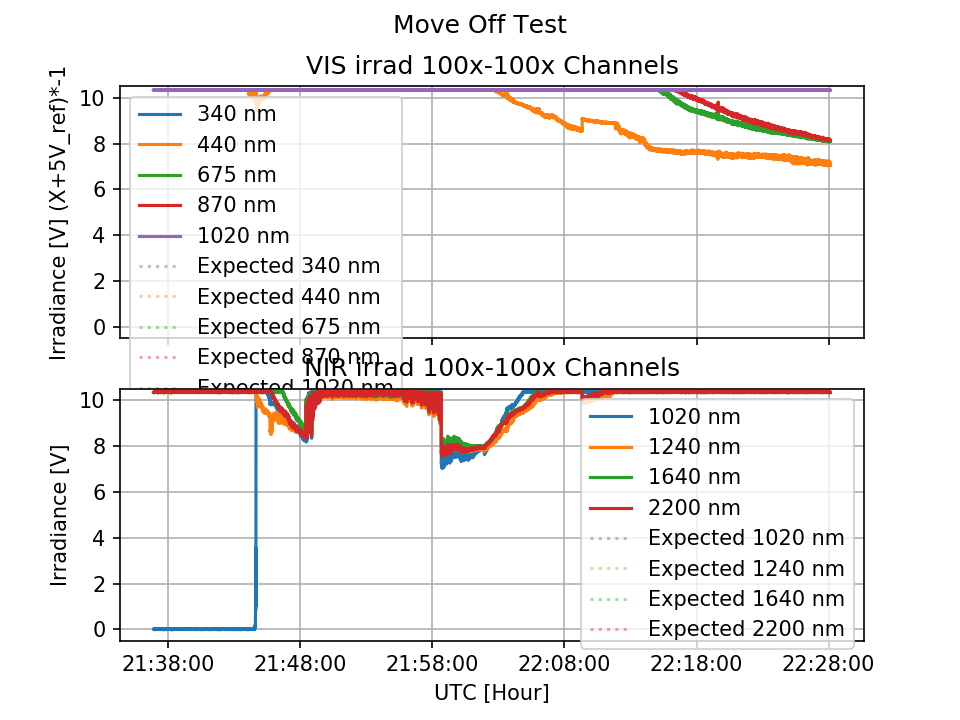

<IPython.core.display.Javascript object>


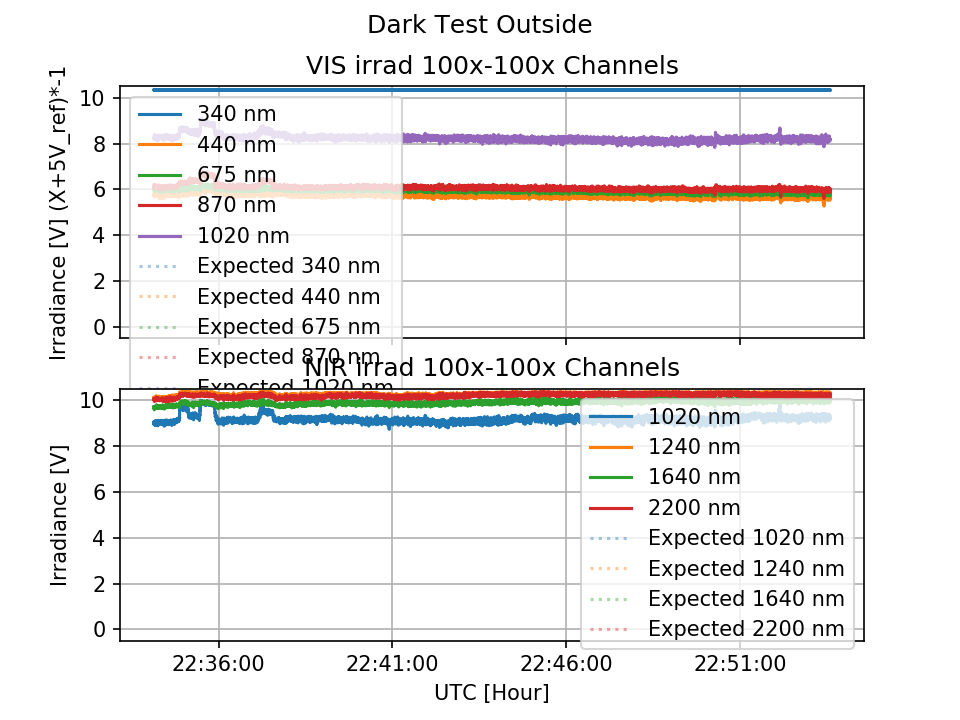

<IPython.core.display.Javascript object>


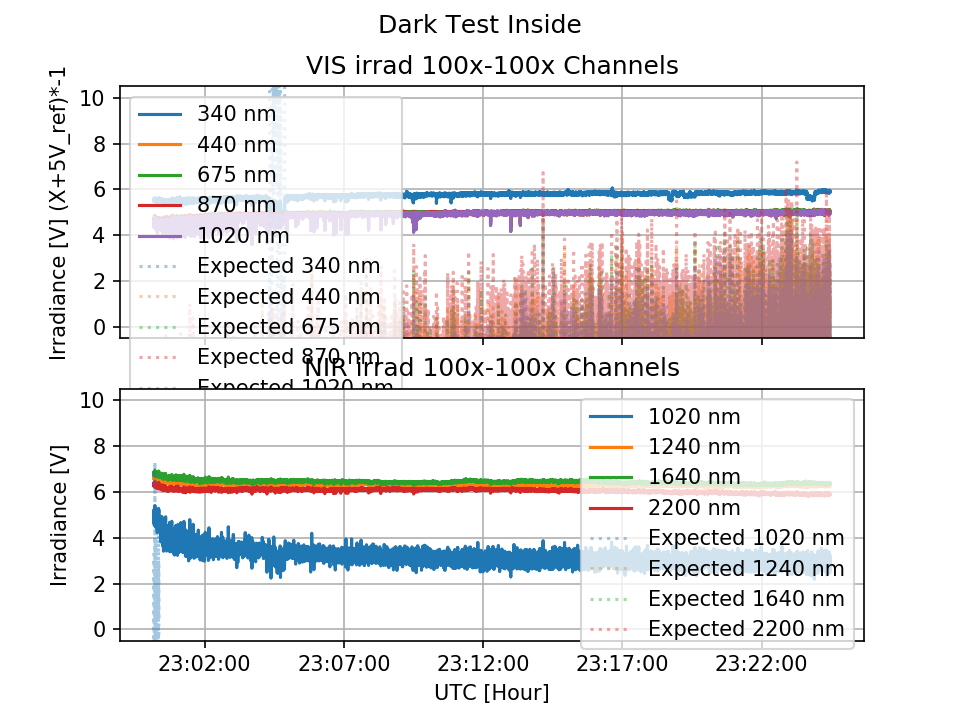

In [59]:
for i,si in enumerate(ss):
    fig,ax = plt.subplots(2,1)
    ax[0].plot(si['UTC'],-si['CH1_4']-si['ref'],label='340 nm')
    ax[0].plot(si['UTC'],-si['CH2_4']-si['ref'],label='440 nm')
    ax[0].plot(si['UTC'],-si['CH3_4']-si['ref'],label='675 nm')
    ax[0].plot(si['UTC'],-si['CH4_4']-si['ref'],label='870 nm')
    ax[0].plot(si['UTC'],-si['CH5_4']-si['ref'],label='1020 nm')

    ax[0].plot(si['UTC'],(-si['CH1_2']-si['ref'])*100.0,label='Expected 340 nm',ls=':',alpha=0.4,c='tab:blue')
    ax[0].plot(si['UTC'],(-si['CH2_2']-si['ref'])*100.0,label='Expected 440 nm',ls=':',alpha=0.4,c='tab:orange')
    ax[0].plot(si['UTC'],(-si['CH3_2']-si['ref'])*100.0,label='Expected 675 nm',ls=':',alpha=0.4,c='tab:green')
    ax[0].plot(si['UTC'],(-si['CH4_2']-si['ref'])*100.0,label='Expected 870 nm',ls=':',alpha=0.4,c='tab:red')
    ax[0].plot(si['UTC'],(-si['CH5_2']-si['ref'])*100.0,label='Expected 1020 nm',ls=':',alpha=0.4,c='tab:purple')

    ax[0].set_title('VIS irrad 100x-100x Channels')
    #ax[0].xlabel('UTC [Hour]')
    ax[0].xaxis.set_major_formatter(myFmt)
    ax[0].set_xticklabels([])
    ax[0].set_ylabel('Irradiance [V] (X+5V_ref)*-1')
    ax[0].grid()
    ax[0].legend(loc=2)
    ax[0].set_ylim(-0.5,10.5)

    ax[1].plot(si['UTC'],-si['CH6_4']-si['ref'],label='1020 nm')
    ax[1].plot(si['UTC'],-si['CH7_4']-si['ref'],label='1240 nm')
    ax[1].plot(si['UTC'],-si['CH8_4']-si['ref'],label='1640 nm')
    ax[1].plot(si['UTC'],-si['CH9_4']-si['ref'],label='2200 nm')

    ax[1].plot(si['UTC'],(-si['CH6_2']-si['ref'])*100.0,label='Expected 1020 nm',ls=':',alpha=0.4,c='tab:blue')
    ax[1].plot(si['UTC'],(-si['CH7_2']-si['ref'])*100.0,label='Expected 1240 nm',ls=':',alpha=0.4,c='tab:orange')
    ax[1].plot(si['UTC'],(-si['CH8_2']-si['ref'])*100.0,label='Expected 1640 nm',ls=':',alpha=0.4,c='tab:green')
    ax[1].plot(si['UTC'],(-si['CH9_2']-si['ref'])*100.0,label='Expected 2200 nm',ls=':',alpha=0.4,c='tab:red')

    ax[1].set_title('NIR irrad 100x-100x Channels')
    ax[1].set_xlabel('UTC [Hour]')
    ax[1].xaxis.set_major_formatter(myFmt)
    ax[1].set_ylabel('Irradiance [V]')
    ax[1].grid()
    ax[1].legend()
    ax[1].set_ylim(-0.5,10.5)

    plt.suptitle(Titles[i])
    plt.savefig(fp+'20201104_rad_test_100x_100x_ref_expect'+Titles[i]+'.png',dpi=600,transparent=True)

<IPython.core.display.Javascript object>


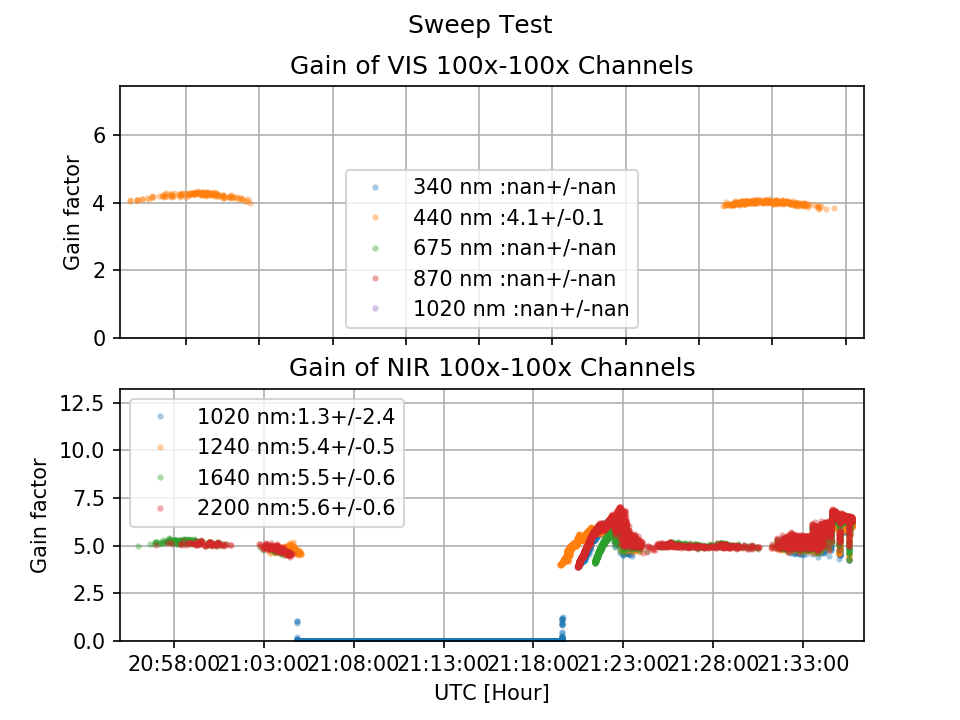

/home/sam/.local/lib/python2.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: Mean of empty slice
  # Remove the CWD from sys.path while we load stuff.
/home/sam/.local/lib/python2.7/site-packages/ipykernel_launcher.py:12: RuntimeWarning: Mean of empty slice
  if sys.path[0] == '':
/home/sam/.local/lib/python2.7/site-packages/ipykernel_launcher.py:13: RuntimeWarning: Mean of empty slice
  del sys.path[0]
/home/sam/.local/lib/python2.7/site-packages/ipykernel_launcher.py:14: RuntimeWarning: Mean of empty slice
  


<IPython.core.display.Javascript object>


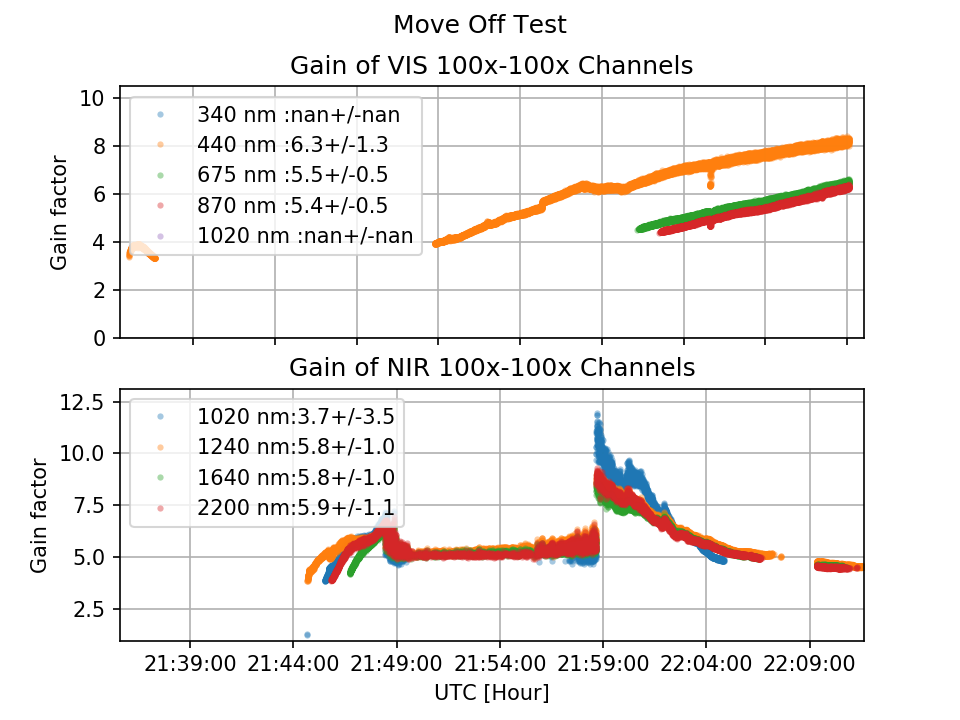

<IPython.core.display.Javascript object>


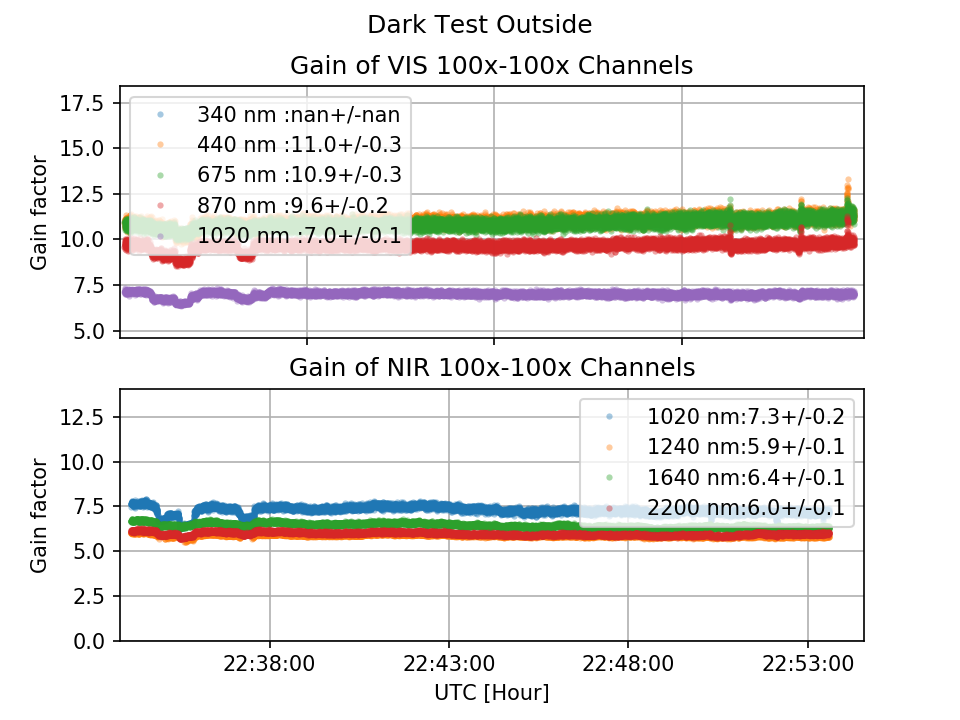

<IPython.core.display.Javascript object>


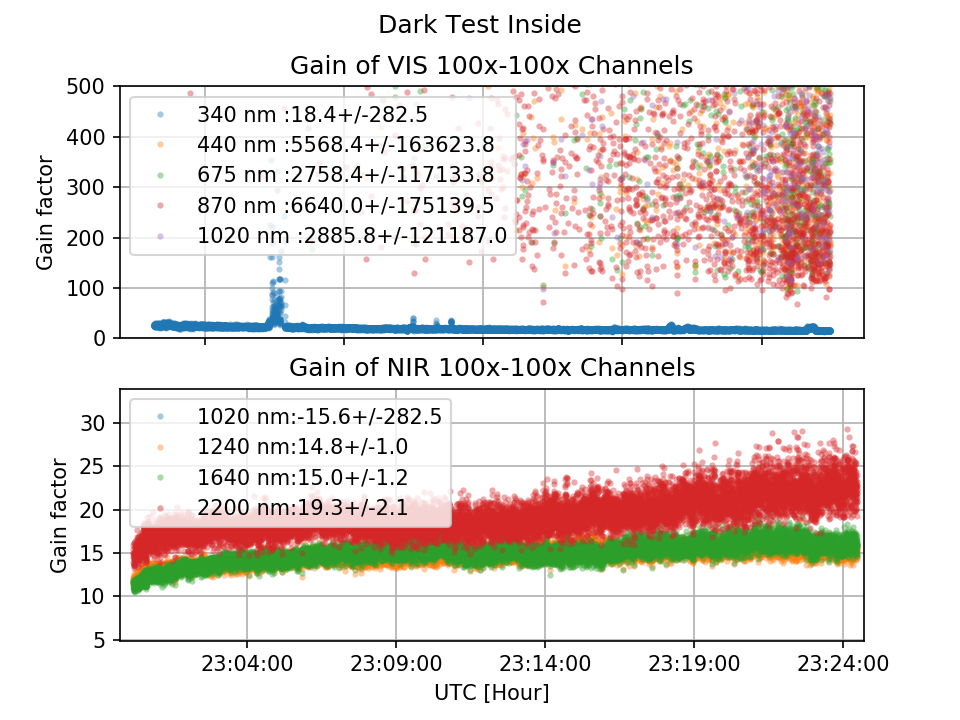

In [62]:
for i,si in enumerate(ss):

    fig,ax = plt.subplots(2,1)
    ig1 = (-si['CH1_4']-si['ref'])<10.3
    ig2 = (-si['CH2_4']-si['ref'])<10.3
    ig3 = (-si['CH3_4']-si['ref'])<10.3
    ig4 = (-si['CH4_4']-si['ref'])<10.3
    ig5 = (-si['CH5_4']-si['ref'])<10.3

    g1 = np.nanmean(((-si['CH1_4']-si['ref'])/(-si['CH1_2']-si['ref']))[ig1])
    g2 = np.nanmean(((-si['CH2_4']-si['ref'])/(-si['CH2_2']-si['ref']))[ig2])
    g3 = np.nanmean(((-si['CH3_4']-si['ref'])/(-si['CH3_2']-si['ref']))[ig3])
    g4 = np.nanmean(((-si['CH4_4']-si['ref'])/(-si['CH4_2']-si['ref']))[ig4])
    g5 = np.nanmean(((-si['CH5_4']-si['ref'])/(-si['CH5_2']-si['ref']))[ig5])

    eg1 = np.nanstd(((-si['CH1_4']-si['ref'])/(-si['CH1_2']-si['ref']))[ig1])
    eg2 = np.nanstd(((-si['CH2_4']-si['ref'])/(-si['CH2_2']-si['ref']))[ig2])
    eg3 = np.nanstd(((-si['CH3_4']-si['ref'])/(-si['CH3_2']-si['ref']))[ig3])
    eg4 = np.nanstd(((-si['CH4_4']-si['ref'])/(-si['CH4_2']-si['ref']))[ig4])
    eg5 = np.nanstd(((-si['CH5_4']-si['ref'])/(-si['CH5_2']-si['ref']))[ig5])

    ax[0].plot(si['UTC'][ig1],((-si['CH1_4']-si['ref'])/(-si['CH1_2']-si['ref']))[ig1],'.',
               label='340 nm :{:3.1f}+/-{:3.1f}'.format(g1,eg1),alpha=0.4,mec='None')
    ax[0].plot(si['UTC'][ig2],((-si['CH2_4']-si['ref'])/(-si['CH2_2']-si['ref']))[ig2],'.',
               label='440 nm :{:3.1f}+/-{:3.1f}'.format(g2,eg2),alpha=0.4,mec='None')
    ax[0].plot(si['UTC'][ig3],((-si['CH3_4']-si['ref'])/(-si['CH3_2']-si['ref']))[ig3],'.',
               label='675 nm :{:3.1f}+/-{:3.1f}'.format(g3,eg3),alpha=0.4,mec='None')
    ax[0].plot(si['UTC'][ig4],((-si['CH4_4']-si['ref'])/(-si['CH4_2']-si['ref']))[ig4],'.',
               label='870 nm :{:3.1f}+/-{:3.1f}'.format(g4,eg4),alpha=0.4,mec='None')
    ax[0].plot(si['UTC'][ig5],((-si['CH5_4']-si['ref'])/(-si['CH5_2']-si['ref']))[ig5],'.',
               label='1020 nm :{:3.1f}+/-{:3.1f}'.format(g5,eg5),alpha=0.4,mec='None')

    ax[0].set_title('Gain of VIS 100x-100x Channels')
    #ax[0].xlabel('UTC [Hour]')
    ax[0].xaxis.set_major_formatter(myFmt)
    ax[0].set_xticklabels([])
    ax[0].set_ylabel('Gain factor')
    ax[0].grid()
    ax[0].legend()
    ax[0].set_ylim(0,500)

    ign1 = ((-si['CH6_4']-si['ref'])<10.3) & ((-si['CH6_4']-si['ref'])>-0.1)
    ign2 = ((-si['CH7_4']-si['ref'])<10.3) & ((-si['CH7_4']-si['ref'])>-0.1)
    ign3 = ((-si['CH8_4']-si['ref'])<10.3) & ((-si['CH8_4']-si['ref'])>-0.1)
    ign4 = ((-si['CH9_4']-si['ref'])<10.3) & ((-si['CH9_4']-si['ref'])>-0.1)

    gn1 = np.nanmean(((-si['CH6_4']-si['ref'])/(-si['CH6_2']-si['ref']))[ign1])
    gn2 = np.nanmean(((-si['CH7_4']-si['ref'])/(-si['CH7_2']-si['ref']))[ign2])
    gn3 = np.nanmean(((-si['CH8_4']-si['ref'])/(-si['CH8_2']-si['ref']))[ign3])
    gn4 = np.nanmean(((-si['CH9_4']-si['ref'])/(-si['CH9_2']-si['ref']))[ign4])

    egn1 = np.nanstd(((-si['CH6_4']-si['ref'])/(-si['CH6_2']-si['ref']))[ign1])
    egn2 = np.nanstd(((-si['CH7_4']-si['ref'])/(-si['CH7_2']-si['ref']))[ign2])
    egn3 = np.nanstd(((-si['CH8_4']-si['ref'])/(-si['CH8_2']-si['ref']))[ign3])
    egn4 = np.nanstd(((-si['CH9_4']-si['ref'])/(-si['CH9_2']-si['ref']))[ign4])

    ax[1].plot(si['UTC'][ign1],((-si['CH6_4']-si['ref'])/(-si['CH6_2']-si['ref']))[ign1],'.',
               label='1020 nm:{:3.1f}+/-{:3.1f}'.format(gn1,egn1),alpha=0.4,mec='None')
    ax[1].plot(si['UTC'][ign2],((-si['CH7_4']-si['ref'])/(-si['CH7_2']-si['ref']))[ign2],'.',
               label='1240 nm:{:3.1f}+/-{:3.1f}'.format(gn2,egn2),alpha=0.4,mec='None')
    ax[1].plot(si['UTC'][ign3],((-si['CH8_4']-si['ref'])/(-si['CH8_2']-si['ref']))[ign3],'.',
               label='1640 nm:{:3.1f}+/-{:3.1f}'.format(gn3,egn3),alpha=0.4,mec='None')
    ax[1].plot(si['UTC'][ign4],((-si['CH9_4']-si['ref'])/(-si['CH9_2']-si['ref']))[ign4],'.',
               label='2200 nm:{:3.1f}+/-{:3.1f}'.format(gn4,egn4),alpha=0.4,mec='None')

    ax[1].set_title('Gain of NIR 100x-100x Channels')
    ax[1].set_xlabel('UTC [Hour]')
    ax[1].xaxis.set_major_formatter(myFmt)
    ax[1].set_ylabel('Gain factor')
    ax[1].grid()
    ax[1].legend()
    ax[1].set_ylim(0,500)

    plt.suptitle(Titles[i])
    plt.savefig(fp+'20201104_rad_test_gainof100x_100x'+Titles[i]+'.png',dpi=600,transparent=True)

## Just voltages

<IPython.core.display.Javascript object>


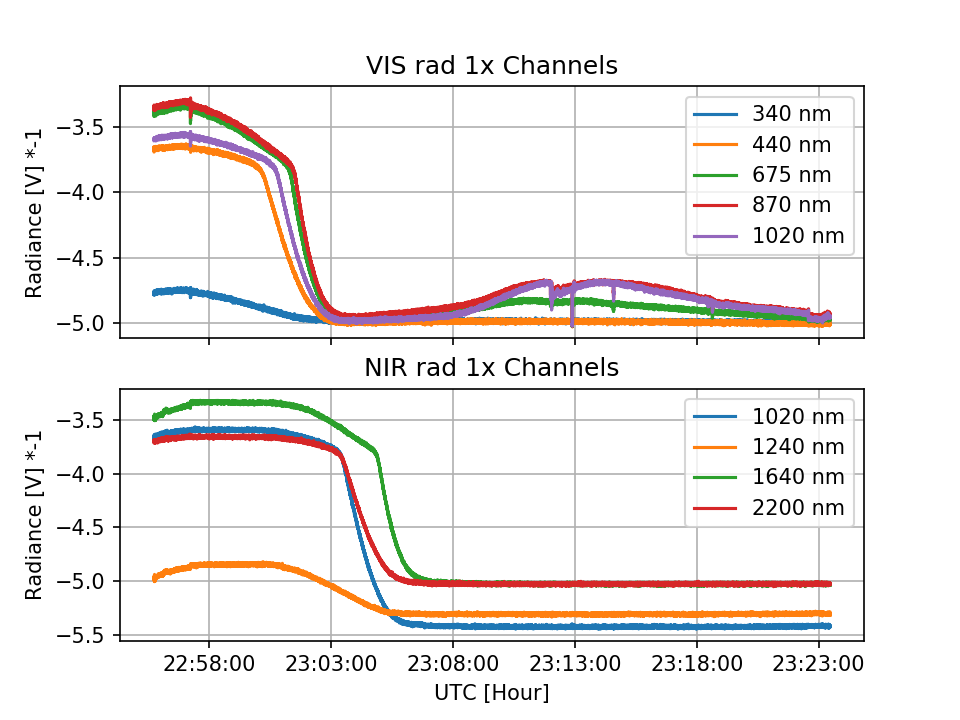

In [38]:
fig,ax = plt.subplots(2,1)
ax[0].plot(s['UTC'],s['CH1_0']*-1.0,label='340 nm')
ax[0].plot(s['UTC'],s[' CH2_0']*-1.0,label='440 nm')
ax[0].plot(s['UTC'],s[' CH3_0']*-1.0,label='675 nm')
ax[0].plot(s['UTC'],s[' CH4_0']*-1.0,label='870 nm')
ax[0].plot(s['UTC'],s[' CH5_0']*-1.0,label='1020 nm')
ax[0].set_title('VIS rad 1x Channels')
#ax[0].set_xlabel('UTC [Hour]')
ax[0].xaxis.set_major_formatter(myFmt)
ax[0].set_xticklabels([])
ax[0].set_ylabel('Radiance [V] *-1')
ax[0].grid()
ax[0].legend()

ax[1].plot(s['UTC'],s[' CH6_0']*-1.0,label='1020 nm')
ax[1].plot(s['UTC'],s[' CH7_0']*-1.0,label='1240 nm')
ax[1].plot(s['UTC'],s[' CH8_0']*-1.0,label='1640 nm')
ax[1].plot(s['UTC'],s[' CH9_0']*-1.0,label='2200 nm')
ax[1].set_title('NIR rad 1x Channels')
ax[1].set_xlabel('UTC [Hour]')
ax[1].xaxis.set_major_formatter(myFmt)
ax[1].set_ylabel('Radiance [V] *-1')
ax[1].grid()
ax[1].legend()

plt.savefig(fp+'2020101622_rad_test_1x.png',dpi=600,transparent=True)

<IPython.core.display.Javascript object>


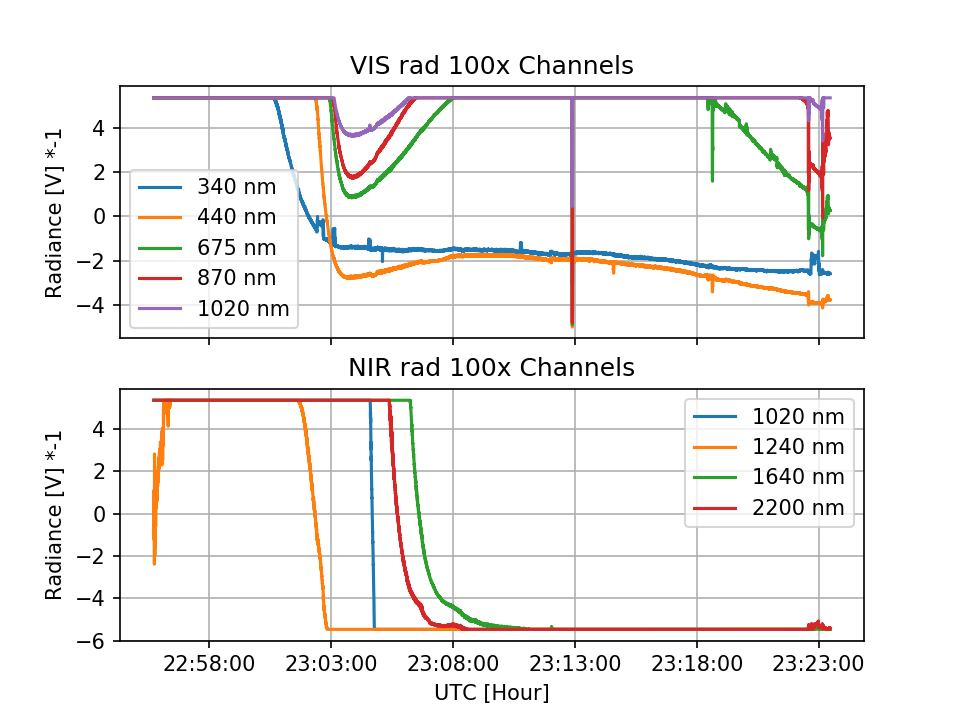

In [36]:
fig,ax = plt.subplots(2,1)
ax[0].plot(s['UTC'],s[' CH1_2']*-1.0,label='340 nm')
ax[0].plot(s['UTC'],s[' CH2_2']*-1.0,label='440 nm')
ax[0].plot(s['UTC'],s[' CH3_2']*-1.0,label='675 nm')
ax[0].plot(s['UTC'],s[' CH4_2']*-1.0,label='870 nm')
ax[0].plot(s['UTC'],s[' CH5_2']*-1.0,label='1020 nm')
ax[0].set_title('VIS rad 100x Channels')
#ax[0].xlabel('UTC [Hour]')
ax[0].xaxis.set_major_formatter(myFmt)
ax[0].set_xticklabels([])
ax[0].set_ylabel('Radiance [V] *-1')
ax[0].grid()
ax[0].legend()

ax[1].plot(s['UTC'],s[' CH6_2']*-1.0,label='1020 nm')
ax[1].plot(s['UTC'],s[' CH7_2']*-1.0,label='1240 nm')
ax[1].plot(s['UTC'],s[' CH8_2']*-1.0,label='1640 nm')
ax[1].plot(s['UTC'],s[' CH9_2']*-1.0,label='2200 nm')
ax[1].set_title('NIR rad 100x Channels')
ax[1].set_xlabel('UTC [Hour]')
ax[1].xaxis.set_major_formatter(myFmt)
ax[1].set_ylabel('Radiance [V] *-1')
ax[1].grid()
ax[1].legend()

plt.savefig(fp+'2020101622_rad_test_100x.png',dpi=600,transparent=True)

<IPython.core.display.Javascript object>


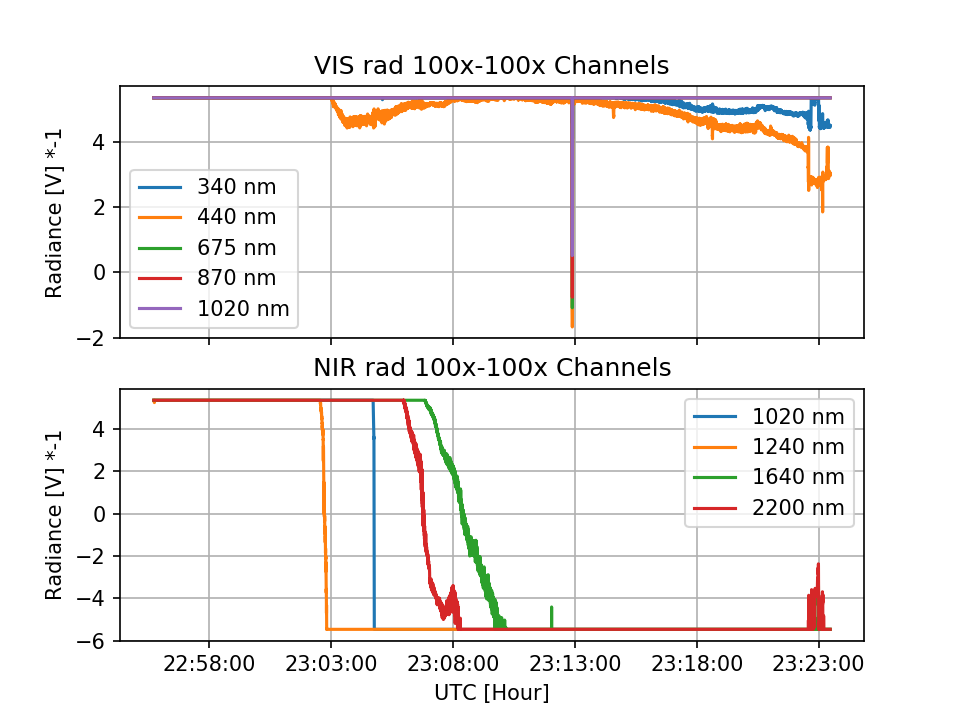

In [37]:
fig,ax = plt.subplots(2,1)
ax[0].plot(s['UTC'],s[' CH1_4']*-1.0,label='340 nm')
ax[0].plot(s['UTC'],s[' CH2_4']*-1.0,label='440 nm')
ax[0].plot(s['UTC'],s[' CH3_4']*-1.0,label='675 nm')
ax[0].plot(s['UTC'],s[' CH4_4']*-1.0,label='870 nm')
ax[0].plot(s['UTC'],s[' CH5_4']*-1.0,label='1020 nm')
ax[0].set_title('VIS rad 100x-100x Channels')
#ax[0].xlabel('UTC [Hour]')
ax[0].xaxis.set_major_formatter(myFmt)
ax[0].set_xticklabels([])
ax[0].set_ylabel('Radiance [V] *-1')
ax[0].grid()
ax[0].legend()

ax[1].plot(s['UTC'],s[' CH6_4']*-1.0,label='1020 nm')
ax[1].plot(s['UTC'],s[' CH7_4']*-1.0,label='1240 nm')
ax[1].plot(s['UTC'],s[' CH8_4']*-1.0,label='1640 nm')
ax[1].plot(s['UTC'],s[' CH9_4']*-1.0,label='2200 nm')
ax[1].set_title('NIR rad 100x-100x Channels')
ax[1].set_xlabel('UTC [Hour]')
ax[1].xaxis.set_major_formatter(myFmt)
ax[1].set_ylabel('Radiance [V] *-1')
ax[1].grid()
ax[1].legend()

plt.savefig(fp+'2020101622_rad_test_100x_100x.png',dpi=600,transparent=True)

## Plot out test 2020-11-17, with new functions

<IPython.core.display.Javascript object>


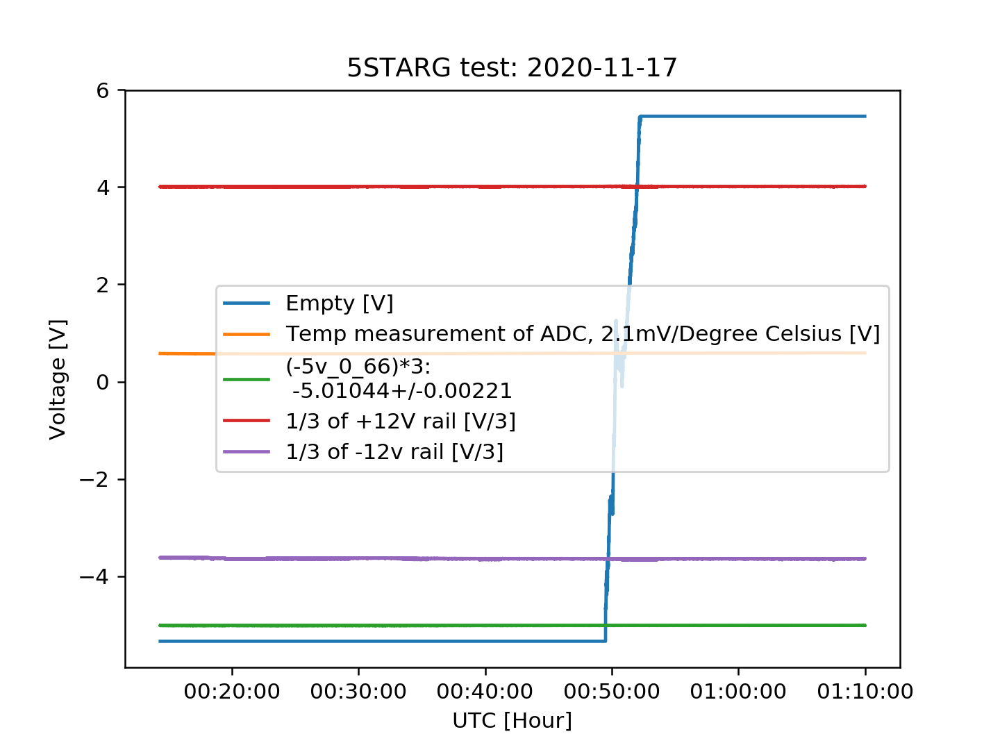

<IPython.core.display.Javascript object>


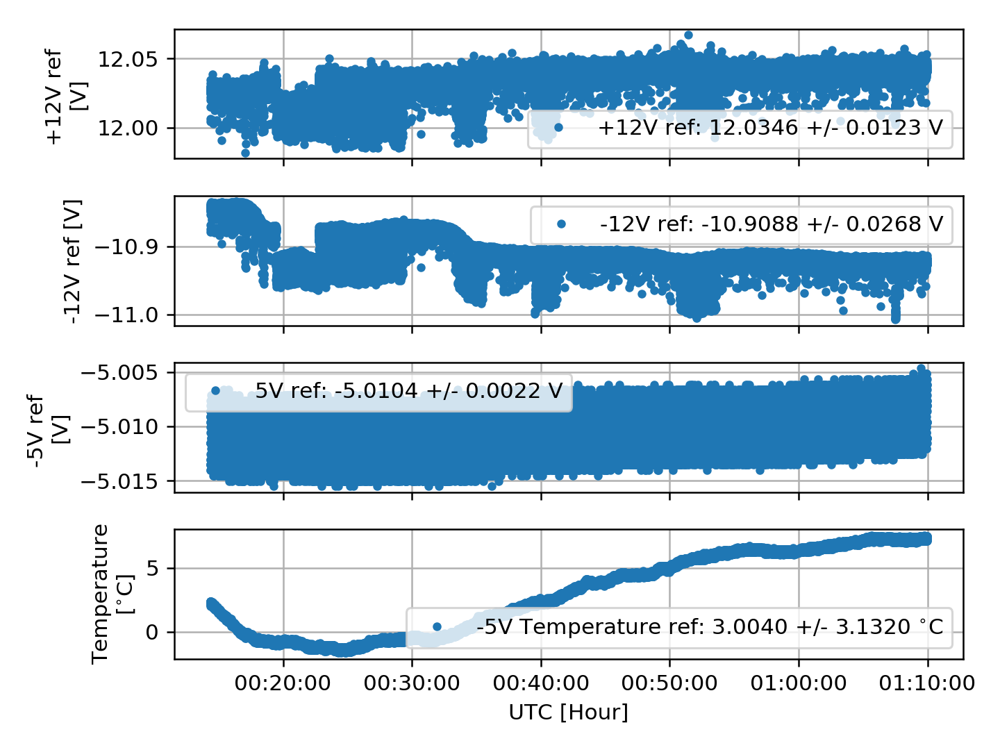

In [176]:
fig = plot_housekeeping(s)
fig[0].gca().set_title('5STARG test: 2020-11-17')
fig[0].savefig(fp+'5STARG_20201117_Housekeeping.png',dpi=600,transparent=True)

<IPython.core.display.Javascript object>


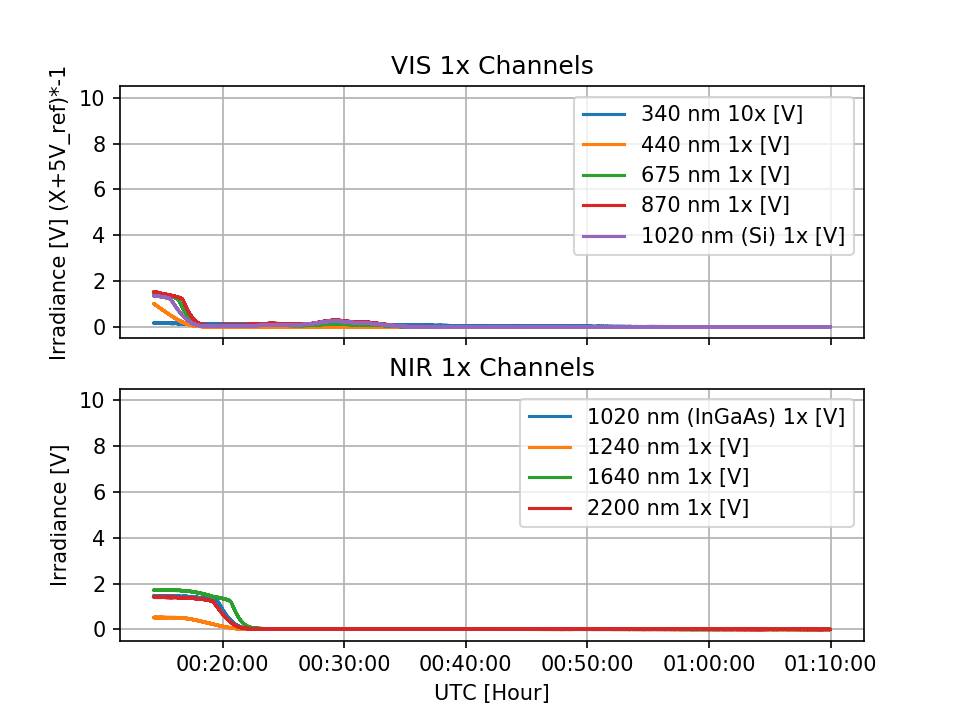

In [121]:
fig,ax = plot_v(s,gain=0)
#plt.title('5STARG radiometers 1x 2020-11-17')
fig.savefig(fp+'5STARG_20201117_rad_1x.png',dpi=600,transparent=True)

<IPython.core.display.Javascript object>


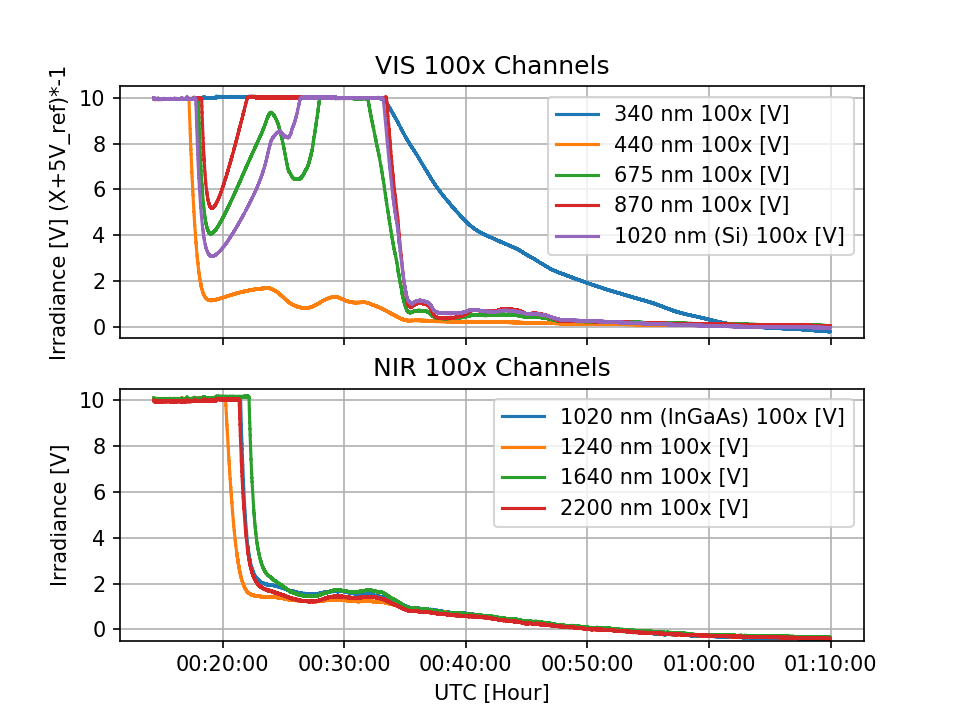

In [122]:
fig,ax = plot_v(s,gain=1)
#plt.title('5STARG radiometers 1x 2020-11-17')
fig.savefig(fp+'5STARG_20201117_rad_100x.png',dpi=600,transparent=True)

<IPython.core.display.Javascript object>


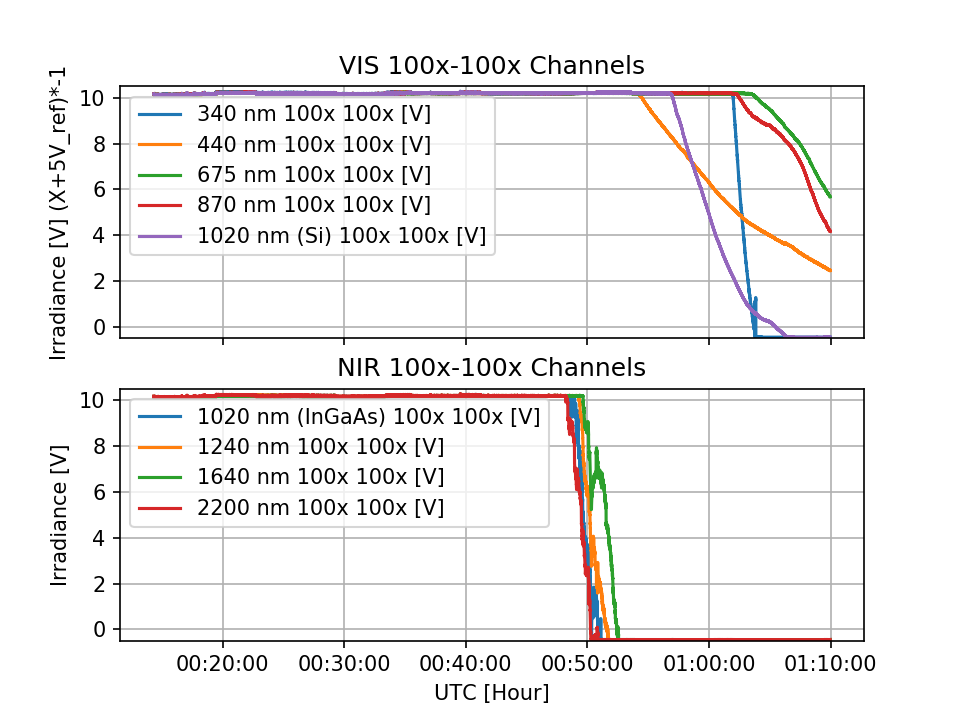

In [123]:
fig,ax = plot_v(s,gain=2)
#plt.title('5STARG radiometers 1x 2020-11-17')
fig.savefig(fp+'5STARG_20201117_rad_100x_100x.png',dpi=600,transparent=True)

<IPython.core.display.Javascript object>


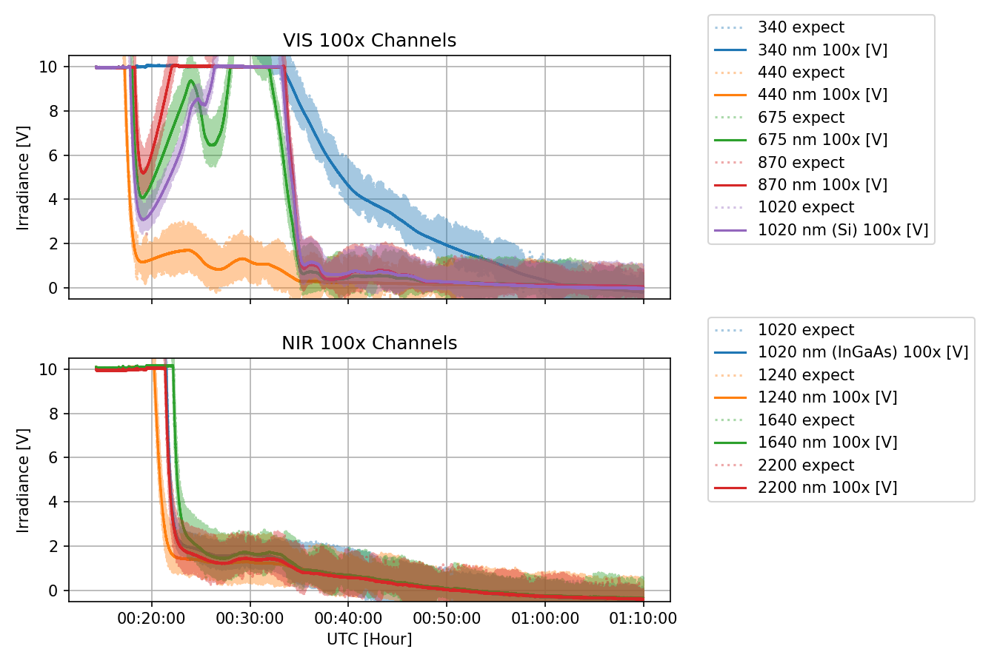

In [135]:
fig,ax = plot_v_expect(s,gain=0)
#plt.title('5STARG radiometers 1x 2020-11-17')
fig.savefig(fp+'5STARG_20201117_rad_100x_expect.png',dpi=600,transparent=True)

<IPython.core.display.Javascript object>


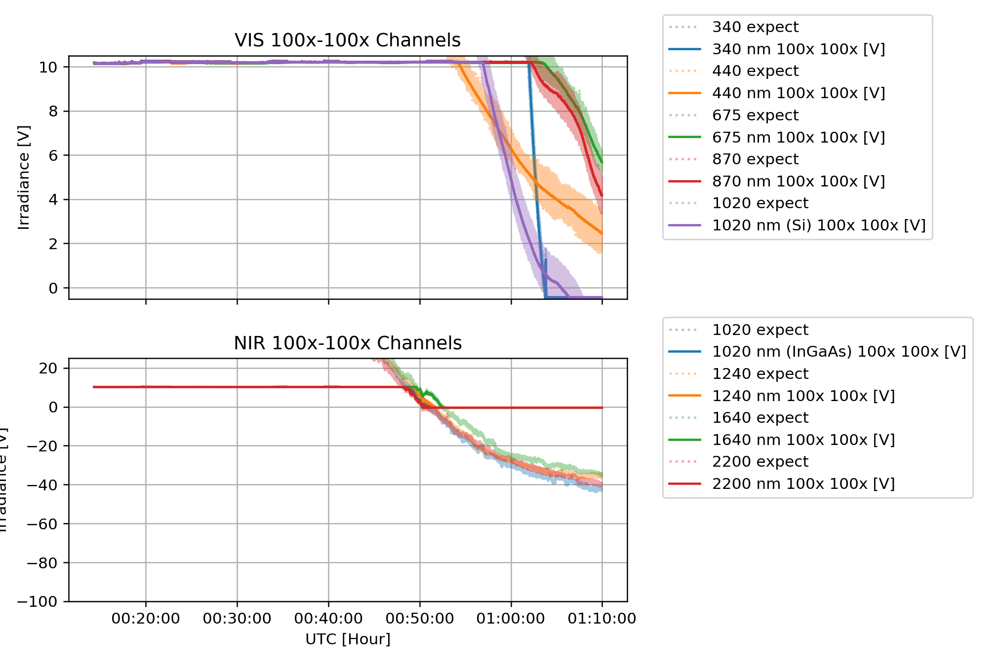

(-100, 25)

In [158]:
fig,ax = plot_v_expect(s,gain=1)
#plt.title('5STARG radiometers 1x 2020-11-17')
ax[1].set_ylim(-100,25)
#fig.savefig(fp+'5STARG_20201117_rad_100x_100x_expect.png',dpi=600,transparent=True)

## Plot out Test 2021-01-14

<IPython.core.display.Javascript object>


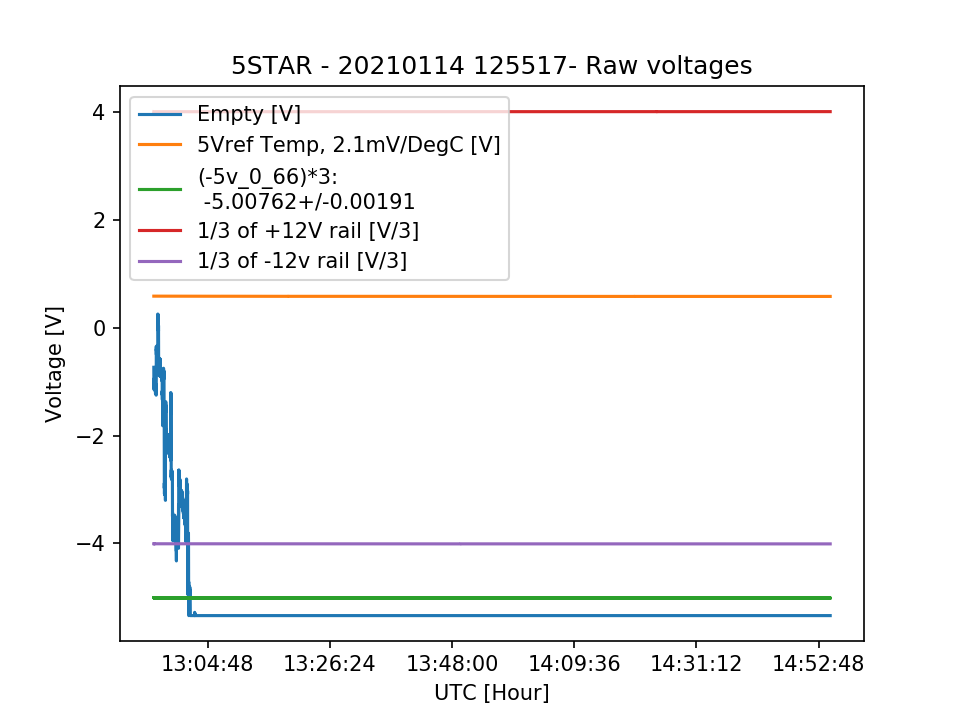

<IPython.core.display.Javascript object>


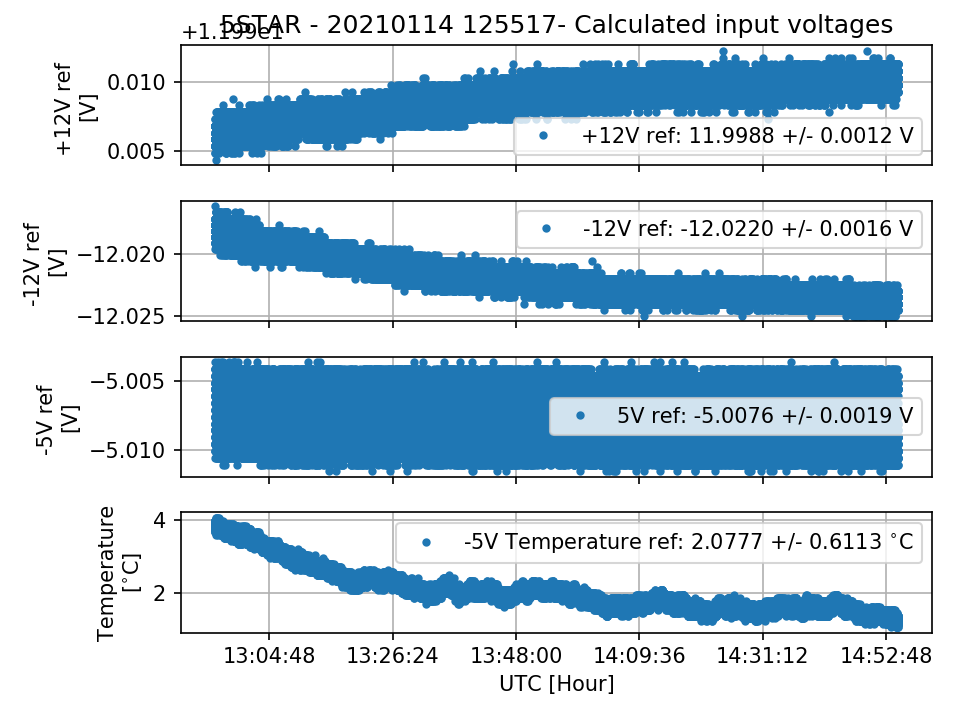

In [125]:
fig = plot_housekeeping(s)
fig[0].savefig(fp+'{s.instname}_{s.daystr}_Housekeeping.png'.format(s=s),dpi=600,transparent=True)
fig[1].savefig(fp+'{s.instname}_{s.daystr}_Housekeeping_inputV.png'.format(s=s),dpi=600,transparent=True)

<IPython.core.display.Javascript object>


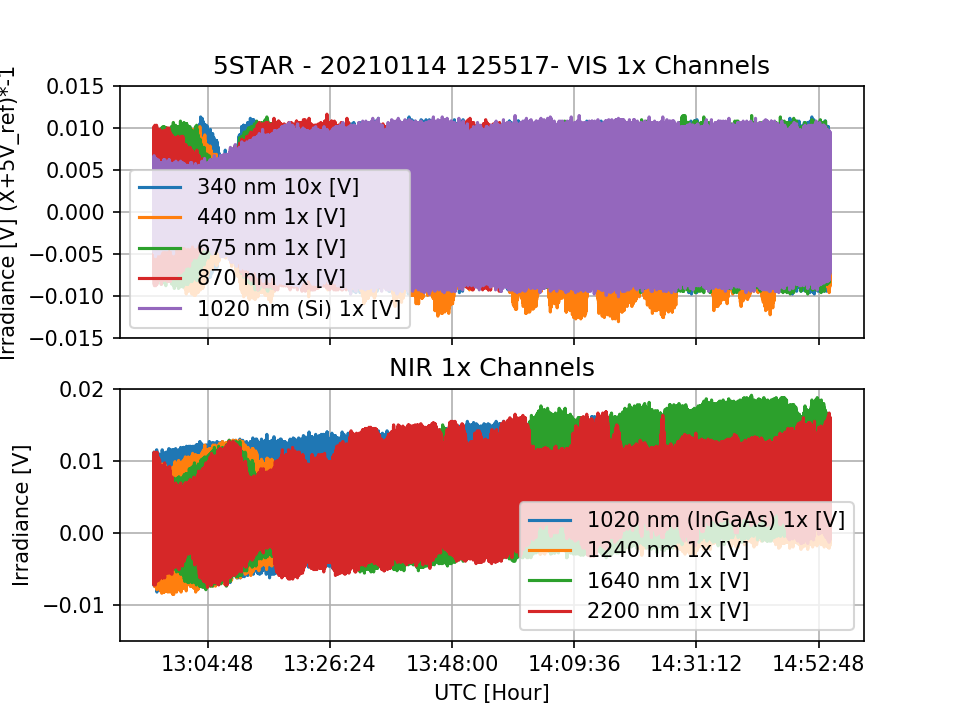

In [131]:
fig,ax = plot_v(s,gain=0)
ax[0].set_ylim(-0.015,0.015)
ax[1].set_ylim(-0.015,0.02)
fig.savefig(fp+'{s.instname}_{s.daystr}_rad_1x.png'.format(s=s),dpi=600,transparent=True)

<IPython.core.display.Javascript object>


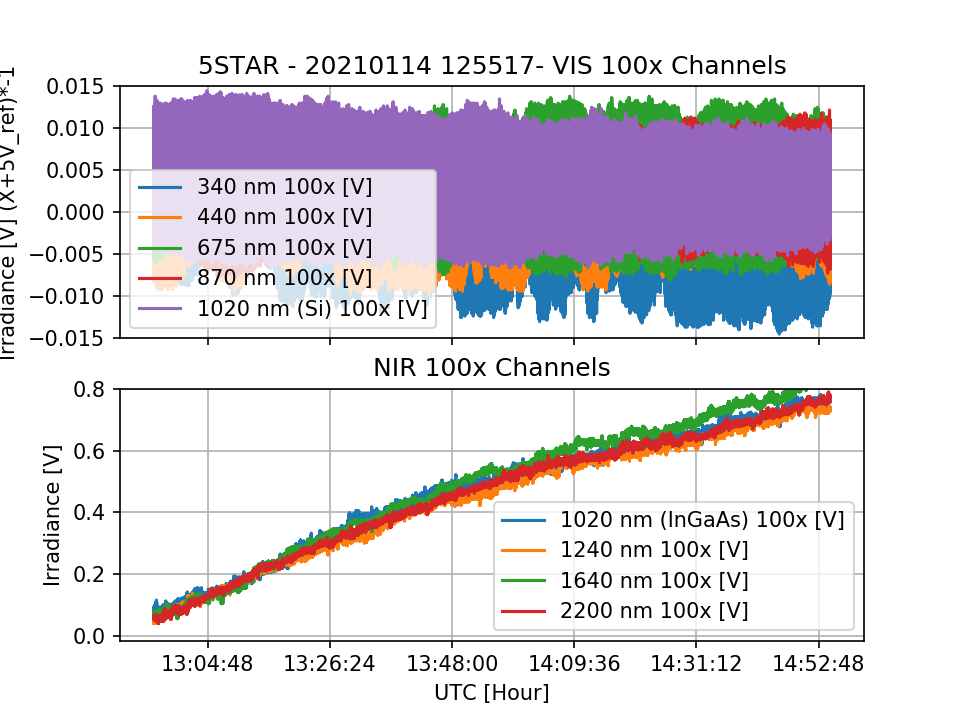

In [136]:
fig,ax = plot_v(s,gain=1)
ax[0].set_ylim(-0.015,0.015)
ax[1].set_ylim(-0.015,0.8)
fig.savefig(fp+'{s.instname}_{s.daystr}_rad_100x.png'.format(s=s),dpi=600,transparent=True)

<IPython.core.display.Javascript object>


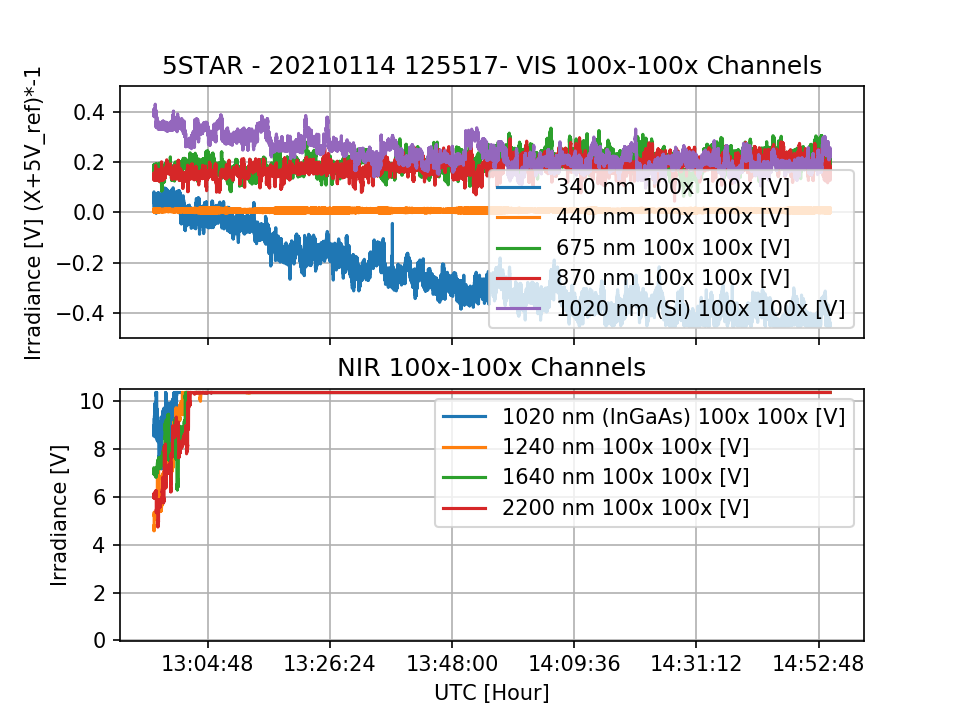

In [141]:
fig,ax = plot_v(s,gain=2)
ax[0].set_ylim(-0.5,0.5)
ax[1].set_ylim(-0.015,10.5)
fig.savefig(fp+'{s.instname}_{s.daystr}_rad_100x_100x.png'.format(s=s),dpi=600,transparent=True)

<IPython.core.display.Javascript object>


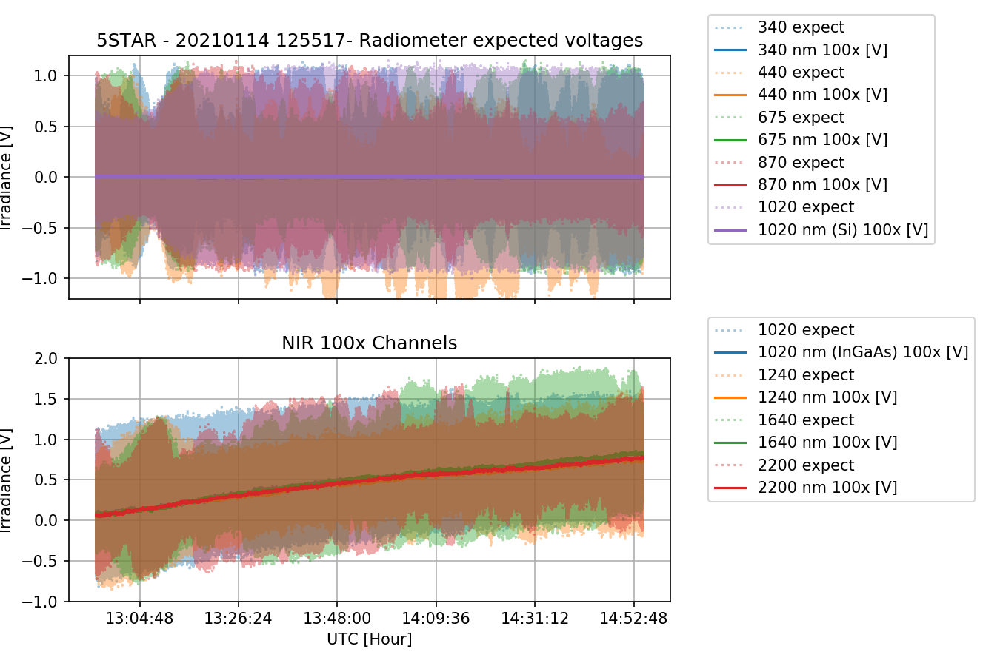

In [143]:
fig,ax = plot_v_expect(s,gain=0)
#plt.title('5STARG radiometers 1x 2020-11-17')
ax[0].set_ylim(-1.2,1.2)
ax[1].set_ylim(-1.0,2.0)
fig.savefig(fp+'{s.instname}_{s.daystr}_rad_100x_expect.png'.format(s=s),dpi=600,transparent=True)

<IPython.core.display.Javascript object>


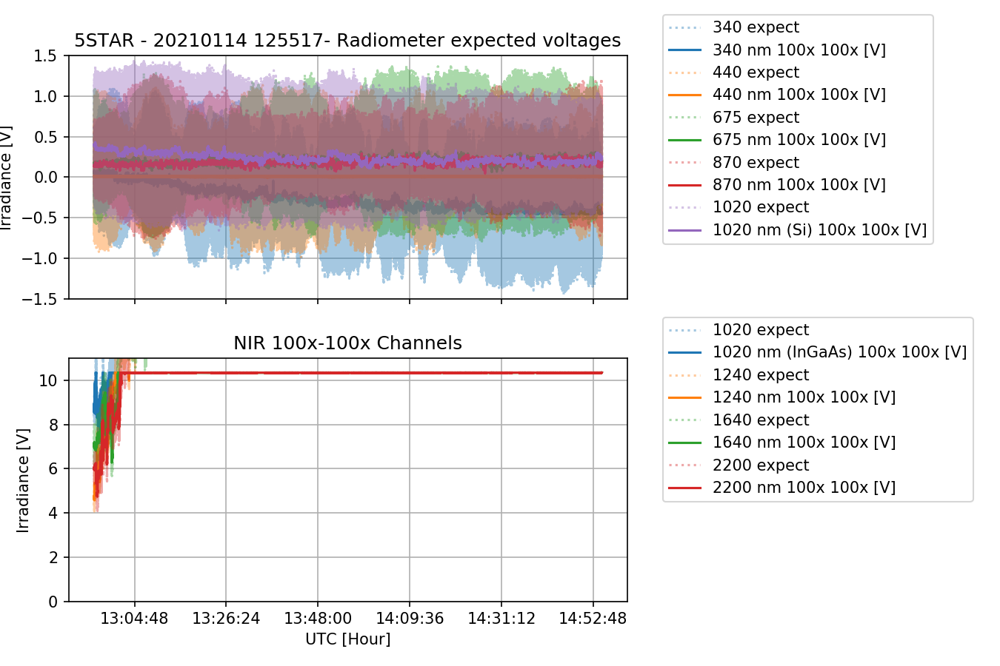

In [145]:
fig,ax = plot_v_expect(s,gain=1)
#plt.title('5STARG radiometers 1x 2020-11-17')
ax[0].set_ylim(-1.5,1.5)
ax[1].set_ylim(0,11.0)
fig.savefig(fp+'{s.instname}_{s.daystr}_rad_100x_100x_expect.png'.format(s=s),dpi=600,transparent=True)

### Checkout the 440 nm

<IPython.core.display.Javascript object>


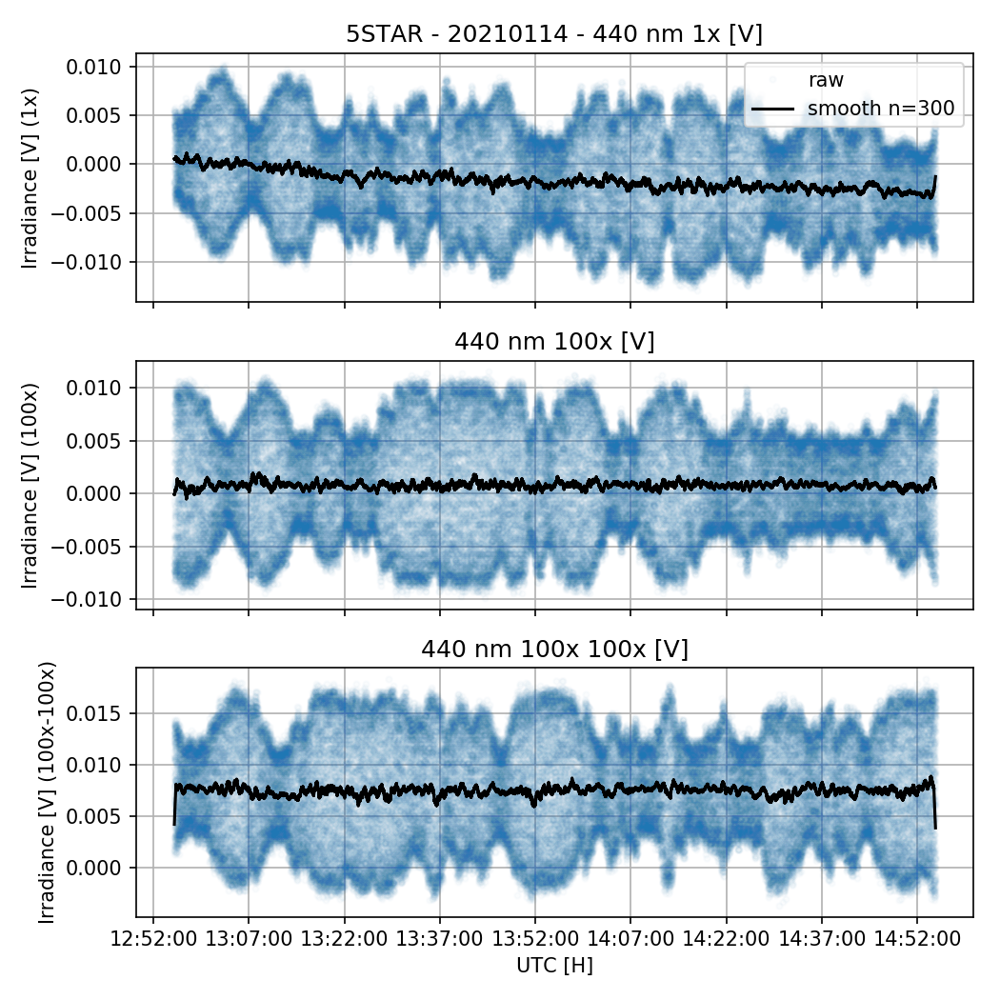

In [181]:
from Sp_parameters import smooth
myFmt = mdates.DateFormatter('%H:%M:%S')
fig,ax = plt.subplots(3,1,sharex=True,figsize=(7,7))

cs = ['tab:blue','tab:orange','tab:green','tab:red','tab:purple']

u,u1,u2 = 'V2_0','V2_2','V2_4'
ns = 300
ax[0].plot(s['UTC'],s[u],'.',label='raw',c=cs[iu],alpha=0.02)
ax[0].plot(s['UTC'],smooth(s[u],ns,old=True),'-',label='smooth n={}'.format(ns),c='k')
ax[0].legend()
ax[1].plot(s['UTC'],s[u1],'.',label=s[u1].name,c=cs[iu],alpha=0.02)
ax[1].plot(s['UTC'],smooth(s[u1],ns,old=True),'-',label='smooth n={}'.format(ns),c='k')
ax[2].plot(s['UTC'],s[u2],'.',label=s[u1].name,c=cs[iu],alpha=0.02)
ax[2].plot(s['UTC'],smooth(s[u2],ns,old=True),'-',label='smooth n={}'.format(ns),c='k')

ax[0].set_title('{s.instname} - {s.daystr} - {u.name}'.format(u=s[u],s=s))
ax[1].set_title('{u.name}'.format(u=s[u1]))
ax[2].set_title('{u.name}'.format(u=s[u2]))
ax[2].xaxis.set_major_formatter(myFmt)
#ax[2].set_xticklabels([])
ax[0].set_ylabel('Irradiance [V] (1x)')
ax[1].set_ylabel('Irradiance [V] (100x)')
ax[2].set_ylabel('Irradiance [V] (100x-100x)')
ax[2].set_xlabel('UTC [H]')
ax[0].grid()
ax[1].grid()
ax[2].grid()
plt.tight_layout()

fig.savefig(fp+'{s.instname}_{s.daystr}_rad_440nm_allch.png'.format(s=s),dpi=600,transparent=True)

<IPython.core.display.Javascript object>


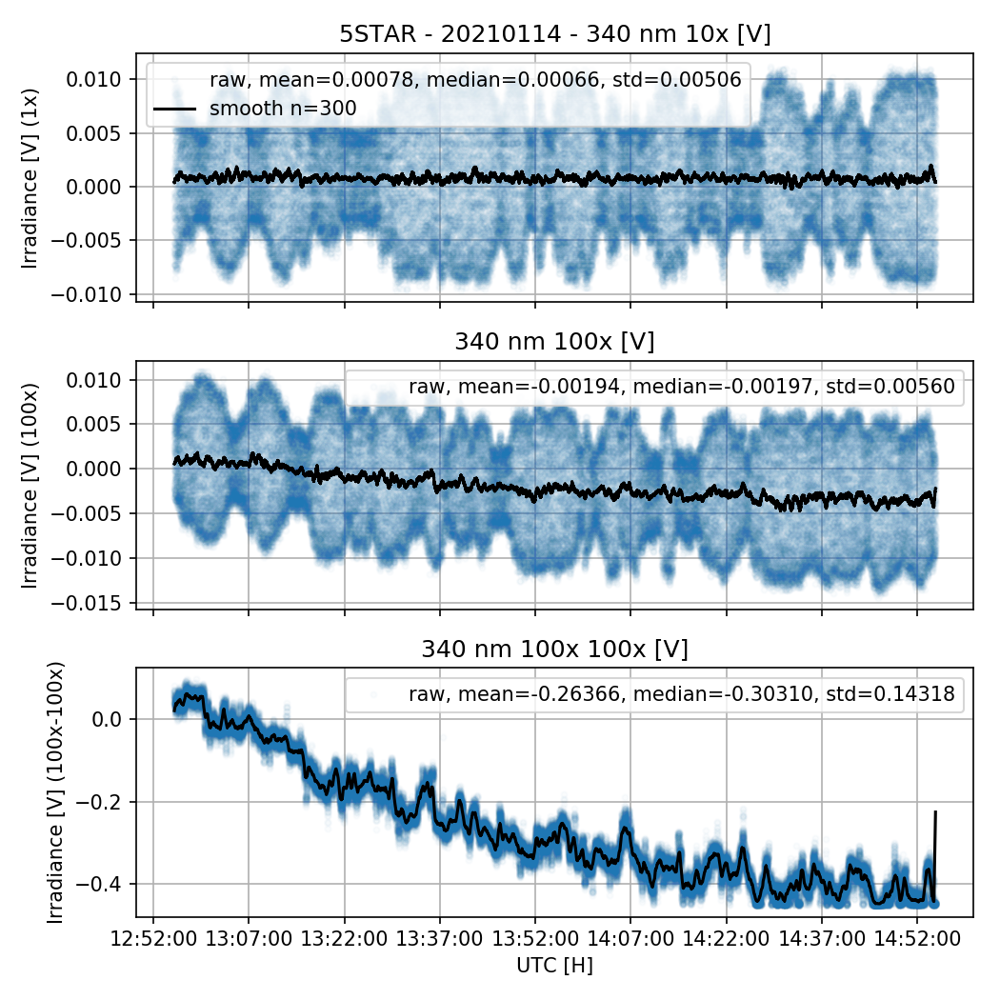

<IPython.core.display.Javascript object>


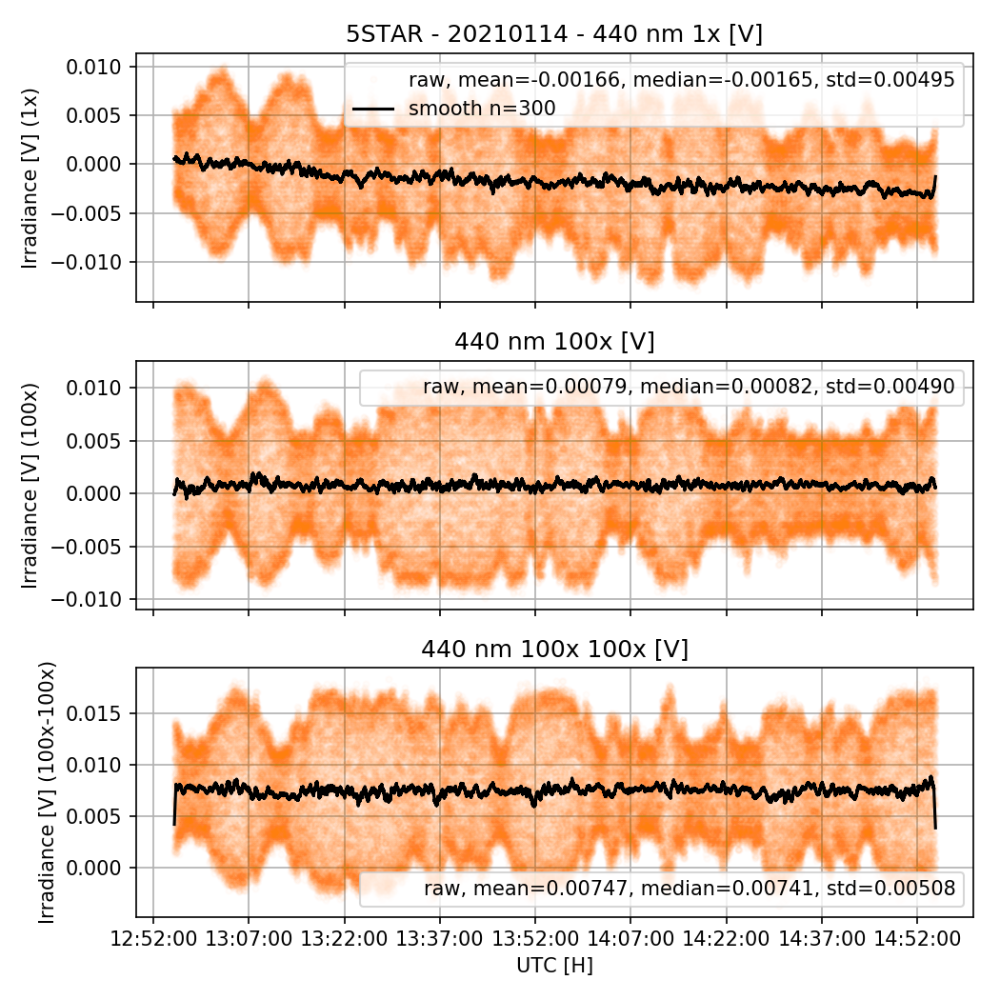

<IPython.core.display.Javascript object>


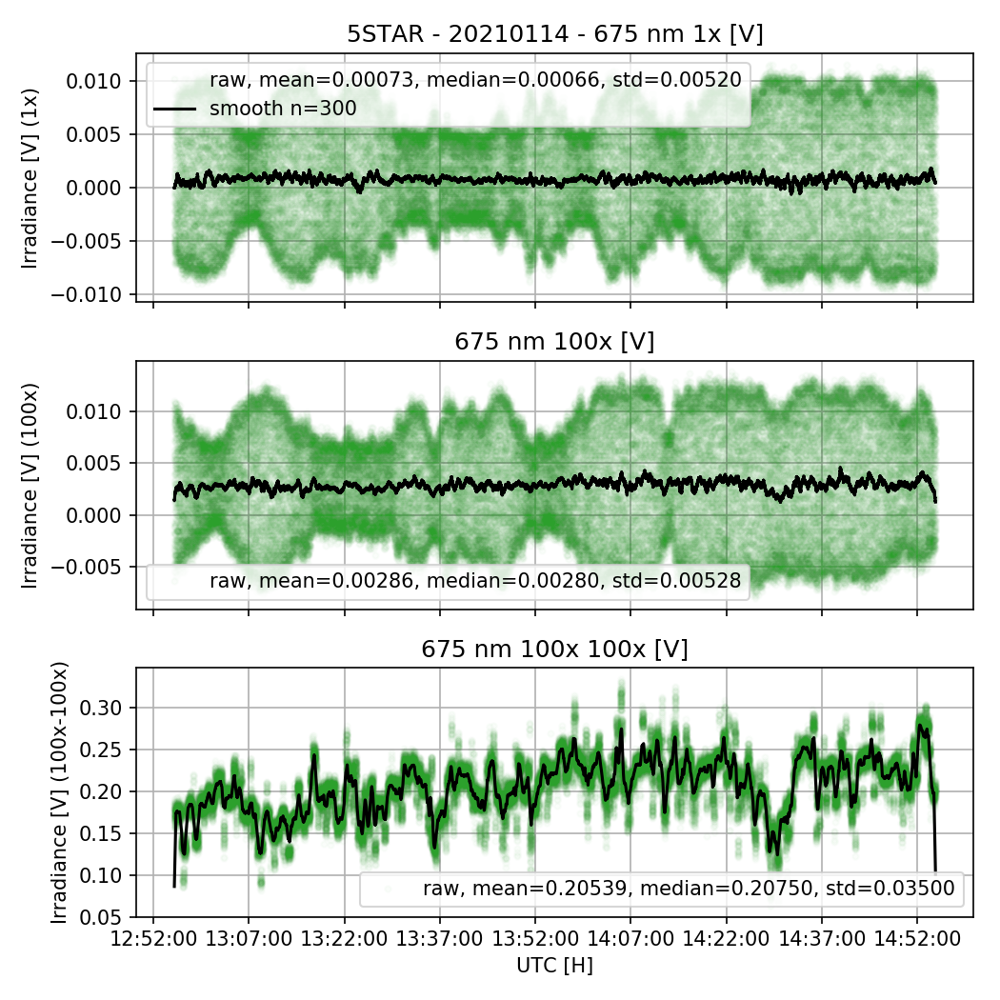

<IPython.core.display.Javascript object>


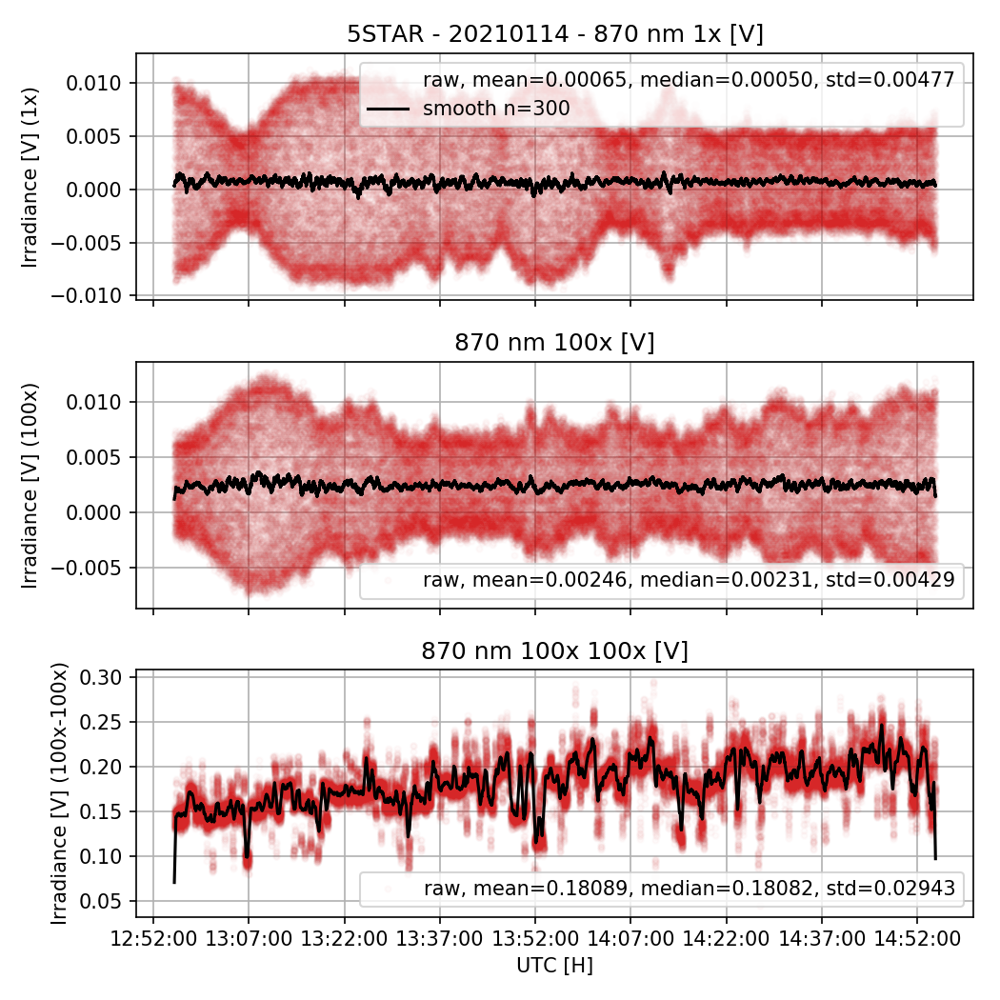

<IPython.core.display.Javascript object>


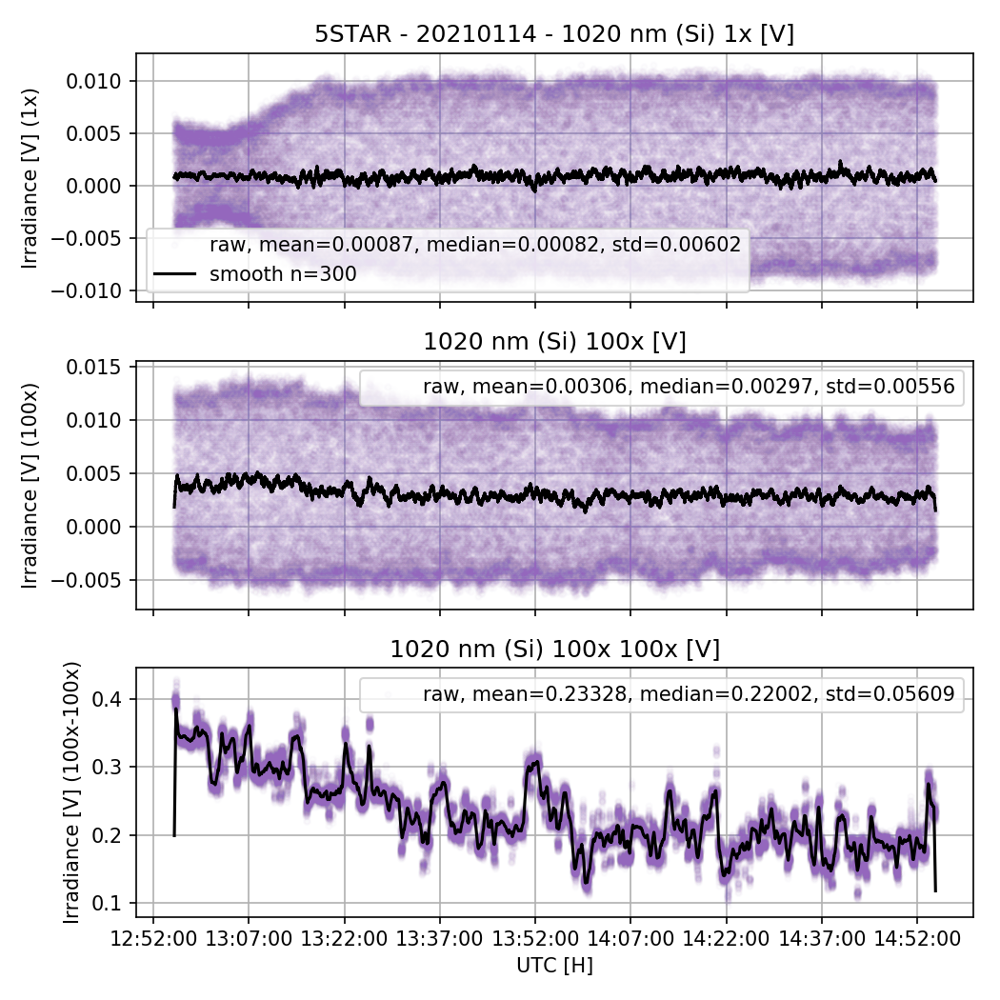

<IPython.core.display.Javascript object>


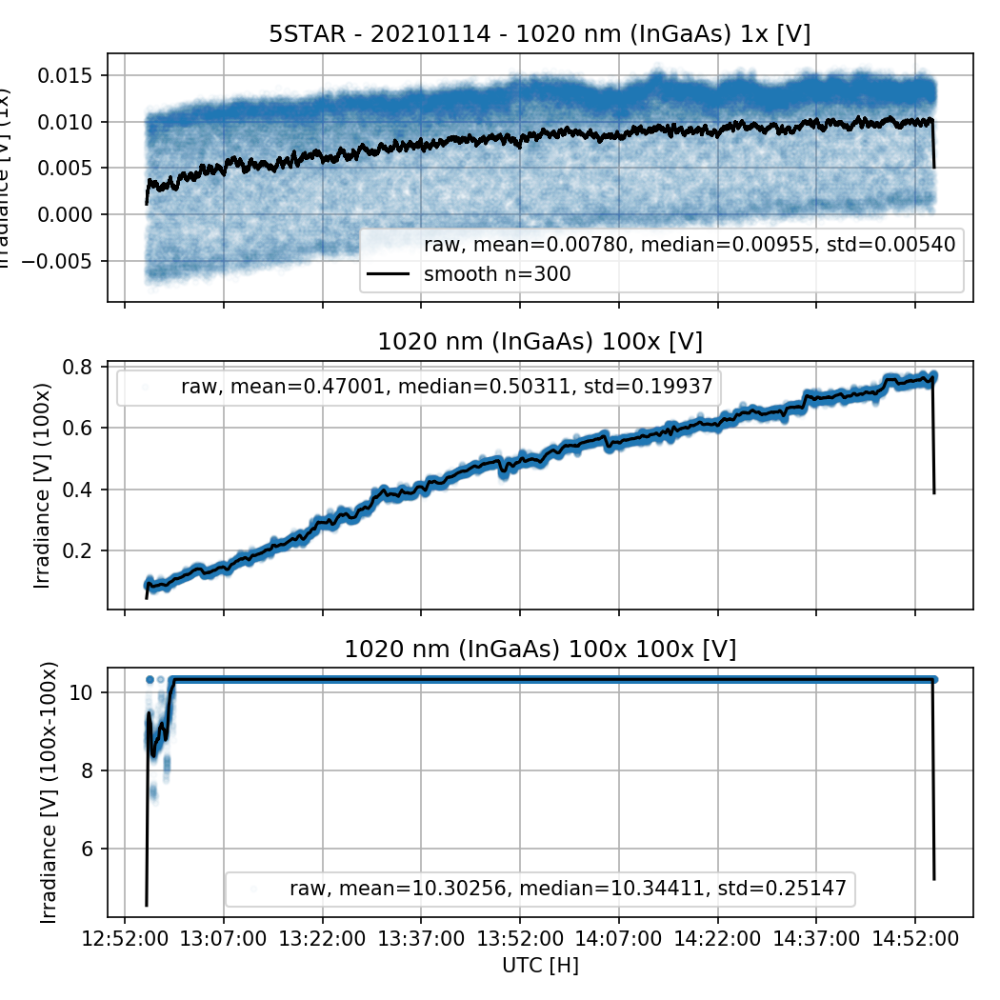

<IPython.core.display.Javascript object>


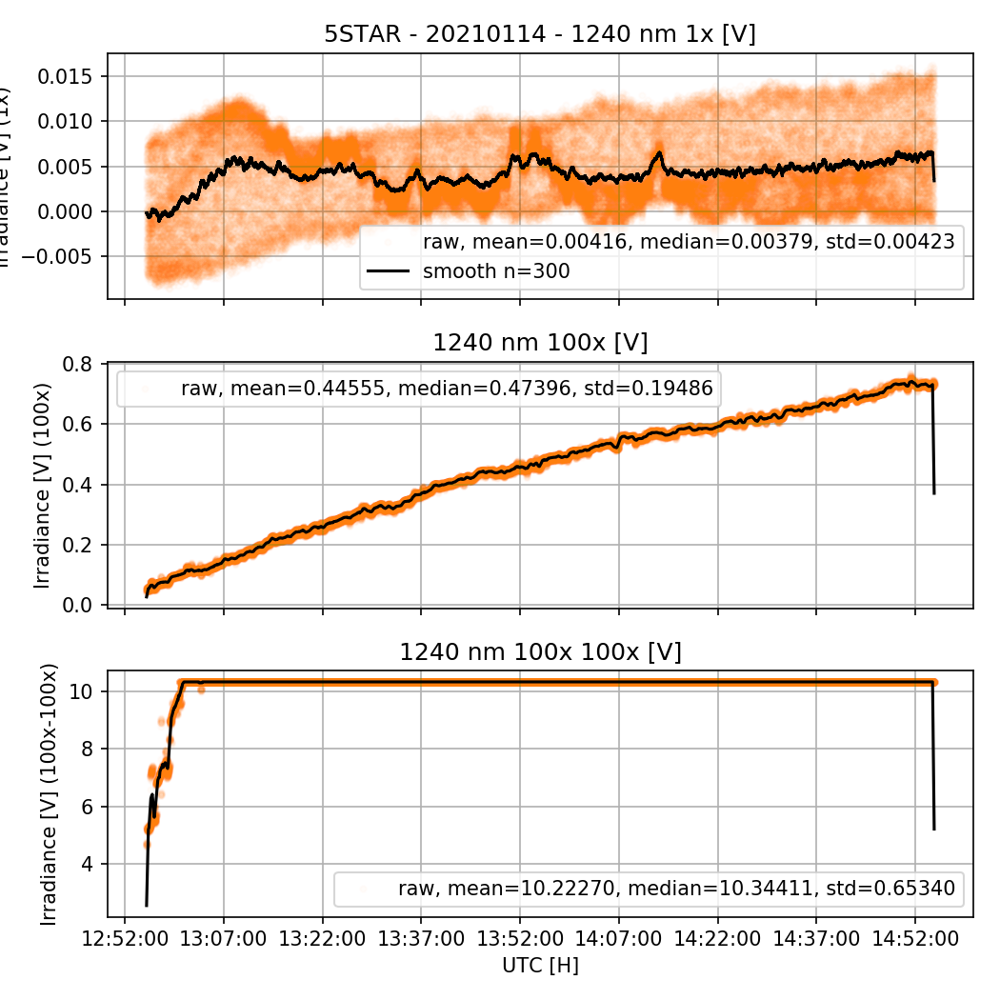

<IPython.core.display.Javascript object>


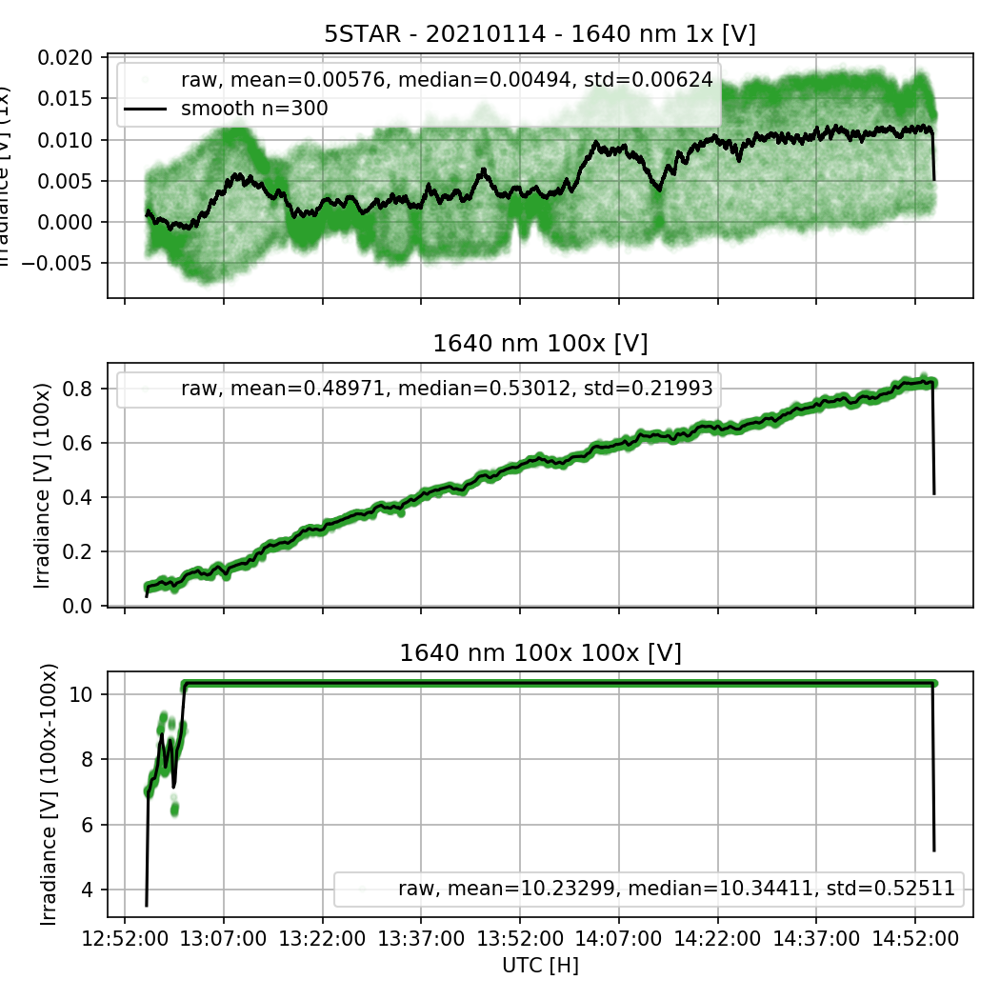

<IPython.core.display.Javascript object>


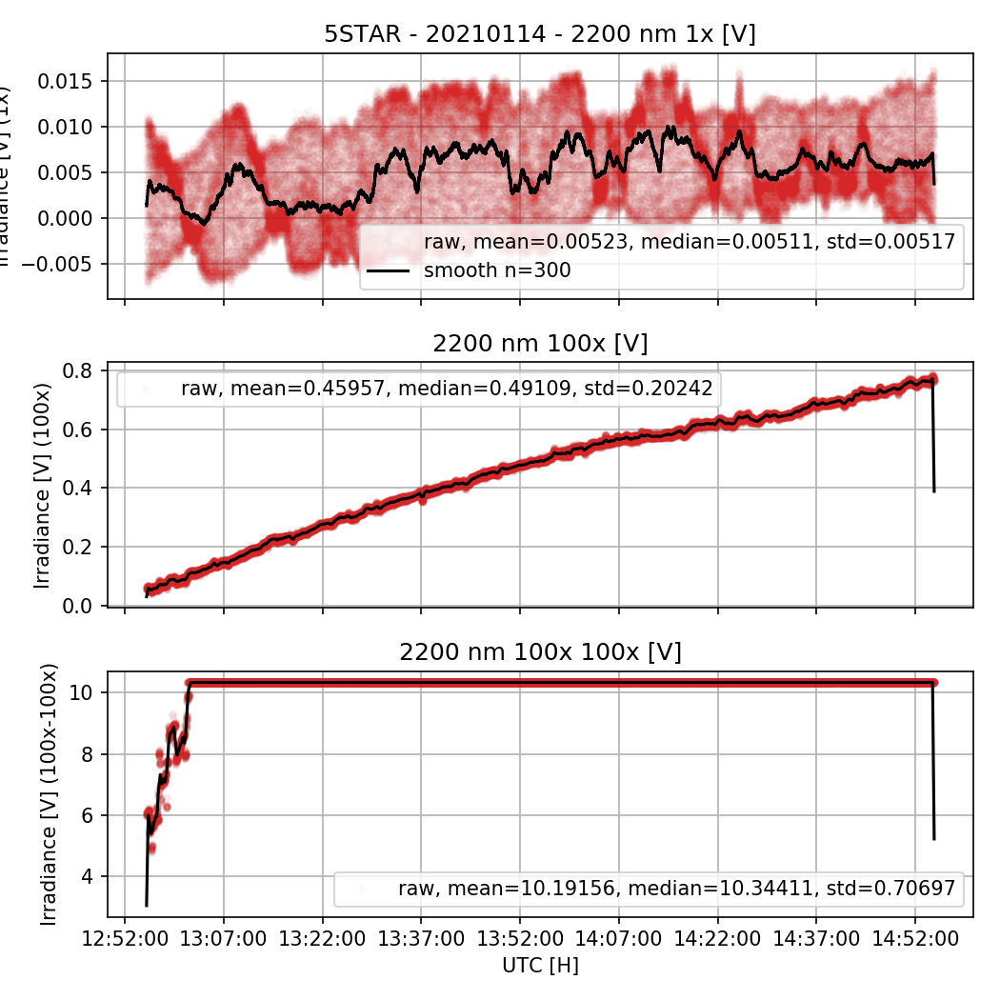

In [227]:
plot_channels(s,fp,dpi=200)